### Preprocessing

In [ ]:
import numpy as np
import librosa
import soundfile as sf
import matplotlib.pyplot as plt
import os

# Define the directory path you want
dir_path = "ML_Data_complex/"

# Create it if it doesn't exist
os.makedirs(dir_path, exist_ok=True)

# Define the directory path you want
dir_path = "Outputs/"

# Create it if it doesn't exist
os.makedirs(dir_path, exist_ok=True)

In [ ]:
global sr
sr = 44100

In [ ]:
# Parameters
mic_file = "Samples/Broken_Cymbal_Random_Pencil_Strikes_Mic_2.wav"
frame_size = 2048
hop_size = 512
pre_onset_sec = 0.015       # 15 ms before onset
decay_sec = 4           # duration of each hit in seconds
output_npz = "ML_Data_complex/strikes_waveforms.npz"

# Load audio
y, sr = librosa.load(mic_file, sr=None)

# Detect onsets
onset_frames = librosa.onset.onset_detect(y=y, sr=sr, hop_length=hop_size)
onset_samples = librosa.frames_to_samples(onset_frames, hop_length=hop_size)

# Convert to samples
pre_onset_samples = int(pre_onset_sec * sr)
decay_samples = int(decay_sec * sr)

# Slice strikes without overlapping next strike
strikes = []
for i in range(len(onset_samples)):
    start = max(onset_samples[i] - pre_onset_samples, 0)

    # End is either the next onset or current onset + decay, whichever is smaller
    next_onset = onset_samples[i+1] if i+1 < len(onset_samples) else len(y)
    end = min(onset_samples[i] + decay_samples, next_onset)

    strikes.append(y[start:end])

# Convert to object array for variable-length strikes
strikes_array = np.array(strikes, dtype=object)

# Save to .npz
np.savez_compressed(output_npz, sample_rate=sr, strikes=strikes_array)

print(f"Saved {len(strikes)} waveform strikes to {output_npz}")


Saved 44 waveform strikes to ML_Data_complex/strikes_waveforms.npz


In [ ]:
def plot_strike_waveform(strike_waveform, sr):
    """
    Plot the waveform of a single strike from the strikes list.

    Parameters:
        strikes: list of np.ndarray
            Each element is a 1D waveform array for one strike.
        strike_idx: int
            Index of the strike to plot.
        sr: int
            Sample rate of the original audio.
    """
    waveform = strike_waveform
    time = np.arange(len(waveform)) / sr

    plt.figure(figsize=(10,5))
    plt.plot(time, waveform, color='steelblue')
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.title(f"Strike Waveform")
    plt.tight_layout()
    plt.show()

def save_strike_wav(strike_waveform, sr, filename):
    """
    Save a single strike waveform to a .wav file.

    Parameters:
        strike_waveform: np.ndarray
            1D array containing the waveform of the strike.
        sr: int
            Sample rate of the audio.
        filename: str
            Output .wav file path.
    """
    # Ensure float32 type
    strike_waveform = strike_waveform.astype(np.float32)

    # Optional: scale slightly to avoid clipping
    max_val = np.max(np.abs(strike_waveform))
    if max_val > 1.0:
        strike_waveform = strike_waveform / max_val * 0.99

    # Write WAV
    sf.write(filename, strike_waveform, sr)
    print(f"Saved strike to {filename}")


In [ ]:
save_strike_wav(strikes_array[0],sr,"Outputs/strike_00.wav")

Saved strike to Outputs/strike_00.wav


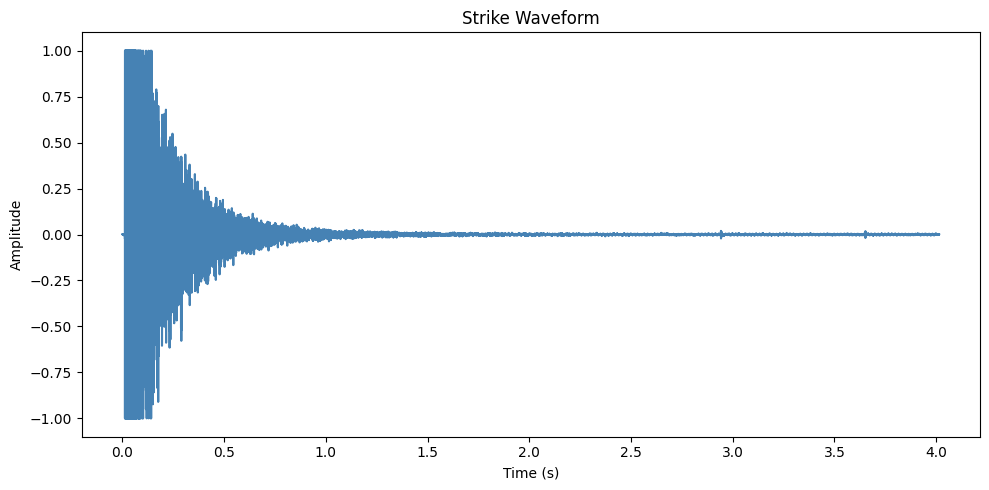

In [ ]:
plot_strike_waveform(strikes_array[0],sr)

### Convert Strikes to STFTs grouped in one array.

In [ ]:
def compute_and_save_strikes_STFT(input_npz, output_npz, n_fft=2048, hop_length=512, window='hann'):
    """
    Load strikes waveform data, compute complex STFTs for each strike, and save to .npz.

    Parameters:
        input_npz: str
            Path to the .npz file containing waveform strikes (key: 'strikes', 'sample_rate').
        output_npz: str
            Path to save the STFTs .npz file.
        n_fft: int
            FFT window size.
        hop_length: int
            Hop length for STFT.
        window: str
            Window type for STFT.
    """
    # Load strikes
    data = np.load(input_npz, allow_pickle=True)
    strikes = data['strikes']
    sr = data['sample_rate'].item()

    # Compute STFTs
    strikes_STFTs = []
    for strike in strikes:
        strike = strike.astype(np.float32)  # Ensure float for librosa
        S = librosa.stft(strike, n_fft=n_fft, hop_length=hop_length, window=window)
        S_complex = np.stack([S.real.T, S.imag.T], axis=-1)  # shape: [frames, n_freq, 2]
        strikes_STFTs.append(S_complex)

    # Convert to object array (variable-length frames)
    strikes_STFTs_array = np.array(strikes_STFTs, dtype=object)

    # Save to .npz
    np.savez_compressed(output_npz,
                        sample_rate=sr,
                        n_fft=n_fft,
                        hop_length=hop_length,
                        strikes_STFTs=strikes_STFTs_array)

    print(f"Saved {len(strikes_STFTs)} STFT strikes to {output_npz}")
    return strikes_STFTs_array

In [ ]:
STFTs = compute_and_save_strikes_STFT("ML_Data_complex/strikes_waveforms.npz", "ML_Data_complex/strikes_STFTs.npz")

Saved 44 STFT strikes to ML_Data_complex/strikes_STFTs.npz


In [ ]:
STFTs[0].shape

(346, 1025, 2)

In [ ]:
def plot_strike_STFT(STFT, sr, log_freq=True, hop_length=512):
    """
    Plot the magnitude spectrogram of a single strike from a .npz of STFTs.

    Parameters:
        stft_npz_file: str
            Path to the .npz file containing STFTs.
        strike_idx: int
            Index of the strike to plot.
        log_freq: bool
            Whether to use a logarithmic frequency axis.
    """

    # Reconstruct complex STFT
    S_complex = np.array(STFT, dtype=np.float32)
    S = S_complex[..., 0] + 1j * S_complex[..., 1]

    # Compute magnitude in dB
    S_db = librosa.amplitude_to_db(np.abs(S).T, ref=np.max)  # transpose for display

    # Plot
    plt.figure(figsize=(10, 4))
    y_axis = 'log' if log_freq else 'linear'
    librosa.display.specshow(S_db, sr=sr, hop_length=hop_length, x_axis='time', y_axis=y_axis)
    plt.colorbar(format='%+2.0f dB')
    plt.title(f"Strike STFT Magnitude")
    plt.tight_layout()
    plt.show()
def reconstruct_STFT_to_wav(stft_complex, sr, hop_length, output_file):
    """
    Reconstruct a waveform from a complex STFT and save as a .wav file.

    Parameters:
        stft_complex: np.ndarray
            Array of shape [num_frames, n_freq, 2] (real + imag stacked)
        sr: int
            Sample rate
        hop_length: int
            Hop length used in the STFT
        output_file: str
            Path to save the reconstructed .wav
    """
    # Reconstruct complex STFT
    S = stft_complex[..., 0] + 1j * stft_complex[..., 1]

    # Transpose back to shape [n_freq, num_frames] for istft
    S = S.T

    # Reconstruct waveform
    y_rec = librosa.istft(S, hop_length=hop_length, window='hann')

    # Ensure float32
    y_rec = y_rec.astype(np.float32)

    # Save to WAV
    sf.write(output_file, y_rec, sr)
    print(f"Reconstructed audio saved to {output_file}")


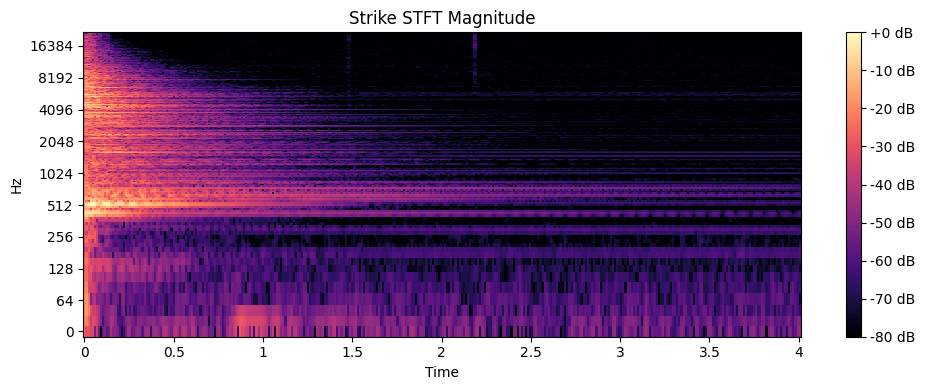

In [ ]:
plot_strike_STFT(STFTs[30],sr)

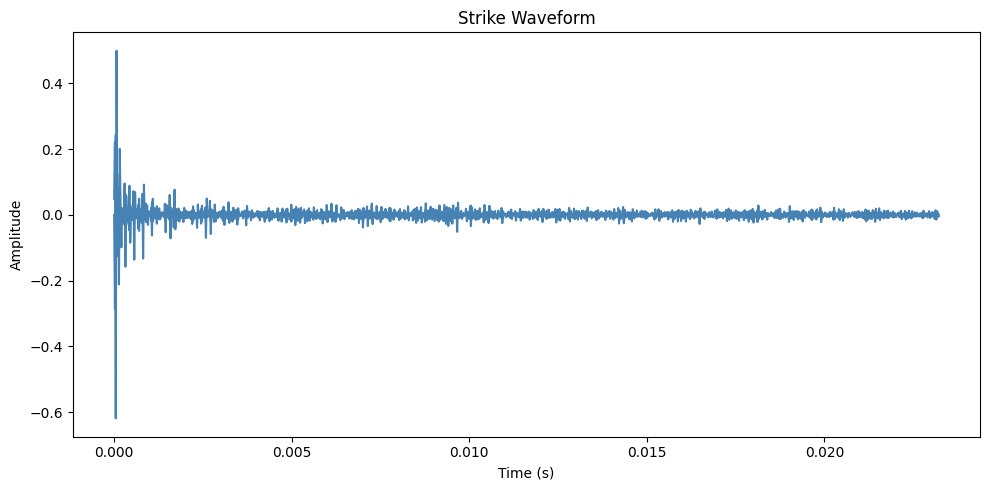

In [ ]:
plot_strike_waveform(STFTs[0][300],sr)

In [ ]:
# Load STFTs
data = np.load("ML_Data_complex/strikes_STFTs.npz", allow_pickle=True)
strikes_STFTs = data['strikes_STFTs']
sr = int(data['sample_rate'].item())
hop_length = int(data['hop_length'].item())

In [ ]:
# Reconstruct and save the first strike
stft_first = np.array(strikes_STFTs[20], dtype=np.float32)
reconstruct_STFT_to_wav(stft_first, sr, hop_length, "strike_20_reconstructed.wav")


Reconstructed audio saved to strike_20_reconstructed.wav


In [ ]:
strikes_STFTs.shape

(44, 346, 1025, 2)

The Original strike and the reconstructed strike sound identical.
Next, we will make the Latent Space Autoencoder

## Latent Space Autoencoder

## First Encoder

In [ ]:
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import librosa
import soundfile as sf
from typing import Tuple, Dict

def learn_strike_latent_space(
    strikes_STFTs,
    sr: int,
    n_fft: int,
    hop_length: int,
    device: str = None,
    max_frames: int = None,
    percentile: float = 95.0,
    latent_dim: int = 128,
    hidden_size: int = 512,
    num_layers: int = 2,
    batch_size: int = 8,
    epochs: int = 50,
    lr: float = 1e-3,
    normalize: bool = True,
    verbose: bool = True
) -> Dict:
    """
    Train a strike-level sequence autoencoder on the provided strikes_STFTs object.

    Parameters
    ----------
    strikes_STFTs : array-like
        Object array or list where each element is one strike's STFT.
        Typical shape per element (as produced earlier): [frames, n_freq, 2]
        (real+imag in last axis), but function is robust to variants.
    sr : int
        Sample rate for later waveform reconstruction.
    n_fft : int
        FFT size used to compute the STFT (used to calculate n_freq_bins).
    hop_length : int
        Hop length used for STFT / inverse STFT.
    device : str or None
        'cpu' or 'cuda', None -> auto-detect.
    max_frames : int or None
        If None: compute from percentile of strike lengths (see `percentile`).
        If provided: truncates/pads to this length.
    percentile : float
        If max_frames is None, use this percentile of strike lengths to decide the fixed length.
    latent_dim, hidden_size, num_layers, batch_size, epochs, lr : training/model params
    normalize : bool
        Normalize features (zero mean / unit std) across dataset (per-feature).
    verbose : bool
        Print progress.

    Returns
    -------
    dict
        {
            'model': trained PyTorch model,
            'device': device,
            'mean': feature mean (or None),
            'std': feature std (or None),
            'max_frames': max_frames,
            'n_freq_bins': n_freq_bins,
            'hop_length': hop_length,
            'sr': sr,
            'encode_fn': function to encode numpy strike -> latent (callable),
            'decode_fn': function to decode latent -> numpy STFT (frames,n_freq,2),
            'reconstruct_waveform_fn': function to decode latent -> waveform (numpy array)
        }
    """

    # Device
    if device is None:
        device = "cuda" if torch.cuda.is_available() else "cpu"

    n_freq_bins = n_fft // 2 + 1

    # --- 1) Inspect & normalize orientation; produce list of arrays shaped (frames, n_freq, 2) ---
    strikes_frames = []
    frames_list = []
    for S in strikes_STFTs:
        S_arr = np.array(S)  # object -> array
        # If stored as complex 2D (n_freq, frames)
        if S_arr.ndim == 2 and np.iscomplexobj(S_arr):
            # convert to frames x n_freq x 2
            S_f = np.stack([S_arr.T.real, S_arr.T.imag], axis=-1)  # (frames, n_freq, 2)
        elif S_arr.ndim == 3 and S_arr.shape[2] == 2:
            # Could be (frames, n_freq, 2) OR (n_freq, frames, 2)
            if S_arr.shape[1] == n_freq_bins:
                # likely (frames, n_freq, 2)
                S_f = S_arr
            elif S_arr.shape[0] == n_freq_bins:
                # (n_freq, frames, 2) -> transpose to (frames, n_freq, 2)
                S_f = S_arr.transpose(1, 0, 2)
            else:
                # best-effort: try to find axis equal to n_freq_bins
                axes = list(S_arr.shape)
                if n_freq_bins in axes:
                    idx = axes.index(n_freq_bins)
                    # move that axis to position 1 (freq axis), frames will be other axis
                    S_f = np.moveaxis(S_arr, idx, 1)
                    # Now S_f shape should be (something, n_freq_bins, 2)
                else:
                    # fallback: assume first axis=frames, second=freq
                    S_f = S_arr
        else:
            raise ValueError("Unsupported STFT element shape. Each strike must be complex 2D or real+imag 3D.")

        if S_f.ndim != 3 or S_f.shape[1] != n_freq_bins or S_f.shape[2] != 2:
            raise ValueError(f"After normalization each strike must be (frames, n_freq, 2). Got shape {S_f.shape}")

        strikes_frames.append(S_f.astype(np.float32))
        frames_list.append(S_f.shape[0])

    frames_list = np.array(frames_list)

    # --- 2) Choose fixed sequence length max_frames ---
    if max_frames is None:
        # use percentile, but limit to at least min length
        chosen = int(np.percentile(frames_list, percentile))
        max_frames = max(8, chosen)  # at least 8 frames
        if verbose:
            print(f"[info] chosen max_frames (percentile={percentile}): {max_frames}")

    # Features per frame = real + imag concatenated across freq
    n_features = n_freq_bins * 2

    # --- 3) Build dataset: each strike -> sequence (max_frames x n_features) ---
    processed = []
    for S_f in strikes_frames:
        # S_f: (frames, n_freq, 2)
        real = S_f[..., 0]     # (frames, n_freq)
        imag = S_f[..., 1]     # (frames, n_freq)
        feat = np.concatenate([real, imag], axis=1)  # (frames, n_freq*2)
        # pad or truncate
        if feat.shape[0] < max_frames:
            pad = max_frames - feat.shape[0]
            feat = np.pad(feat, ((0, pad), (0, 0)), mode='constant')
        else:
            feat = feat[:max_frames]
        processed.append(feat)

    X = np.stack(processed).astype(np.float32)  # shape: (N_strikes, max_frames, n_features)

    # --- 4) Optional normalization (per-feature) ---
    mean, std = None, None
    if normalize:
        flattened = X.reshape(-1, n_features)
        mean = flattened.mean(axis=0, keepdims=True)
        std = flattened.std(axis=0, keepdims=True)
        std[std == 0.0] = 1.0
        X = (X - mean) / std

    # Convert to torch
    X_tensor = torch.from_numpy(X)  # dtype float32
    dataset = TensorDataset(X_tensor)
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=True, drop_last=False)

    # --- 5) Model definition ---
    class StrikeSeqAutoencoder(nn.Module):
        def __init__(self, input_size, hidden_size, latent_dim, num_layers):
            super().__init__()
            self.encoder_rnn = nn.GRU(input_size=input_size, hidden_size=hidden_size,
                                      num_layers=num_layers, batch_first=True)
            self.latent_fc = nn.Linear(hidden_size, latent_dim)
            # map latent to initial hidden state for decoder (num_layers * hidden_size)
            self.latent_to_hidden = nn.Linear(latent_dim, hidden_size * num_layers)
            self.decoder_rnn = nn.GRU(input_size=input_size, hidden_size=hidden_size,
                                      num_layers=num_layers, batch_first=True)
            self.out_fc = nn.Linear(hidden_size, input_size)

        def forward(self, x):
            # x: [B, T, input_size]
            _, h_n = self.encoder_rnn(x)                # h_n: [num_layers, B, hidden_size]
            h_last = h_n[-1]                            # [B, hidden_size]
            z = self.latent_fc(h_last)                  # [B, latent_dim]

            # prepare decoder initial hidden from latent
            dec_h = self.latent_to_hidden(z)            # [B, num_layers*hidden_size]
            # reshape to (num_layers, B, hidden_size)
            dec_h = dec_h.view(self.decoder_rnn.num_layers, x.size(0), self.decoder_rnn.hidden_size).contiguous()

            # decoder inputs: zeros (B, T, input_size)
            dec_input = torch.zeros(x.size(0), x.size(1), x.size(2), device=x.device, dtype=x.dtype)
            dec_out, _ = self.decoder_rnn(dec_input, dec_h)   # [B, T, hidden_size]
            x_rec = self.out_fc(dec_out)                      # [B, T, input_size]
            return x_rec, z

        def encode(self, x):
            """x: tensor [B, T, input_size] -> returns z [B, latent_dim]"""
            with torch.no_grad():
                _, h_n = self.encoder_rnn(x)
                h_last = h_n[-1]
                return self.latent_fc(h_last)

        def decode(self, z, seq_len):
            """z: [B, latent_dim] -> returns x_rec [B, seq_len, input_size]"""
            with torch.no_grad():
                dec_h = self.latent_to_hidden(z)
                dec_h = dec_h.view(self.decoder_rnn.num_layers, z.size(0), self.decoder_rnn.hidden_size)
                dec_input = torch.zeros(z.size(0), seq_len, n_features, device=z.device, dtype=z.dtype)
                dec_out, _ = self.decoder_rnn(dec_input, dec_h)
                x_rec = self.out_fc(dec_out)
                return x_rec

    model = StrikeSeqAutoencoder(input_size=n_features, hidden_size=hidden_size,
                                 latent_dim=latent_dim, num_layers=num_layers).to(device)

    # --- 6) Training loop ---
    optimizer = optim.Adam(model.parameters(), lr=lr)
    criterion = nn.MSELoss()

    model.train()
    for epoch in range(epochs):
        epoch_loss = 0.0
        for (batch_x,) in loader:
            batch_x = batch_x.to(device)
            x_rec, _ = model(batch_x)
            loss = criterion(x_rec, batch_x)
            optimizer.zero_grad()
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
            optimizer.step()
            epoch_loss += float(loss.item()) * batch_x.size(0)
        epoch_loss /= len(dataset)
        if verbose:
            print(f"Epoch {epoch+1}/{epochs}  loss={epoch_loss:.6f}")

    # --- 7) Helpers to encode/decode and reconstruct waveform ---
    def encode_numpy_strike(S_np: np.ndarray) -> np.ndarray:
        """
        Input: raw strike STFT (various possible shapes)
        Output: latent vector (numpy)
        """
        # Normalize & preprocess single strike similarly as above
        S_s = np.array(S_np)
        # Normalize orientation to frames x n_freq x 2
        if S_s.ndim == 2 and np.iscomplexobj(S_s):
            Sf = np.stack([S_s.T.real, S_s.T.imag], axis=-1)
        elif S_s.ndim == 3 and S_s.shape[2] == 2:
            if S_s.shape[1] == n_freq_bins:
                Sf = S_s
            elif S_s.shape[0] == n_freq_bins:
                Sf = S_s.transpose(1,0,2)
            else:
                Sf = S_s
        else:
            raise ValueError("Unsupported strike shape for encoding.")

        real = Sf[..., 0]; imag = Sf[..., 1]
        feat = np.concatenate([real, imag], axis=1)
        # pad/truncate
        if feat.shape[0] < max_frames:
            feat = np.pad(feat, ((0, max_frames - feat.shape[0]), (0, 0)), mode='constant')
        else:
            feat = feat[:max_frames]
        # normalize
        if normalize:
            feat = (feat - mean) / std
        x_t = torch.from_numpy(feat[None, ...]).to(device)
        model.eval()
        with torch.no_grad():
            z = model.encode(x_t)
        return z.cpu().numpy()

    def decode_latent_to_STFT(z_np: np.ndarray) -> np.ndarray:
        """
        Input: latent vector numpy [latent_dim] or [B, latent_dim]
        Output: STFT array shape (frames, n_freq, 2) in real+imag form (unpadded length = max_frames)
        """
        model.eval()
        z_t = torch.from_numpy(z_np).to(device).float()
        if z_t.dim() == 1:
            z_t = z_t.unsqueeze(0)
        with torch.no_grad():
            x_rec = model.decode(z_t, seq_len=max_frames)  # [B, T, n_features]
        x_rec = x_rec.cpu().numpy()
        # de-normalize
        if normalize:
            x_rec = x_rec * std + mean
        # Convert to real+imag per frame: frames x n_freq x 2
        real = x_rec[..., :n_freq_bins]
        imag = x_rec[..., n_freq_bins:]
        S_out = np.stack([real, imag], axis=-1)  # [B, T, n_freq, 2]? Wait shapes: x_rec [B,T,2*n_freq] so real shape [B,T,n_freq]
        # We want to return [frames, n_freq, 2] for the first element
        S_out = S_out[0]  # shape (T, n_freq, 2)
        # For compatibility with previous code which used frames x n_freq x 2 or sometimes n_freq x frames x 2,
        # return S_out as (frames, n_freq, 2)
        return S_out

    def decode_latent_to_waveform(z_np: np.ndarray, output_path: str = None) -> np.ndarray:
        """
        Convert latent vector(s) to an audio waveform using inverse STFT and return waveform (np.ndarray).
        If output_path is provided, it will save the .wav file there.
        """
        S_out = decode_latent_to_STFT(z_np)  # frames x n_freq x 2
        # reconstruct complex STFT as shape (n_freq, frames)
        real = S_out[..., 0]
        imag = S_out[..., 1]
        S_complex = real + 1j * imag
        S_complex = S_complex.T  # (n_freq, frames)
        y_rec = librosa.istft(S_complex, hop_length=hop_length, window='hann')
        if output_path:
            sf.write(output_path, y_rec, sr)
        return y_rec

    # return dictionary with trained model and helpers
    model_info = {
        'model': model,
        'device': device,
        'mean': mean,
        'std': std,
        'max_frames': max_frames,
        'n_freq_bins': n_freq_bins,
        'hop_length': hop_length,
        'sr': sr,
        'encode_fn': encode_numpy_strike,
        'decode_fn': decode_latent_to_STFT,
        'reconstruct_waveform_fn': decode_latent_to_waveform
    }

    return model_info


## Second Encoder

In [ ]:
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import librosa
import soundfile as sf
from typing import Dict

def learn_strike_latent_space_conv_2D(
    strikes_STFTs,
    sr: int,
    n_fft: int,
    hop_length: int,
    device: str = None,
    max_frames: int = None,
    percentile: float = 95.0,
    latent_dim: int = 128,
    hidden_size: int = 512,   # kept for signature parity; not used by CNN version
    num_layers: int = 2,      # kept for signature parity; not used by CNN version
    batch_size: int = 8,
    epochs: int = 50,
    lr: float = 1e-3,
    normalize: bool = True,
    verbose: bool = True
) -> Dict:
    """
    Train a strike-level *convolutional* autoencoder on the provided strikes_STFTs object.

    Input per strike is expected to be (frames, n_freq, 2) where the last dim is [real, imag].
    Model learns to reconstruct real/imag, with an auxiliary loss on log-magnitude.
    """

    # ---------- Device ----------
    if device is None:
        device = "cuda" if torch.cuda.is_available() else "cpu"

    n_freq_bins = n_fft // 2 + 1

    # ---------- 1) Normalize orientation; list of (T, F, 2) ----------
    strikes_frames = []
    frames_list = []
    for S in strikes_STFTs:
        S_arr = np.array(S)
        # If complex 2D (F, T), convert to (T, F, 2)
        if S_arr.ndim == 2 and np.iscomplexobj(S_arr):
            S_f = np.stack([S_arr.T.real, S_arr.T.imag], axis=-1)
        elif S_arr.ndim == 3 and S_arr.shape[-1] == 2:
            # Could be (T, F, 2) or (F, T, 2)
            if S_arr.shape[1] == n_freq_bins:           # (T, F, 2)
                S_f = S_arr
            elif S_arr.shape[0] == n_freq_bins:         # (F, T, 2) -> (T, F, 2)
                S_f = S_arr.transpose(1, 0, 2)
            else:
                # Best effort: move the axis equal to n_freq_bins into position 1
                axes = list(S_arr.shape)
                if n_freq_bins in axes:
                    idx = axes.index(n_freq_bins)
                    S_f = np.moveaxis(S_arr, idx, 1)
                else:
                    S_f = S_arr
        else:
            raise ValueError("Unsupported STFT element shape. Each strike must be complex 2D or real+imag 3D.")

        if S_f.ndim != 3 or S_f.shape[1] != n_freq_bins or S_f.shape[2] != 2:
            raise ValueError(f"After normalization each strike must be (frames, n_freq, 2). Got {S_f.shape}")

        S_f = S_f.astype(np.float32)
        strikes_frames.append(S_f)
        frames_list.append(S_f.shape[0])

    frames_list = np.array(frames_list)

    # ---------- 2) Choose max_frames and make it divisible by 8 ----------
    if max_frames is None:
        chosen = int(np.percentile(frames_list, percentile))
        max_frames = max(8, chosen)
    # make divisible by 8 for smooth strided conv/transpose
    if max_frames % 8 != 0:
        max_frames = max_frames + (8 - (max_frames % 8))
    if verbose:
        print(f"[info] chosen max_frames (rounded to /8): {max_frames}")

    # ---------- 3) Build dataset tensor X: [N, 2, T, F] ----------
    processed = []
    for S_f in strikes_frames:
        T = S_f.shape[0]
        # pad/truncate time
        if T < max_frames:
            pad = max_frames - T
            S_f = np.pad(S_f, ((0, pad), (0, 0), (0, 0)), mode='constant')
        else:
            S_f = S_f[:max_frames]
        # re-order to [C, T, F] where C=2 (real, imag)
        S_cf = np.stack([S_f[..., 0], S_f[..., 1]], axis=0)  # [2, T, F]
        processed.append(S_cf)

    X = np.stack(processed).astype(np.float32)  # [N, 2, T, F]

    # ---------- 4) Optional normalization (per-channel global z-score) ----------
    mean, std = None, None
    if normalize:
        # compute stats across (N,T,F) per channel
        mean = X.mean(axis=(0, 2, 3), keepdims=True)  # [1, 2, 1, 1]
        std = X.std(axis=(0, 2, 3), keepdims=True)
        std[std == 0.0] = 1.0
        X = (X - mean) / std

    X_tensor = torch.from_numpy(X)  # [N, 2, T, F]
    dataset = TensorDataset(X_tensor)
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=True, drop_last=False)

    # ---------- 5) CNN Autoencoder ----------
    # Encoder: 2 -> 32 -> 64 -> 128 channels with stride on (T,F)
    class ConvAE(nn.Module):
        def __init__(self, latent_dim, n_freq_bins, T):
            super().__init__()
            # (B, 2, T, F)
            self.enc = nn.Sequential(
                nn.Conv2d(2, 32, kernel_size=3, stride=2, padding=1),   # (T/2, F/2)
                nn.BatchNorm2d(32), nn.LeakyReLU(0.1, inplace=True),
                nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1),  # (T/4, F/4)
                nn.BatchNorm2d(64), nn.LeakyReLU(0.1, inplace=True),
                nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1), # (T/8, F/8)
                nn.BatchNorm2d(128), nn.LeakyReLU(0.1, inplace=True),
            )
            t8, f8 = T // 8, n_freq_bins // 8
            self.t8, self.f8 = t8, f8
            enc_flat = 128 * t8 * f8
            self.to_latent = nn.Linear(enc_flat, latent_dim)

            # Decoder
            self.from_latent = nn.Linear(latent_dim, enc_flat)
            self.dec = nn.Sequential(
                nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),  # (T/4, F/4)
                nn.BatchNorm2d(64), nn.LeakyReLU(0.1, inplace=True),
                nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),   # (T/2, F/2)
                nn.BatchNorm2d(32), nn.LeakyReLU(0.1, inplace=True),
                nn.ConvTranspose2d(32, 2, kernel_size=4, stride=2, padding=1),    # (T, F), 2 channels (real, imag)
            )

        def encode(self, x):  # x: [B,2,T,F]
            h = self.enc(x)
            h = h.view(x.size(0), -1)
            z = self.to_latent(h)
            return z

        def decode(self, z):  # z: [B,latent]
            h = self.from_latent(z)
            h = h.view(z.size(0), 128, self.t8, self.f8)
            x_rec = self.dec(h)  # [B,2,T,F]
            return x_rec

        def forward(self, x):
            z = self.encode(x)
            x_rec = self.decode(z)
            return x_rec, z

    # ensure F divisible by 8 (n_freq_bins usually 1025 -> pad freq by 1..7 if needed)
    freq_pad = (8 - (n_freq_bins % 8)) % 8
    if freq_pad:
        # pad frequency to make divisible by 8
        X_tensor = torch.nn.functional.pad(X_tensor, (0, freq_pad, 0, 0, 0, 0, 0, 0))  # pad last dim
        n_freq_eff = n_freq_bins + freq_pad
    else:
        n_freq_eff = n_freq_bins

    model = ConvAE(latent_dim=latent_dim, n_freq_bins=n_freq_eff, T=max_frames).to(device)

    # ---------- 6) Loss: α*MSE(real/imag) + β*MSE(log-mag) ----------
    alpha = 1.0
    beta = 0.5

    def log_mag(ch2):  # ch2: [B,2,T,F] -> [B,1,T,F] log-magnitude
        real = ch2[:, 0]
        imag = ch2[:, 1]
        mag = torch.sqrt(torch.clamp(real**2 + imag**2, min=1e-10))
        return torch.log1p(mag).unsqueeze(1)

    optimizer = optim.Adam(model.parameters(), lr=lr)
    model.train()
    for epoch in range(epochs):
        epoch_loss = 0.0
        for (batch_x,) in loader:
            batch_x = batch_x.to(device)  # [B,2,T,F] (already normalized if requested)

            # If we padded F to n_freq_eff, ensure runtime pad matches
            if batch_x.shape[-1] != n_freq_eff:
                pad_f = n_freq_eff - batch_x.shape[-1]
                batch_x = torch.nn.functional.pad(batch_x, (0, pad_f, 0, 0))

            x_rec, _ = model(batch_x)

            # primary complex-domain MSE
            loss_complex = nn.functional.mse_loss(x_rec, batch_x)

            # auxiliary log-magnitude MSE
            loss_logmag = nn.functional.mse_loss(log_mag(x_rec), log_mag(batch_x))

            loss = alpha * loss_complex + beta * loss_logmag

            optimizer.zero_grad()
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
            optimizer.step()

            epoch_loss += float(loss.item()) * batch_x.size(0)

        epoch_loss /= len(dataset)
        if verbose:
            print(f"Epoch {epoch+1}/{epochs}  loss={epoch_loss:.6f}")

    # ---------- 7) Helpers ----------
    # Save mean/std (broadcastable to [N,2,T,F])
    mean_np = None if not normalize else mean.astype(np.float32)
    std_np  = None if not normalize else std.astype(np.float32)

    def _prep_single_strike(S_np: np.ndarray) -> torch.Tensor:
        """(frames, n_freq, 2) -> torch [1,2,T,F_eff], normalized, padded to max_frames/F_eff"""
        S_np = np.array(S_np)
        if S_np.ndim == 2 and np.iscomplexobj(S_np):
            S_np = np.stack([S_np.T.real, S_np.T.imag], axis=-1)  # (T,F,2)
        elif S_np.ndim == 3 and S_np.shape[-1] == 2:
            if S_np.shape[1] == n_freq_bins:
                pass
            elif S_np.shape[0] == n_freq_bins:
                S_np = S_np.transpose(1, 0, 2)
        else:
            raise ValueError("Unsupported strike shape for encoding/decoding.")

        # time pad/trunc
        if S_np.shape[0] < max_frames:
            S_np = np.pad(S_np, ((0, max_frames - S_np.shape[0]), (0, 0), (0, 0)), mode='constant')
        else:
            S_np = S_np[:max_frames]

        # freq pad (right side) if needed
        if freq_pad:
            S_np = np.pad(S_np, ((0, 0), (0, freq_pad), (0, 0)), mode='constant')

        # [2,T,F]
        S_cf = np.stack([S_np[..., 0], S_np[..., 1]], axis=0).astype(np.float32)
        # normalize
        if normalize:
          ch_mean = mean_np.reshape(1, 2, 1, 1)  # [1,2,1,1]
          ch_std  = std_np.reshape(1, 2, 1, 1)
          S_cf = (S_cf[None, ...] - ch_mean) / (ch_std + 1e-8)  # -> [1,2,T,F]
          S_cf = S_cf[0]  # back to [2,T,F]
              # [1,2,T,F]
        return torch.from_numpy(S_cf[None, ...]).to(device)

    model.eval()

    def encode_numpy_strike(S_np: np.ndarray) -> np.ndarray:
        with torch.no_grad():
            x = _prep_single_strike(S_np)
            z = model.encode(x)
            return z.cpu().numpy()

    def decode_latent_to_STFT(z_np: np.ndarray) -> np.ndarray:
        with torch.no_grad():
            z_t = torch.from_numpy(z_np.astype(np.float32))
            if z_t.dim() == 1:
                z_t = z_t.unsqueeze(0)
            z_t = z_t.to(device)
            x_rec = model.decode(z_t)  # [B,2,T,F_eff]
            x_rec = x_rec.cpu().numpy()[0]  # [2,T,F_eff]
        # de-normalize
        if normalize:
            x_rec = x_rec * (std_np.squeeze()) + (mean_np.squeeze())
        # remove freq pad
        if freq_pad:
            x_rec = x_rec[:, :, :n_freq_bins]
        # [T,F,2]
        real = x_rec[0].T.T  # keep shape [T,F]
        imag = x_rec[1].T.T
        S_out = np.stack([x_rec[0].transpose(1,0), x_rec[1].transpose(1,0)], axis=-1)  # (F?,T?) careful…

        # x_rec is [2,T,F]. We want (T,F,2):
        S_out = np.stack([x_rec[0], x_rec[1]], axis=-1).transpose(1, 2, 0)  # (T,F,2)
        return S_out.astype(np.float32)

    def decode_latent_to_waveform(z_np: np.ndarray, output_path: str = None) -> np.ndarray:
        S_out = decode_latent_to_STFT(z_np)  # (T,F,2)
        real = S_out[..., 0]
        imag = S_out[..., 1]
        S_complex = (real + 1j * imag).T  # (F,T)
        y_rec = librosa.istft(S_complex, hop_length=hop_length, window='hann')
        if output_path:
            sf.write(output_path, y_rec, sr)
        return y_rec

    return {
        'model': model,
        'device': device,
        'mean': None if not normalize else mean_np,
        'std': None if not normalize else std_np,
        'max_frames': max_frames,
        'n_freq_bins': n_freq_bins,
        'hop_length': hop_length,
        'sr': sr,
        'encode_fn': encode_numpy_strike,
        'decode_fn': decode_latent_to_STFT,
        'reconstruct_waveform_fn': decode_latent_to_waveform
    }


In [ ]:
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import librosa
import soundfile as sf
from typing import Dict

def learn_strike_latent_space_conv_2D(
    strikes_STFTs,
    sr: int,
    n_fft: int,
    hop_length: int,
    device: str = None,
    max_frames: int = None,
    percentile: float = 95.0,
    latent_dim: int = 128,
    hidden_size: int = 512,   # kept for signature parity; not used by CNN version
    num_layers: int = 2,      # kept for signature parity; not used by CNN version
    batch_size: int = 8,
    epochs: int = 50,
    lr: float = 1e-3,
    normalize: bool = True,
    verbose: bool = True
) -> Dict:
    """
    Train a strike-level 2D-convolutional autoencoder on strike STFTs.

    Each strike element can be:
      - complex STFT of shape (F, T)  OR
      - real+imag array of shape (T, F, 2) or (F, T, 2)

    Internally we use tensors shaped [B, 2, T, F] = [batch, channels(real/imag), time, freq].
    The model reconstructs complex STFT (real+imag) and uses an auxiliary log-magnitude loss.
    """

    # ---------- Device ----------
    if device is None:
        device = "cuda" if torch.cuda.is_available() else "cpu"

    n_freq_bins = n_fft // 2 + 1

    win = torch.hann_window(n_fft, periodic=True, device=device)


    # ---------- 1) Normalize orientation; list of (T, F, 2) ----------
    strikes_frames = []
    frames_list = []
    for S in strikes_STFTs:
        S_arr = np.array(S)
        if S_arr.ndim == 2 and np.iscomplexobj(S_arr):              # (F, T) complex
            S_f = np.stack([S_arr.T.real, S_arr.T.imag], axis=-1)   # -> (T, F, 2)
        elif S_arr.ndim == 3 and S_arr.shape[-1] == 2:
            if S_arr.shape == (n_freq_bins, S_arr.shape[1], 2):     # (F, T, 2)
                S_f = S_arr.transpose(1, 0, 2)                      # -> (T, F, 2)
            elif S_arr.shape[1] == n_freq_bins:                     # (T, F, 2)
                S_f = S_arr
            else:
                # Best effort: move axis equal to n_freq_bins into position 1 (freq)
                axes = list(S_arr.shape)
                if n_freq_bins in axes:
                    idx = axes.index(n_freq_bins)
                    S_f = np.moveaxis(S_arr, idx, 1)
                else:
                    S_f = S_arr
        else:
            raise ValueError("Unsupported STFT element shape. Each strike must be complex 2D or real+imag 3D.")

        if S_f.ndim != 3 or S_f.shape[1] != n_freq_bins or S_f.shape[2] != 2:
            raise ValueError(f"After normalization each strike must be (T, F, 2). Got {S_f.shape}")

        S_f = S_f.astype(np.float32)
        strikes_frames.append(S_f)
        frames_list.append(S_f.shape[0])


    frames_list = np.array(frames_list)

    # ---------- 2) Choose max_frames (rounded to /8 for clean up/down-sampling) ----------
    if max_frames is None:
        chosen = int(np.percentile(frames_list, percentile))
        max_frames = max(8, chosen)
    if max_frames % 8 != 0:
        max_frames += (8 - (max_frames % 8))
    if verbose:
        print(f"[info] chosen max_frames (rounded to /8): {max_frames}")

    # ---------- Make frequency divisible by 8 (pad-right if needed) ----------
    freq_pad = (8 - (n_freq_bins % 8)) % 8
    n_freq_eff = n_freq_bins + freq_pad

    # ---------- 3) Build dataset X (numpy) as [N, 2, T, F_eff] ----------
    processed = []
    for S_f in strikes_frames:
        T = S_f.shape[0]
        # time pad/trunc to max_frames
        if T < max_frames:
            S_f = np.pad(S_f, ((0, max_frames - T), (0, 0), (0, 0)), mode='constant')
        else:
            S_f = S_f[:max_frames]

        # freq pad-right to n_freq_eff
        if freq_pad:
            S_f = np.pad(S_f, ((0, 0), (0, freq_pad), (0, 0)), mode='constant')

        # to [2, T, F]
        S_cf = np.stack([S_f[..., 0], S_f[..., 1]], axis=0)
        processed.append(S_cf)

    X = np.stack(processed).astype(np.float32)  # [N, 2, T, F_eff]

    # ---------- 4) Optional per-channel global z-score ----------
    mean_np, std_np = None, None
    if normalize:
        # mean/std over (N, T, F) per channel -> shape [1,2,1,1] for broadcast
        mean_np = X.mean(axis=(0, 2, 3), keepdims=True).astype(np.float32)  # [1,2,1,1]
        std_np  = X.std(axis=(0, 2, 3), keepdims=True).astype(np.float32)
        std_np[std_np == 0.0] = 1.0
        X = (X - mean_np) / (std_np + 1e-8)

    # ---------- 5) TensorDataset / DataLoader ----------
    X_tensor = torch.from_numpy(X)             # [N,2,T,F_eff]
    dataset  = TensorDataset(X_tensor)
    loader   = DataLoader(dataset, batch_size=batch_size, shuffle=True, drop_last=False)

    # ---------- 6) CNN Autoencoder ----------
    class ConvAE(nn.Module):
        def __init__(self, latent_dim, T, F_eff):
            super().__init__()
            self.enc = nn.Sequential(
                nn.Conv2d(2, 32, kernel_size=3, stride=2, padding=1),   # -> (T/2, F/2)
                nn.BatchNorm2d(32), nn.LeakyReLU(0.1, inplace=True),
                nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1),  # -> (T/4, F/4)
                nn.BatchNorm2d(64), nn.LeakyReLU(0.1, inplace=True),
                nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1), # -> (T/8, F/8)
                nn.BatchNorm2d(128), nn.LeakyReLU(0.1, inplace=True),
            )
            self.t8, self.f8 = T // 8, F_eff // 8
            flat = 128 * self.t8 * self.f8
            self.to_latent   = nn.Linear(flat, latent_dim)
            self.from_latent = nn.Linear(latent_dim, flat)
            self.dec = nn.Sequential(
                nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),  # -> (T/4, F/4)
                nn.BatchNorm2d(64), nn.LeakyReLU(0.1, inplace=True),
                nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),   # -> (T/2, F/2)
                nn.BatchNorm2d(32), nn.LeakyReLU(0.1, inplace=True),
                nn.ConvTranspose2d(32, 2,  kernel_size=4, stride=2, padding=1),   # -> (T, F)
            )

        def encode(self, x):  # x: [B,2,T,F]
            h = self.enc(x)
            h = torch.flatten(h, 1)
            return self.to_latent(h)

        def decode(self, z):  # z: [B, latent]
            h = self.from_latent(z)
            h = h.view(z.size(0), 128, self.t8, self.f8)
            return self.dec(h)  # [B,2,T,F]

        def forward(self, x):
            z = self.encode(x)
            x_rec = self.decode(z)
            return x_rec, z

    model = ConvAE(latent_dim=latent_dim, T=max_frames, F_eff=n_freq_eff).to(device)

    # ---------- 7) Loss: α*MSE(real/imag) + β*MSE(log-mag) + γ*ISTFT-STFT Consistency ----------
    alpha, beta, gamma = 1.0, 1.0, 0.5 # Increased beta to 1.0

    # Utility function to convert [B,2,T,F] to complex [B,F,T]
    def ch2_to_complex(x_ch):  # [B,2,T,F] -> complex [B,F,T]
        # move channels to last, then view as complex
        x_last = x_ch.permute(0, 2, 3, 1).contiguous()      # [B,T,F,2]
        x_c = torch.view_as_complex(x_last)                  # [B,T,F] complex
        return x_c.permute(0, 2, 1).contiguous()            # [B,F,T]

    # Utility function to convert complex [B,F,T] to [B,2,T,F]
    def complex_to_ch2(x_c):   # complex [B,F,T] -> [B,2,T,F]
        x_last = torch.view_as_real(x_c).permute(0, 2, 1, 3).contiguous()  # [B,T,F,2]
        return x_last.permute(0, 3, 1, 2).contiguous()                     # [B,2,T,F]


    # Utility function to compute log magnitude
    def log_mag(ch2):  # [B,2,T,F] -> [B,1,T,F]
        real = ch2[:, 0]
        imag = ch2[:, 1]
        mag  = torch.sqrt(torch.clamp(real**2 + imag**2, min=1e-10))
        return torch.log1p(mag).unsqueeze(1)

    optimizer = optim.Adam(model.parameters(), lr=lr)
    model.train()
    for epoch in range(epochs):
        epoch_loss = 0.0
        for (batch_x,) in loader:
            batch_x = batch_x.to(device)  # [B,2,T,F_eff]

            x_rec, _ = model(batch_x)     # [B,2,T,F_eff]

            # (a) primary complex-domain MSE on full (padded) tensor
            loss_complex = nn.functional.mse_loss(x_rec, batch_x)

            # (b) auxiliary log-magnitude MSE on full (padded) tensor
            loss_logmag  = nn.functional.mse_loss(log_mag(x_rec), log_mag(batch_x))

            # (c) STFT consistency **on CROPPED frequency bins** (no padding)
            # crop to original n_freq_bins so istft sees exactly n_fft//2+1
            x_rec_crop = x_rec[..., :n_freq_bins]      # [B,2,T,1025]

            # [B,2,T,F] -> complex [B,F,T]
            Xc = ch2_to_complex(x_rec_crop)            # [B,1025,T] complex

            # ISTFT -> waveform -> STFT -> back to ch2
            y_istft = torch.istft(
                Xc, n_fft=n_fft, hop_length=hop_length,
                window=win, center=True, return_complex=False
            )
            Xproj = torch.stft(
                y_istft, n_fft=n_fft, hop_length=hop_length,
                window=win, center=True, return_complex=True
            )
            Xproj_ch = complex_to_ch2(Xproj)           # [B,2,T,1025]

            # Consistency compares cropped decoder output to reprojected spectrogram
            loss_cons = nn.functional.mse_loss(x_rec_crop, Xproj_ch)

            gamma = 0.5  # try 0.1–0.5
            loss = alpha * loss_complex + beta * loss_logmag + gamma * loss_cons

            optimizer.zero_grad()
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
            optimizer.step()

            epoch_loss += float(loss.item()) * batch_x.size(0)


        epoch_loss /= len(dataset)
        if verbose:
            print(f"Epoch {epoch+1}/{epochs}  loss={epoch_loss:.6f}")

    # ---------- 8) Helpers ----------
    mean_np = None if not normalize else mean_np.astype(np.float32)  # [1,2,1,1] or None
    std_np  = None if not normalize else std_np.astype(np.float32)

    def _prep_single_strike(S_np: np.ndarray) -> torch.Tensor:
        """
        Input strike (possibly complex 2D (F,T) or real+imag 3D) -> torch [1,2,T,F_eff]
        Applies SAME time/freq padding and SAME per-channel normalization as training.
        """
        S_np = np.array(S_np)
        if S_np.ndim == 2 and np.iscomplexobj(S_np):               # (F,T)
            S_np = np.stack([S_np.T.real, S_np.T.imag], axis=-1)    # -> (T,F,2)
        elif S_np.ndim == 3 and S_np.shape[-1] == 2:               # (T,F,2) or (F,T,2)
            if S_np.shape[1] == n_freq_bins:                        # (T,F,2)
                pass
            elif S_np.shape[0] == n_freq_bins:                      # (F,T,2)
                S_np = S_np.transpose(1, 0, 2)
        else:
            raise ValueError("Unsupported strike shape for encoding/decoding.")

        # Time pad/trunc
        if S_np.shape[0] < max_frames:
            S_np = np.pad(S_np, ((0, max_frames - S_np.shape[0]), (0, 0), (0, 0)), mode='constant')
        else:
            S_np = S_np[:max_frames]

        # Freq pad-right to n_freq_eff
        if freq_pad:
            S_np = np.pad(S_np, ((0, 0), (0, freq_pad), (0, 0)), mode='constant')

        # To [2,T,F]
        S_cf = np.stack([S_np[..., 0], S_np[..., 1]], axis=0).astype(np.float32)  # [2,T,F]

        # Per-channel normalization with safe broadcasting
        if normalize:
            ch_mean = mean_np  # [1,2,1,1]
            ch_std  = std_np
            S_cf = (S_cf[None, ...] - ch_mean) / (ch_std + 1e-8)  # -> [1,2,T,F]
        else:
            S_cf = S_cf[None, ...]  # [1,2,T,F]
        return torch.from_numpy(S_cf).to(device)

    model.eval()

    def encode_numpy_strike(S_np: np.ndarray) -> np.ndarray:
        with torch.no_grad():
            x = _prep_single_strike(S_np)
            z = model.encode(x)
            return z.cpu().numpy()

    def decode_latent_to_STFT(z_np: np.ndarray) -> np.ndarray:
        with torch.no_grad():
            z_t = torch.from_numpy(np.asarray(z_np, dtype=np.float32))
            if z_t.dim() == 1:
                z_t = z_t.unsqueeze(0)
            z_t = z_t.to(device)
            x_rec = model.decode(z_t)                 # [B,2,T,F_eff]
            x_rec = x_rec.cpu().numpy()[0]            # [2,T,F_eff]
        # De-normalize if needed
        if normalize:
            x_rec = x_rec[None, ...] * (std_np + 1e-8) + mean_np
            x_rec = x_rec[0]                          # [2,T,F_eff]
        # Remove freq padding
        if freq_pad:
            x_rec = x_rec[:, :, :n_freq_bins]         # [2,T,F]
        # Return (T,F,2)
        S_out = np.stack([x_rec[0], x_rec[1]], axis=-1).transpose(1, 2, 0)  # (T,F,2)
        return S_out.astype(np.float32)

    def decode_latent_to_waveform(z_np: np.ndarray, output_path: str = None) -> np.ndarray:
        S_out = decode_latent_to_STFT(z_np)  # (T,F,2)
        real = S_out[..., 0]
        imag = S_out[..., 1]
        S_complex = (real + 1j * imag).T     # (F,T)
        y_rec = librosa.istft(S_complex, hop_length=hop_length, window='hann', length=S_out.shape[0]*hop_length)
        if output_path:
            sf.write(output_path, y_rec, sr)
        return y_rec


    return {
        'model': model,
        'device': device,
        'mean': None if not normalize else mean_np,   # [1,2,1,1] or None
        'std':  None if not normalize else std_np,    # [1,2,1,1] or None
        'max_frames': max_frames,
        'n_freq_bins': n_freq_bins,
        'hop_length': hop_length,
        'sr': sr,
        'encode_fn': encode_numpy_strike,
        'decode_fn': decode_latent_to_STFT,
        'reconstruct_waveform_fn': decode_latent_to_waveform
    }

## Third Encoder

In [ ]:
# --- Setup
# !pip install torch torchvision tqdm librosa --quiet

import numpy as np
import torch, torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from tqdm import tqdm
import math
import librosa

# =========================
# Dataset + Collate (with padding & invertible normalization)
# =========================
class STFTDataset(Dataset):
    """
    Expects NPZ with key 'strikes_STFTs' where each item has shape [T, F, 2] (real/imag).
    Converts to channels-first [2, F, T].
    Normalization:
      - use_log_mag_phase=False: per-example robust scale on both channels together.
      - use_log_mag_phase=True : channel 0 = log1p|S| then robust scale;
                                 channel 1 = phase/π ∈ [-1,1] (no percentile scaling).
    Returns (x, meta) where meta contains original size and scales for perfect inversion.
    """
    def __init__(self, npz_path, target_multiple=32, use_log_mag_phase=False, percentile=99.0):
        z = np.load(npz_path, allow_pickle=True)
        self.items = z["strikes_STFTs"]  # dtype=object: list-like of [T,F,2]
        self.target_multiple = target_multiple
        self.use_log_mag_phase = use_log_mag_phase
        self.percentile = percentile

    def __len__(self): return len(self.items)

    def _pad_to_multiple(self, x, m):
        C,H,W = x.shape
        Hp = (m - H % m) % m
        Wp = (m - W % m) % m
        if Hp or Wp:
            x = np.pad(x, ((0,0),(0,Hp),(0,Wp)), mode="constant")
        return x

    def __getitem__(self, i):
        S = np.asarray(self.items[i], dtype=np.float32)  # [T,F,2]
        T, F, _ = S.shape

        if not self.use_log_mag_phase:
            # real/imag -> [2,F,T]
            x = np.transpose(S, (2,1,0)).astype(np.float32)  # [2,F,T]
            # robust per-example scale across both channels
            scale = np.percentile(np.abs(x), self.percentile)
            scale = 1.0 if scale == 0 else float(scale)
            x = np.clip(x / scale, -1.0, 1.0)
            meta = {
                "rep": "re_im",
                "orig_hw": (F, T),
                "scale": scale
            }
        else:
            # log-mag + phase
            S_c = S[...,0] + 1j*S[...,1]
            mag = np.log1p(np.abs(S_c)).T  # [F,T]
            pha = np.angle(S_c).T          # [-π, π], [F,T]

            # Scale mag by percentile; phase normalized by π (invertible)
            mag_scale = np.percentile(np.abs(mag), self.percentile)
            mag_scale = 1.0 if mag_scale == 0 else float(mag_scale)
            mag_n = np.clip(mag / mag_scale, -1.0, 1.0)
            pha_n = np.clip(pha / math.pi, -1.0, 1.0)

            x = np.stack([mag_n, pha_n], axis=0).astype(np.float32)  # [2,F,T]
            meta = {
                "rep": "logmag_phase",
                "orig_hw": (F, T),
                "mag_scale": mag_scale
                # phase scale is π (fixed)
            }

        x = self._pad_to_multiple(x, self.target_multiple)  # [C,H,W]
        return torch.from_numpy(x), meta

def pad_collate(batch):
    """
    Pads variable-sized [C,H,W] to the max H,W in the batch.
    Returns: xb [B,C,Hmax,Wmax], metas (list of dicts)
    """
    xs, metas = zip(*batch)
    C = xs[0].shape[0]
    Hmax = max(x.shape[1] for x in xs)
    Wmax = max(x.shape[2] for x in xs)
    xb = torch.zeros(len(xs), C, Hmax, Wmax, dtype=xs[0].dtype)
    for i, x in enumerate(xs):
        C_, H, W = x.shape
        xb[i, :, :H, :W] = x
    return xb, metas

# =========================
# Tiny Conv Autoencoder
# =========================
class TinyCAE(nn.Module):
    def __init__(self, in_ch=2, latent_ch=64):
        super().__init__()
        self.enc = nn.Sequential(
            nn.Conv2d(in_ch, 32, 3, 2, 1), nn.GELU(),
            nn.Conv2d(32, 64, 3, 2, 1),    nn.GELU(),
            nn.Conv2d(64, latent_ch, 3, 2, 1), nn.GELU()
        )
        self.dec = nn.Sequential(
            nn.ConvTranspose2d(latent_ch, 64, 4, 2, 1), nn.GELU(),
            nn.ConvTranspose2d(64, 32, 4, 2, 1),        nn.GELU(),
            nn.ConvTranspose2d(32, in_ch, 4, 2, 1),     nn.Tanh()
        )

    def encode(self, x):  return self.enc(x)
    def decode(self, z):  return self.dec(z)
    def forward(self, x): return self.decode(self.encode(x))

# =========================
# Training (progress bars)
# =========================
def train_cae(
    npz_path,
    epochs=10,
    batch_size=8,
    lr=2e-4,
    in_ch=2,
    latent_ch=64,
    target_multiple=32,
    use_log_mag_phase=False,
    num_workers=2,
    device=None,
    steps_per_epoch=None
):
    device = device or ("cuda" if torch.cuda.is_available() else "cpu")

    ds = STFTDataset(npz_path, target_multiple=target_multiple,
                     use_log_mag_phase=use_log_mag_phase)
    dl = DataLoader(
        ds, batch_size=batch_size, shuffle=True, drop_last=True,
        num_workers=num_workers, collate_fn=pad_collate, pin_memory=True
    )

    model = TinyCAE(in_ch=in_ch, latent_ch=latent_ch).to(device)
    opt = torch.optim.AdamW(model.parameters(), lr=lr)
    loss_fn = nn.L1Loss()

    model.train()
    for epoch in range(1, epochs+1):
        pbar = tqdm(dl, desc=f"Epoch {epoch}/{epochs}", leave=False)
        running = 0.0
        for i, (xb, _metas) in enumerate(pbar, start=1):
            xb = xb.to(device, non_blocking=True)
            recon = model(xb)
            loss = loss_fn(recon, xb)

            opt.zero_grad(set_to_none=True)
            loss.backward()
            opt.step()

            running += loss.item()
            pbar.set_postfix({'L1': f"{loss.item():.4f}"})

            if steps_per_epoch and i >= steps_per_epoch:
                break

        avg = running / (i if i else 1)
        tqdm.write(f"Epoch {epoch}: L1={avg:.4f}")

    return model

# =========================
# Encode all to latent vectors (progress bar)
# =========================
@torch.no_grad()
def encode_all_to_vectors(
    model, npz_path, batch_size=8, latent_pool="avg", target_multiple=32,
    use_log_mag_phase=False, num_workers=2, device=None, save_path="latents.npz"
):
    device = device or ("cuda" if torch.cuda.is_available() else "cpu")
    ds = STFTDataset(npz_path, target_multiple=target_multiple,
                     use_log_mag_phase=use_log_mag_phase)
    dl = DataLoader(ds, batch_size=batch_size, shuffle=False, drop_last=False,
                    num_workers=num_workers, collate_fn=pad_collate, pin_memory=True)

    model.eval().to(device)
    pool = nn.AdaptiveAvgPool2d((1,1)).to(device) if latent_pool == "avg" else None

    latents = []
    pbar = tqdm(dl, desc="Encoding", leave=False)
    for xb, _metas in pbar:
        xb = xb.to(device, non_blocking=True)
        z = model.encode(xb)  # [B, C, h, w]
        if latent_pool == "avg":
            z = pool(z).squeeze(-1).squeeze(-1)  # [B, C]
        elif latent_pool == "flatten":
            z = torch.flatten(z, start_dim=1)    # [B, C*h*w]
        else:
            raise ValueError("latent_pool must be 'avg' or 'flatten'")
        latents.append(z.cpu().numpy())

    latents = np.concatenate(latents, axis=0)
    np.savez_compressed(
        save_path,
        latents=latents,
        latent_pool=latent_pool,
        latent_shape=list(latents.shape)
    )
    print(f"Saved latents to {save_path} with shape {latents.shape}")
    return latents

# =========================
# NEW: Reconstruct back to STFTs (and optional audio) with progress bar
# =========================
@torch.no_grad()
def reconstruct_to_stfts(
    model,
    npz_path,
    batch_size=8,
    target_multiple=32,
    use_log_mag_phase=False,
    num_workers=2,
    device=None,
    save_stft_path="stft_recon.npz",
    also_audio=True,
    save_audio_path="audio_recon.npz",
):
    """
    Reconstructs each strike back to complex STFT (variable-length [T,F,2]).
    If also_audio=True and the input NPZ contains n_fft/hop_length/sample_rate,
    reconstructs audio via librosa.istft and saves it.

    Output files:
      - save_stft_path: strikes_STFTs_recon (dtype=object), plus n_fft/hop/hz if present
      - save_audio_path: audio_recon (dtype=object) if also_audio=True and params available
    """
    device = device or ("cuda" if torch.cuda.is_available() else "cpu")

    # Try to read STFT params (optional but useful for audio)
    in_z = np.load(npz_path, allow_pickle=True)
    n_fft      = int(in_z["n_fft"])       if "n_fft" in in_z else None
    hop_length = int(in_z["hop_length"])  if "hop_length" in in_z else None
    sr         = int(in_z["sample_rate"]) if "sample_rate" in in_z else None

    ds = STFTDataset(npz_path, target_multiple=target_multiple,
                     use_log_mag_phase=use_log_mag_phase)
    dl = DataLoader(ds, batch_size=batch_size, shuffle=False, drop_last=False,
                    num_workers=num_workers, collate_fn=pad_collate, pin_memory=True)

    model.eval().to(device)

    recon_stfts = []
    recon_audio = [] if also_audio and (n_fft and hop_length and sr) else None

    pbar = tqdm(dl, desc="Reconstructing STFTs", leave=False)
    for xb, metas in pbar:
        xb = xb.to(device, non_blocking=True)
        yb = model(xb).cpu().numpy()  # [-1,1], shape [B,2,H,W]

        # Per-item inverse normalization + crop + reassemble complex STFT
        for j in range(len(metas)):
            y = yb[j]  # [2,H,W]
            H_orig, W_orig = metas[j]["orig_hw"]  # (F, T)
            y = y[:, :H_orig, :W_orig]            # crop to original [2,F,T]

            rep = metas[j]["rep"]
            if rep == "re_im":
                scale = metas[j]["scale"]
                y_un = np.clip(y, -1, 1) * scale              # undo scaling
                S_TF_2 = np.transpose(y_un, (2,1,0))          # [T,F,2] (re, im)

                # Complex for audio (if needed)
                if recon_audio is not None:
                    S_c = S_TF_2[...,0] + 1j*S_TF_2[...,1]
                    # librosa expects [n_freq, frames]; we have [T,F]
                    S_c_l = S_c.T
                    x = librosa.istft(S_c_l, hop_length=hop_length, win_length=n_fft)  # default 'hann'
                    recon_audio.append(x.astype(np.float32))

            elif rep == "logmag_phase":
                mag_scale = metas[j]["mag_scale"]
                mag_n = np.clip(y[0], -1, 1)
                pha_n = np.clip(y[1], -1, 1)
                mag = np.expm1(mag_n * mag_scale)             # invert log1p + scale
                pha = pha_n * math.pi                          # restore radians in [-π, π]

                S_c = mag * np.exp(1j * pha)                  # [F,T] complex
                S_TF_2 = np.stack([S_c.T.real, S_c.T.imag], axis=-1).astype(np.float32)  # [T,F,2]

                if recon_audio is not None:
                    S_c_l = S_c  # already [F,T]
                    x = librosa.istft(S_c_l, hop_length=hop_length, win_length=n_fft)
                    recon_audio.append(x.astype(np.float32))
            else:
                raise ValueError("Unknown representation in meta.")

            recon_stfts.append(S_TF_2.astype(np.float32))

    # Save reconstructed STFTs
    stft_obj = np.array(recon_stfts, dtype=object)
    if n_fft and hop_length and sr:
        np.savez_compressed(
            save_stft_path,
            strikes_STFTs=recon_stfts,
            n_fft=n_fft, hop_length=hop_length, sample_rate=sr
        )
    else:
        np.savez_compressed(save_stft_path, strikes_STFTs=stft_obj)
    print(f"Saved reconstructed STFTs to {save_stft_path} (count={len(recon_stfts)})")

    # Save audio if available
    if recon_audio is not None:
        audio_obj = np.array(recon_audio, dtype=object)
        np.savez_compressed(save_audio_path, audio_recon=audio_obj, sample_rate=sr)
        print(f"Saved reconstructed audio to {save_audio_path} (count={len(recon_audio)})")

    return recon_stfts, (recon_audio if recon_audio is not None else None)

# =========================
# Example usage
# =========================
model = train_cae(
    npz_path="ML_Data_complex/strikes_STFTs.npz",
    epochs=100, batch_size=1, lr=1.8e-3,
    in_ch=2, latent_ch=512,
    target_multiple=32,
    use_log_mag_phase=True,  # or True if you prefer that rep
)
_ = encode_all_to_vectors(
    model, "ML_Data_complex/strikes_STFTs.npz", batch_size=8,
    latent_pool="avg", save_path="ML_Data_complex/stft_latents.npz",
    target_multiple=32, use_log_mag_phase=True
)
_stfts, _audio = reconstruct_to_stfts(
    model, "ML_Data_complex/strikes_STFTs.npz", batch_size=8,
    target_multiple=32, use_log_mag_phase=True,
    save_stft_path="ML_Data_complex/stft_recon.npz",
    also_audio=True, save_audio_path="ML_Data_complex/audio_recon.npz"
)


Epoch 1: L1=0.2574


Epoch 2: L1=0.2155


Epoch 3: L1=0.1570


Epoch 4: L1=0.1247


Epoch 5: L1=0.0984


Epoch 6: L1=0.0753


Epoch 7: L1=0.0591


Epoch 8: L1=0.0479


Epoch 9: L1=0.0407


Epoch 10: L1=0.0376


Epoch 11: L1=0.0357


Epoch 12: L1=0.0345


Epoch 13: L1=0.0336


Epoch 14: L1=0.0329


Epoch 15: L1=0.0321


Epoch 16: L1=0.0315


Epoch 17: L1=0.0309


Epoch 18: L1=0.0307


Epoch 19: L1=0.0302


Epoch 20: L1=0.0299


Epoch 21: L1=0.0302


Epoch 22: L1=0.0301


Epoch 23: L1=0.0294


Epoch 24: L1=0.0288


Epoch 25: L1=0.0288


Epoch 26: L1=0.0286


Epoch 27: L1=0.0282


Epoch 28: L1=0.0281


Epoch 29: L1=0.0288


Epoch 30: L1=0.0276


Epoch 31: L1=0.0275


Epoch 32: L1=0.0274


Epoch 33: L1=0.0273


Epoch 34: L1=0.0270


Epoch 35: L1=0.0272


Epoch 36: L1=0.0271


Epoch 37: L1=0.0267


Epoch 38: L1=0.0266


Epoch 39: L1=0.0266


Epoch 40: L1=0.0264


Epoch 41: L1=0.0263


Epoch 42: L1=0.0260


Epoch 43: L1=0.0261


Epoch 44: L1=0.0260


Epoch 45: L1=0.0259


Epoch 46: L1=0.0258


Epoch 47: L1=0.0256


Epoch 48: L1=0.0256


Epoch 49: L1=0.0255


Epoch 50: L1=0.0254


Epoch 51: L1=0.0253


Epoch 52: L1=0.0252


Epoch 53: L1=0.0251


Epoch 54: L1=0.0250


Epoch 55: L1=0.0250


Epoch 56: L1=0.0249


Epoch 57: L1=0.0248


Epoch 58: L1=0.0248


Epoch 59: L1=0.0247


Epoch 60: L1=0.0246


Epoch 61: L1=0.0246


Epoch 62: L1=0.0245


Epoch 63: L1=0.0243


Epoch 64: L1=0.0244


Epoch 65: L1=0.0243


Epoch 66: L1=0.0242


Epoch 67: L1=0.0244


Epoch 68: L1=0.0241


Epoch 69: L1=0.0240


Epoch 70: L1=0.0239


Epoch 71: L1=0.0239


Epoch 72: L1=0.0237


Epoch 73: L1=0.0237


Epoch 74: L1=0.0237


Epoch 75: L1=0.0235


Epoch 76: L1=0.0235


Epoch 77: L1=0.0234


Epoch 78: L1=0.0234


Epoch 79: L1=0.0233


Epoch 80: L1=0.0232


Epoch 81: L1=0.0231


Epoch 82: L1=0.0231


Epoch 83: L1=0.0230


Epoch 84: L1=0.0228


Epoch 85: L1=0.0228


Epoch 86: L1=0.0227


Epoch 87: L1=0.0227


Epoch 88: L1=0.0225


Epoch 89: L1=0.0225


Epoch 90: L1=0.0224


Epoch 91: L1=0.0223


Epoch 92: L1=0.0222


Epoch 93: L1=0.0220


Epoch 94: L1=0.0220


Epoch 95: L1=0.0219


Epoch 96: L1=0.0217


Epoch 97: L1=0.0217


Epoch 98: L1=0.0215


Epoch 99: L1=0.0215


Epoch 100: L1=0.0214


Saved latents to ML_Data_complex/stft_latents.npz with shape (44, 512)


Saved reconstructed STFTs to ML_Data_complex/stft_recon.npz (count=44)
Saved reconstructed audio to ML_Data_complex/audio_recon.npz (count=44)


## Fourth Encoder

In [ ]:
# --- Imports (same as before) ---
import numpy as np
import torch, torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from tqdm import tqdm
import math
import librosa

# =========================
# Dataset (magnitude now in [0,1] for logmag/phase)
# =========================
class STFTDataset(Dataset):
    """
    Expects NPZ with key 'strikes_STFTs' where each item has shape [T, F, 2] (real/imag).
    Converts to channels-first [2, F, T].

    Normalization:
      - use_log_mag_phase=False:
          channels = [real, imag], robust percentile scaling, then clip to [-1,1]
      - use_log_mag_phase=True:
          channels = [log1p(|S|)/mag_scale in 0..1, phase/pi in -1..1]
          (mag_scale is a per-example robust percentile of log-magnitude)
    """
    def __init__(self, npz_path, target_multiple=32, use_log_mag_phase=False, percentile=99.0):
        z = np.load(npz_path, allow_pickle=True)
        self.items = z["strikes_STFTs"]
        self.target_multiple = target_multiple
        self.use_log_mag_phase = use_log_mag_phase
        self.percentile = percentile

    def __len__(self): return len(self.items)

    def _pad_to_multiple(self, x, m):
        C,H,W = x.shape
        Hp = (m - H % m) % m
        Wp = (m - W % m) % m
        if Hp or Wp:
            x = np.pad(x, ((0,0),(0,Hp),(0,Wp)), mode="constant")
        return x

    def __getitem__(self, i):
        S = np.asarray(self.items[i], dtype=np.float32)  # [T,F,2]
        T, F, _ = S.shape

        if not self.use_log_mag_phase:
            # real/imag -> [2,F,T], then robust scale to [-1,1]
            x = np.transpose(S, (2,1,0)).astype(np.float32)
            scale = np.percentile(np.abs(x), self.percentile)
            scale = 1.0 if scale == 0 else float(scale)
            x = np.clip(x / scale, -1.0, 1.0)
            meta = {"rep": "re_im", "orig_hw": (F, T), "scale": scale}
        else:
            # log-magnitude (>=0) + phase; mag normalized to [0,1], phase to [-1,1]
            S_c = S[...,0] + 1j*S[...,1]
            mag = np.log1p(np.abs(S_c)).T  # [F,T] >= 0
            pha = np.angle(S_c).T          # [-π, π]

            mag_scale = np.percentile(mag, self.percentile)  # use raw log-mag percentile
            mag_scale = 1.0 if mag_scale == 0 else float(mag_scale)
            mag_n = np.clip(mag / mag_scale, 0.0, 1.0)
            pha_n = np.clip(pha / math.pi, -1.0, 1.0)

            x = np.stack([mag_n, pha_n], axis=0).astype(np.float32)  # [2,F,T]
            meta = {"rep": "logmag_phase", "orig_hw": (F, T), "mag_scale": mag_scale}

        x = self._pad_to_multiple(x, self.target_multiple)
        return torch.from_numpy(x), meta

def pad_collate(batch):
    xs, metas = zip(*batch)
    C = xs[0].shape[0]
    Hmax = max(x.shape[1] for x in xs)
    Wmax = max(x.shape[2] for x in xs)
    xb = torch.zeros(len(xs), C, Hmax, Wmax, dtype=xs[0].dtype)
    for i, x in enumerate(xs):
        _, H, W = x.shape
        xb[i, :, :H, :W] = x
    return xb, metas

# =========================
# TinyCAE with conditional heads (sigmoid mag, tanh phase)
# =========================
class TinyCAE(nn.Module):
    def __init__(self, in_ch=2, latent_ch=64, rep="re_im"):
        super().__init__()
        self.rep = rep  # "re_im" or "logmag_phase"

        self.enc = nn.Sequential(
            nn.Conv2d(in_ch, 32, 3, 2, 1), nn.GELU(),
            nn.Conv2d(32, 64, 3, 2, 1),    nn.GELU(),
            nn.Conv2d(64, latent_ch, 3, 2, 1), nn.GELU()
        )

        self.dec_body = nn.Sequential(
            nn.ConvTranspose2d(latent_ch, 64, 4, 2, 1), nn.GELU(),
            nn.ConvTranspose2d(64, 32, 4, 2, 1),        nn.GELU(),
        )
        self.dec_out = nn.ConvTranspose2d(32, in_ch, 4, 2, 1)

    def encode(self, x):  return self.enc(x)

    def decode(self, z):
        h = self.dec_body(z)
        y = self.dec_out(h)  # [B,2,H,W]
        if self.rep == "logmag_phase":
            # y[:,0] -> magnitude in [0,1], y[:,1] -> phase in [-1,1]
            mag = torch.sigmoid(y[:, 0:1])
            pha = torch.tanh(   y[:, 1:2])
            return torch.cat([mag, pha], dim=1)
        else:
            # re/imag in [-1,1]
            return torch.tanh(y)

    def forward(self, x): return self.decode(self.encode(x))

# =========================
# Training with floor penalty & magnitude loss (configurable)
# =========================
def train_cae(
    npz_path,
    epochs=10,
    batch_size=8,
    lr=2e-4,
    in_ch=2,
    latent_ch=124,
    target_multiple=32,
    use_log_mag_phase=False,
    percentile=99.0,
    floor_penalty_w=0.1,          # weight for false floor penalty (0 disables if set to 0)
    mag_loss_w=0.2,               # weight for L1(|S|) (0 disables if set to 0)
    quiet_threshold=0.02,         # threshold on (normalized) magnitude defining "quiet"
    num_workers=2,
    device=None,
    steps_per_epoch=None
):
    device = device or ("cuda" if torch.cuda.is_available() else "cpu")

    ds = STFTDataset(npz_path, target_multiple=target_multiple,
                     use_log_mag_phase=use_log_mag_phase,
                     percentile=percentile)
    dl = DataLoader(
        ds, batch_size=batch_size, shuffle=True, drop_last=True,
        num_workers=num_workers, collate_fn=pad_collate, pin_memory=True
    )

    rep = "logmag_phase" if use_log_mag_phase else "re_im"
    model = TinyCAE(in_ch=in_ch, latent_ch=latent_ch, rep=rep).to(device)

    opt = torch.optim.AdamW(model.parameters(), lr=lr)
    L1 = nn.L1Loss()

    model.train()
    for epoch in range(1, epochs+1):
        pbar = tqdm(dl, desc=f"Epoch {epoch}/{epochs}", leave=False)
        running = 0.0
        for i, (xb, _metas) in enumerate(pbar, start=1):
            xb = xb.to(device, non_blocking=True)
            recon = model(xb)

            # Base pixel L1 in representation space
            loss = L1(recon, xb)

            # --- Derive magnitudes for auxiliary losses ---
            if use_log_mag_phase:
                true_mag = xb[:, 0]         # already 0..1
                pred_mag = recon[:, 0]      # 0..1 via sigmoid
            else:
                # re/imag -> magnitude (non-negative). Keep numerically stable.
                true_mag = torch.sqrt(xb[:,0]**2 + xb[:,1]**2 + 1e-8)
                pred_mag = torch.sqrt(recon[:,0]**2 + recon[:,1]**2 + 1e-8)
                # normalize to 0..1 by same robust scaling as dataset? we already had xb in [-1,1].
                # Using these “as is” works as a relative term; optionally clamp:
                true_mag = true_mag.clamp(0, 1)
                pred_mag = pred_mag.clamp(0, 1)

            # (1) False floor penalty: penalize predicted energy where ground truth is quiet
            if floor_penalty_w > 0:
                mask = (true_mag < quiet_threshold).float()
                floor_loss = (pred_mag * mask).mean()
                loss = loss + floor_penalty_w * floor_loss

            # (2) Direct magnitude L1
            if mag_loss_w > 0:
                m_loss = L1(pred_mag, true_mag)
                loss = loss + mag_loss_w * m_loss

            # Optimize
            opt.zero_grad(set_to_none=True)
            loss.backward()
            opt.step()

            running += loss.item()
            pbar.set_postfix({'L_total': f"{loss.item():.4f}"})

            if steps_per_epoch and i >= steps_per_epoch:
                break

        avg = running / (i if i else 1)
        tqdm.write(f"Epoch {epoch}: L_total={avg:.4f}")

    return model

# =========================
# Reconstruct back to STFTs (magnitude clamp adjusted to [0,1])
# =========================
@torch.no_grad()
def reconstruct_to_stfts(
    model,
    npz_path,
    batch_size=8,
    target_multiple=32,
    use_log_mag_phase=False,
    num_workers=2,
    device=None,
    save_stft_path="stft_recon.npz",
    also_audio=True,
    save_audio_path="audio_recon.npz",
):
    device = device or ("cuda" if torch.cuda.is_available() else "cpu")

    in_z = np.load(npz_path, allow_pickle=True)
    n_fft      = int(in_z["n_fft"])       if "n_fft" in in_z else None
    hop_length = int(in_z["hop_length"])  if "hop_length" in in_z else None
    sr         = int(in_z["sample_rate"]) if "sample_rate" in in_z else None

    ds = STFTDataset(npz_path, target_multiple=target_multiple,
                     use_log_mag_phase=use_log_mag_phase)
    dl = DataLoader(ds, batch_size=batch_size, shuffle=False, drop_last=False,
                    num_workers=num_workers, collate_fn=pad_collate, pin_memory=True)

    model.eval().to(device)
    recon_stfts, recon_audio = [], ([] if also_audio and (n_fft and hop_length and sr) else None)

    pbar = tqdm(dl, desc="Reconstructing STFTs", leave=False)
    for xb, metas in pbar:
        xb = xb.to(device, non_blocking=True)
        yb = model(xb).cpu().numpy()  # [B,2,H,W] (ranges depend on rep)

        for j in range(len(metas)):
            y = yb[j]  # [2,H,W]
            H_orig, W_orig = metas[j]["orig_hw"]  # (F,T)
            y = y[:, :H_orig, :W_orig]

            rep = metas[j]["rep"]
            if rep == "re_im":
                scale = metas[j]["scale"]
                y_un = np.clip(y, -1, 1) * scale
                S_TF_2 = np.transpose(y_un, (2,1,0)).astype(np.float32)  # [T,F,2]

                if recon_audio is not None:
                    S_c = S_TF_2[...,0] + 1j*S_TF_2[...,1]
                    x = librosa.istft(S_c.T, hop_length=hop_length, win_length=n_fft)
                    recon_audio.append(x.astype(np.float32))

            elif rep == "logmag_phase":
                mag_scale = metas[j]["mag_scale"]
                mag_n = np.clip(y[0], 0.0, 1.0)     # <-- [0,1]
                pha_n = np.clip(y[1], -1.0, 1.0)
                mag = np.expm1(mag_n * mag_scale)   # invert log1p + scale
                pha = pha_n * math.pi

                S_c = mag * np.exp(1j * pha)        # [F,T]
                S_TF_2 = np.stack([S_c.T.real, S_c.T.imag], axis=-1).astype(np.float32)

                if recon_audio is not None:
                    x = librosa.istft(S_c, hop_length=hop_length, win_length=n_fft)
                    recon_audio.append(x.astype(np.float32))
            else:
                raise ValueError("Unknown representation in meta.")

            recon_stfts.append(S_TF_2)

    stft_obj = np.array(recon_stfts, dtype=object)
    if n_fft and hop_length and sr:
        np.savez_compressed(save_stft_path, strikes_STFTs=stft_obj,
                            n_fft=n_fft, hop_length=hop_length, sample_rate=sr)
    else:
        np.savez_compressed(save_stft_path, strikes_STFTs=stft_obj)
    print(f"Saved reconstructed STFTs to {save_stft_path} (count={len(recon_stfts)})")

    if recon_audio is not None:
        audio_obj = np.array(recon_audio, dtype=object)
        np.savez_compressed(save_audio_path, audio_recon=audio_obj, sample_rate=sr)
        print(f"Saved reconstructed audio to {save_audio_path} (count={len(recon_audio)})")

    return recon_stfts, (recon_audio if recon_audio is not None else None)


In [ ]:
model = train_cae(
    npz_path="ML_Data_complex/strikes_STFTs.npz",
    epochs=300, batch_size=1, lr=1.8e-3,
    in_ch=2, latent_ch=512,
    target_multiple=16,
    use_log_mag_phase=True,   # <-- enables sigmoid mag / tanh phase
    percentile=99.8,          # soften clipping a bit
    floor_penalty_w=0.2,      # try 0.05–0.2
    mag_loss_w=0.3,           # try 0.1–0.3
    quiet_threshold=0.05
)

# Recon (and audio)
_ = reconstruct_to_stfts(
    model, "ML_Data_complex/strikes_STFTs.npz",
    use_log_mag_phase=True,
    save_stft_path="ML_Data_complex/stft_recon.npz",
    also_audio=True, save_audio_path="ML_Data_complex/audio_recon.npz"
)


Epoch 1: L_total=0.3392


Epoch 2: L_total=0.2414


Epoch 3: L_total=0.1834


Epoch 4: L_total=0.1577


Epoch 5: L_total=0.1433


Epoch 6: L_total=0.1258


Epoch 7: L_total=0.1080


Epoch 8: L_total=0.0949


Epoch 9: L_total=0.0865


Epoch 10: L_total=0.0787


Epoch 11: L_total=0.0720


Epoch 12: L_total=0.0665


Epoch 13: L_total=0.0614


Epoch 14: L_total=0.0575


Epoch 15: L_total=0.0552


Epoch 16: L_total=0.0533


Epoch 17: L_total=0.0494


Epoch 18: L_total=0.0463


Epoch 19: L_total=0.0447


Epoch 20: L_total=0.0431


Epoch 21: L_total=0.0422


Epoch 22: L_total=0.0419


Epoch 23: L_total=0.0414


Epoch 24: L_total=0.0401


Epoch 25: L_total=0.0397


Epoch 26: L_total=0.0390


Epoch 27: L_total=0.0389


Epoch 28: L_total=0.0382


Epoch 29: L_total=0.0376


Epoch 30: L_total=0.0371


Epoch 31: L_total=0.0369


Epoch 32: L_total=0.0363


Epoch 33: L_total=0.0361


Epoch 34: L_total=0.0362


Epoch 35: L_total=0.0356


Epoch 36: L_total=0.0353


Epoch 37: L_total=0.0350


Epoch 38: L_total=0.0348


Epoch 39: L_total=0.0347


Epoch 40: L_total=0.0345


Epoch 41: L_total=0.0341


Epoch 42: L_total=0.0339


Epoch 43: L_total=0.0338


Epoch 44: L_total=0.0335


Epoch 45: L_total=0.0334


Epoch 46: L_total=0.0331


Epoch 47: L_total=0.0331


Epoch 48: L_total=0.0327


Epoch 49: L_total=0.0335


Epoch 50: L_total=0.0328


Epoch 51: L_total=0.0323


Epoch 52: L_total=0.0324


Epoch 53: L_total=0.0321


Epoch 54: L_total=0.0320


Epoch 55: L_total=0.0321


Epoch 56: L_total=0.0319


Epoch 57: L_total=0.0318


Epoch 58: L_total=0.0319


Epoch 59: L_total=0.0314


Epoch 60: L_total=0.0314


Epoch 61: L_total=0.0312


Epoch 62: L_total=0.0311


Epoch 63: L_total=0.0310


Epoch 64: L_total=0.0310


Epoch 65: L_total=0.0307


Epoch 66: L_total=0.0306


Epoch 67: L_total=0.0306


Epoch 68: L_total=0.0307


Epoch 69: L_total=0.0306


Epoch 70: L_total=0.0304


Epoch 71: L_total=0.0309


Epoch 72: L_total=0.0302


Epoch 73: L_total=0.0299


Epoch 74: L_total=0.0299


Epoch 75: L_total=0.0297


Epoch 76: L_total=0.0296


Epoch 77: L_total=0.0294


Epoch 78: L_total=0.0296


Epoch 79: L_total=0.0294


Epoch 80: L_total=0.0293


Epoch 81: L_total=0.0292


Epoch 82: L_total=0.0290


Epoch 83: L_total=0.0290


Epoch 84: L_total=0.0288


Epoch 85: L_total=0.0287


Epoch 86: L_total=0.0289


Epoch 87: L_total=0.0297


Epoch 88: L_total=0.0290


Epoch 89: L_total=0.0283


Epoch 90: L_total=0.0281


Epoch 91: L_total=0.0280


Epoch 92: L_total=0.0279


Epoch 93: L_total=0.0278


Epoch 94: L_total=0.0276


Epoch 95: L_total=0.0276


Epoch 96: L_total=0.0273


Epoch 97: L_total=0.0271


Epoch 98: L_total=0.0272


Epoch 99: L_total=0.0276


Epoch 100: L_total=0.0272


Epoch 101: L_total=0.0271


Epoch 102: L_total=0.0267


Epoch 103: L_total=0.0265


Epoch 104: L_total=0.0265


Epoch 105: L_total=0.0263


Epoch 106: L_total=0.0263


Epoch 107: L_total=0.0263


Epoch 108: L_total=0.0260


Epoch 109: L_total=0.0260


Epoch 110: L_total=0.0257


Epoch 111: L_total=0.0258


Epoch 112: L_total=0.0258


Epoch 113: L_total=0.0256


Epoch 114: L_total=0.0252


Epoch 115: L_total=0.0268


Epoch 116: L_total=0.0254


Epoch 117: L_total=0.0251


Epoch 118: L_total=0.0250


Epoch 119: L_total=0.0248


Epoch 120: L_total=0.0249


Epoch 121: L_total=0.0253


Epoch 122: L_total=0.0247


Epoch 123: L_total=0.0246


Epoch 124: L_total=0.0245


Epoch 125: L_total=0.0244


Epoch 126: L_total=0.0243


Epoch 127: L_total=0.0242


Epoch 128: L_total=0.0242


Epoch 129: L_total=0.0254


Epoch 130: L_total=0.0247


Epoch 131: L_total=0.0240


Epoch 132: L_total=0.0238


Epoch 133: L_total=0.0236


Epoch 134: L_total=0.0237


Epoch 135: L_total=0.0234


Epoch 136: L_total=0.0236


Epoch 137: L_total=0.0238


Epoch 138: L_total=0.0235


Epoch 139: L_total=0.0233


Epoch 140: L_total=0.0233


Epoch 141: L_total=0.0234


Epoch 142: L_total=0.0232


Epoch 143: L_total=0.0233


Epoch 144: L_total=0.0239


Epoch 145: L_total=0.0230


Epoch 146: L_total=0.0228


Epoch 147: L_total=0.0232


Epoch 148: L_total=0.0228


Epoch 149: L_total=0.0233


Epoch 150: L_total=0.0238


Epoch 151: L_total=0.0229


Epoch 152: L_total=0.0227


Epoch 153: L_total=0.0225


Epoch 154: L_total=0.0227


Epoch 155: L_total=0.0226


Epoch 156: L_total=0.0226


Epoch 157: L_total=0.0224


Epoch 158: L_total=0.0222


Epoch 159: L_total=0.0222


Epoch 160: L_total=0.0223


Epoch 161: L_total=0.0224


Epoch 162: L_total=0.0225


Epoch 163: L_total=0.0228


Epoch 164: L_total=0.0225


Epoch 165: L_total=0.0225


Epoch 166: L_total=0.0237


Epoch 167: L_total=0.0227


Epoch 168: L_total=0.0223


Epoch 169: L_total=0.0220


Epoch 170: L_total=0.0219


Epoch 171: L_total=0.0219


Epoch 172: L_total=0.0222


Epoch 173: L_total=0.0218


Epoch 174: L_total=0.0219


Epoch 175: L_total=0.0222


Epoch 176: L_total=0.0225


Epoch 177: L_total=0.0222


Epoch 178: L_total=0.0219


Epoch 179: L_total=0.0227


Epoch 180: L_total=0.0222


Epoch 181: L_total=0.0216


Epoch 182: L_total=0.0220


Epoch 183: L_total=0.0225


Epoch 184: L_total=0.0217


Epoch 185: L_total=0.0220


Epoch 186: L_total=0.0216


Epoch 187: L_total=0.0214


Epoch 188: L_total=0.0212


Epoch 189: L_total=0.0214


Epoch 190: L_total=0.0209


Epoch 191: L_total=0.0208


Epoch 192: L_total=0.0207


Epoch 193: L_total=0.0207


Epoch 194: L_total=0.0209


Epoch 195: L_total=0.0213


Epoch 196: L_total=0.0212


Epoch 197: L_total=0.0214


Epoch 198: L_total=0.0209


Epoch 199: L_total=0.0211


Epoch 200: L_total=0.0214


Epoch 201: L_total=0.0219


Epoch 202: L_total=0.0213


Epoch 203: L_total=0.0211


Epoch 204: L_total=0.0213


Epoch 205: L_total=0.0206


Epoch 206: L_total=0.0220


Epoch 207: L_total=0.0213


Epoch 208: L_total=0.0213


Epoch 209: L_total=0.0207


Epoch 210: L_total=0.0209


Epoch 211: L_total=0.0207


Epoch 212: L_total=0.0217


Epoch 213: L_total=0.0210


Epoch 214: L_total=0.0214


Epoch 215: L_total=0.0220


Epoch 216: L_total=0.0205


Epoch 217: L_total=0.0207


Epoch 218: L_total=0.0206


Epoch 219: L_total=0.0209


Epoch 220: L_total=0.0209


Epoch 221: L_total=0.0203


Epoch 222: L_total=0.0201


Epoch 223: L_total=0.0214


Epoch 224: L_total=0.0209


Epoch 225: L_total=0.0203


Epoch 226: L_total=0.0200


Epoch 227: L_total=0.0206


Epoch 228: L_total=0.0208


Epoch 229: L_total=0.0202


Epoch 230: L_total=0.0202


Epoch 231: L_total=0.0212


Epoch 232: L_total=0.0207


Epoch 233: L_total=0.0211


Epoch 234: L_total=0.0198


Epoch 235: L_total=0.0198


Epoch 236: L_total=0.0203


Epoch 237: L_total=0.0206


Epoch 238: L_total=0.0200


Epoch 239: L_total=0.0207


Epoch 240: L_total=0.0199


Epoch 241: L_total=0.0194


Epoch 242: L_total=0.0201


Epoch 243: L_total=0.0198


Epoch 244: L_total=0.0201


Epoch 245: L_total=0.0197


Epoch 246: L_total=0.0199


Epoch 247: L_total=0.0198


Epoch 248: L_total=0.0200


Epoch 249: L_total=0.0201


Epoch 250: L_total=0.0202


Epoch 251: L_total=0.0199


Epoch 252: L_total=0.0200


Epoch 253: L_total=0.0199


Epoch 254: L_total=0.0200


Epoch 255: L_total=0.0194


Epoch 256: L_total=0.0201


Epoch 257: L_total=0.0198


Epoch 258: L_total=0.0196


Epoch 259: L_total=0.0201


Epoch 260: L_total=0.0197


Epoch 261: L_total=0.0200


Epoch 262: L_total=0.0211


Epoch 263: L_total=0.0201


Epoch 264: L_total=0.0192


Epoch 265: L_total=0.0191


Epoch 266: L_total=0.0191


Epoch 267: L_total=0.0196


Epoch 268: L_total=0.0196


Epoch 269: L_total=0.0195


Epoch 270: L_total=0.0195


Epoch 271: L_total=0.0191


Epoch 272: L_total=0.0194


Epoch 273: L_total=0.0198


Epoch 274: L_total=0.0199


Epoch 275: L_total=0.0210


Epoch 276: L_total=0.0197


Epoch 277: L_total=0.0195


Epoch 278: L_total=0.0198


Epoch 279: L_total=0.0194


Epoch 280: L_total=0.0187


Epoch 281: L_total=0.0194


Epoch 282: L_total=0.0193


Epoch 283: L_total=0.0195


Epoch 284: L_total=0.0195


Epoch 285: L_total=0.0190


Epoch 286: L_total=0.0191


Epoch 287: L_total=0.0199


Epoch 288: L_total=0.0201


Epoch 289: L_total=0.0192


Epoch 290: L_total=0.0192


Epoch 291: L_total=0.0193


Epoch 292: L_total=0.0190


Epoch 293: L_total=0.0194


Epoch 294: L_total=0.0191


Epoch 295: L_total=0.0194


Epoch 296: L_total=0.0208


Epoch 297: L_total=0.0188


Epoch 298: L_total=0.0194


Epoch 299: L_total=0.0193


Epoch 300: L_total=0.0196


Saved reconstructed STFTs to ML_Data_complex/stft_recon.npz (count=44)
Saved reconstructed audio to ML_Data_complex/audio_recon.npz (count=44)


### Tests

In [ ]:
import numpy as np
import librosa, librosa.display
import matplotlib.pyplot as plt

def _to_mag(S_tf2):
    """S_tf2: [T, F, 2] possibly dtype=object -> returns mag [F, T] float32"""
    A = np.asarray(S_tf2)                 # unwrap object
    A = A.astype(np.float32, copy=False)  # ensure float32
    S = A[..., 0] + 1j * A[..., 1]        # [T, F] complex
    mag = np.abs(S).T.astype(np.float32)  # [F, T] for specshow
    return mag

def compare_stft(original_tf2, recon_tf2, sr, hop_length=512, top_db=80, log_freq=True):
    # Compute magnitudes as real float arrays
    orig_mag = _to_mag(original_tf2)   # [F, T], float32
    recon_mag = _to_mag(recon_tf2)     # [F, T], float32

    # Use a SHARED reference from the ORIGINAL
    ref_val = float(np.max(orig_mag) + 1e-12)  # scalar

    # Convert to dB with fixed reference and fixed color scale
    S_db_o = librosa.amplitude_to_db(orig_mag, ref=ref_val, top_db=top_db)
    S_db_r = librosa.amplitude_to_db(recon_mag, ref=ref_val, top_db=top_db)

    y_axis = 'log' if log_freq else 'linear'
    vmin, vmax = -top_db, 0  # fixed scale

    fig = plt.figure(figsize=(12, 4), layout='constrained')
    gs  = fig.add_gridspec(1, 3, width_ratios=[1, 1, 0.04])

    ax0 = fig.add_subplot(gs[0, 0])
    ax1 = fig.add_subplot(gs[0, 1], sharex=ax0, sharey=ax0)
    cax = fig.add_subplot(gs[0, 2])  # reserved for colorbar

    img0 = librosa.display.specshow(S_db_o, sr=sr, hop_length=hop_length,
                                    x_axis='time', y_axis=y_axis, ax=ax0,
                                    vmin=vmin, vmax=vmax)
    ax0.set_title("Original")

    img1 = librosa.display.specshow(S_db_r, sr=sr, hop_length=hop_length,
                                    x_axis='time', y_axis=y_axis, ax=ax1,
                                    vmin=vmin, vmax=vmax)
    ax1.set_title("Reconstructed")

    cb = fig.colorbar(img1, cax=cax, format='%+2.0f dB')
    cb.set_label("dB")
    plt.show()



In [ ]:
orig_npz = np.load("ML_Data_complex/strikes_STFTs.npz", allow_pickle=True)
reco_npz = np.load("ML_Data_complex/stft_recon.npz",     allow_pickle=True)

In [ ]:
strike_num = 25
orig = orig_npz["strikes_STFTs"][strike_num]
reco = reco_npz["strikes_STFTs"][strike_num]
sr   = int(reco_npz["sample_rate"])
hop  = int(reco_npz["hop_length"])

compare_stft(orig, reco, sr, hop_length=hop, top_db=80, log_freq=True)


In [ ]:
import numpy as np

audio_data_recon = np.load("ML_Data_complex/audio_recon.npz", allow_pickle=True)
print(audio_data_recon.files)  # should show ['audio_recon', 'sample_rate']

audios_recon = audio_data_recon["audio_recon"]  # object array of 1D numpy arrays
sr = int(audio_data_recon["sample_rate"])

print(f"Loaded {len(audios_recon)} audio clips, sample rate = {sr}")



In [ ]:
audio_data = np.load("ML_Data_complex/strikes_waveforms.npz", allow_pickle=True)
print(audio_data.files)  # should show ['audio_recon', 'sample_rate']

audios = audio_data["strikes"]  # object array of 1D numpy arrays
sr = int(audio_data["sample_rate"])

print(f"Loaded {len(audios)} audio clips, sample rate = {sr}")


In [ ]:
from IPython.display import Audio

strike=25

Audio(audios_recon[strike], rate=sr)  # 6th strike

In [ ]:
Audio(audios[strike], rate=sr)  # 6th strike


## Fifth Encoder

### Model

In [ ]:
# --- Imports (same as before) ---
import numpy as np
import torch, torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from tqdm import tqdm
import math
import librosa

# =========================
# Dataset (magnitude now in [0,1] for logmag/phase)
# =========================
class STFTDataset(Dataset):
    def __init__(self, npz_path, target_multiple=32, use_log_mag_phase=False,
                 percentile=99.0, waveforms_npz=None):
        z = np.load(npz_path, allow_pickle=True)
        if "strikes_STFTs" not in z.files:
            raise KeyError(f"'strikes_STFTs' not found in {npz_path}. Keys: {z.files}")
        self.items = z["strikes_STFTs"]              # object array/list-like
        self.target_multiple = target_multiple
        self.use_log_mag_phase = use_log_mag_phase
        self.percentile = percentile

        # Optional paired waveforms
        self.waves = None
        if waveforms_npz is not None:
            w = np.load(waveforms_npz, allow_pickle=True)
            for key in ("strikes", "waveforms", "audio", "audio_recon"):
                if key in w.files:
                    self.waves = w[key]
                    break
            if self.waves is None:
                raise KeyError(f"No waveforms key in {waveforms_npz}. Keys: {w.files}")
            if len(self.waves) != len(self.items):
                raise ValueError(f"Waveform count ({len(self.waves)}) != STFT count ({len(self.items)})")

    def __len__(self):
        # Be robust to object arrays / lists
        try:
            return int(self.items.shape[0])
        except Exception:
            return len(self.items)

    def _pad_to_multiple(self, x, m):
        C, H, W = x.shape
        Hp = (m - H % m) % m
        Wp = (m - W % m) % m
        if Hp or Wp:
            x = np.pad(x, ((0,0),(0,Hp),(0,Wp)), mode="constant")
        return x

    def __getitem__(self, i):
        S = np.asarray(self.items[i], dtype=np.float32)  # [T,F,2]
        T, F, _ = S.shape

        if not self.use_log_mag_phase:
            x = np.transpose(S, (2,1,0)).astype(np.float32)  # [2,F,T]
            scale = np.percentile(np.abs(x), self.percentile)
            scale = 1.0 if scale == 0 else float(scale)
            x = np.clip(x / scale, -1.0, 1.0)
            meta = {"rep": "re_im", "orig_hw": (F, T), "scale": scale}
        else:
            S_c = S[...,0] + 1j*S[...,1]
            mag = np.log1p(np.abs(S_c)).T
            pha = np.angle(S_c).T
            mag_scale = np.percentile(mag, self.percentile)
            mag_scale = 1.0 if mag_scale == 0 else float(mag_scale)
            mag_n = np.clip(mag / mag_scale, 0.0, 1.0)
            pha_n = np.clip(pha / math.pi, -1.0, 1.0)
            x = np.stack([mag_n, pha_n], axis=0).astype(np.float32)
            meta = {"rep": "logmag_phase", "orig_hw": (F, T), "mag_scale": mag_scale}

        x = self._pad_to_multiple(x, self.target_multiple)
        x_t = torch.from_numpy(x)

        if self.waves is None:
            return x_t, meta
        y = np.asarray(self.waves[i], dtype=np.float32)  # 1D waveform
        return x_t, meta, torch.from_numpy(y)


def pad_collate(batch):
    has_waves = (len(batch[0]) == 3)
    if has_waves:
        xs, metas, waves = zip(*batch)
    else:
        xs, metas = zip(*batch); waves = None

    C = xs[0].shape[0]
    Hmax = max(x.shape[1] for x in xs)
    Wmax = max(x.shape[2] for x in xs)
    xb = torch.zeros(len(xs), C, Hmax, Wmax, dtype=xs[0].dtype)
    for i, x in enumerate(xs):
        _, H, W = x.shape
        xb[i, :, :H, :W] = x

    return (xb, metas, list(waves)) if has_waves else (xb, metas)

# =========================
# TinyCAE with conditional heads (sigmoid mag, tanh phase)
# =========================
class TinyCAE(nn.Module):
    def __init__(self, in_ch=2, latent_ch=64, rep="re_im"):
        super().__init__()
        self.rep = rep  # "re_im" or "logmag_phase"

        self.enc = nn.Sequential(
            nn.Conv2d(in_ch, 32, 3, 2, 1), nn.GELU(),
            nn.Conv2d(32, 64, 3, 2, 1),    nn.GELU(),
            nn.Conv2d(64, latent_ch, 3, 2, 1), nn.GELU()
        )

        self.dec_body = nn.Sequential(
            nn.ConvTranspose2d(latent_ch, 64, 4, 2, 1), nn.GELU(),
            nn.ConvTranspose2d(64, 32, 4, 2, 1),        nn.GELU(),
        )
        self.dec_out = nn.ConvTranspose2d(32, in_ch, 4, 2, 1)

    def encode(self, x):  return self.enc(x)

    def decode(self, z):
        h = self.dec_body(z)
        y = self.dec_out(h)  # [B,2,H,W]
        if self.rep == "logmag_phase":
            # y[:,0] -> magnitude in [0,1], y[:,1] -> phase in [-1,1]
            mag = torch.sigmoid(y[:, 0:1])
            pha = torch.tanh(   y[:, 1:2])
            return torch.cat([mag, pha], dim=1)
        else:
            # re/imag in [-1,1]
            return torch.tanh(y)

    def forward(self, x): return self.decode(self.encode(x))

# =========================
# Training with floor penalty & magnitude loss (configurable)
# =========================
def train_cae(
    npz_path,
    epochs=10,
    batch_size=8,
    lr=2e-4,
    in_ch=2,
    latent_ch=124,
    target_multiple=32,
    use_log_mag_phase=False,
    percentile=99.0,
    floor_penalty_w=0.1,
    mag_loss_w=0.2,
    quiet_threshold=0.02,
    # NEW: waveform supervision
    waveforms_npz=None,          # path to ML_Data_complex/strikes_waveforms.npz
    waveform_l1_w=0.0,           # time-domain L1 weight (e.g., 0.2)
    mrstft_w=0.0,                 # multi-res STFT loss weight (e.g., 0.2)
    onset_boost_w=0.0,            # extra onset-weighted L1 (e.g., 0.1)
    mrstft_ffts=(1024, 2048, 4096),
    mrstft_hops=(256, 512, 1024),
    num_workers=2,
    device=None,
    steps_per_epoch=None
):
    device = device or ("cuda" if torch.cuda.is_available() else "cpu")

    # Read STFT params for differentiable ISTFT
    hdr = np.load(npz_path, allow_pickle=True)
    n_fft      = int(hdr["n_fft"])      if "n_fft" in hdr else 2048
    hop_length = int(hdr["hop_length"]) if "hop_length" in hdr else 512

    ds = STFTDataset(npz_path, target_multiple=target_multiple,
                     use_log_mag_phase=use_log_mag_phase,
                     percentile=percentile,
                     waveforms_npz=waveforms_npz)
    dl = DataLoader(
        ds, batch_size=batch_size, shuffle=True, drop_last=True,
        num_workers=num_workers, collate_fn=pad_collate,
        pin_memory=(device=="cuda")
    )

    rep = "logmag_phase" if use_log_mag_phase else "re_im"
    model = TinyCAE(in_ch=in_ch, latent_ch=latent_ch, rep=rep).to(device)

    opt = torch.optim.AdamW(model.parameters(), lr=lr)
    L1 = nn.L1Loss()
    cos = nn.CosineSimilarity(dim=1)

    # cache windows (GPU/CPU as needed)
    hann_main = torch.hann_window(n_fft, device=device)

    def center_pad_or_crop_1d_torch(x, L):
        n = x.shape[-1]
        if n == L: return x
        if n > L:
            start = (n - L) // 2
            return x[..., start:start+L]
        pad_left = (L - n) // 2
        pad_right = L - n - pad_left
        return F.pad(x, (pad_left, pad_right))

    def mrstft_loss_time(pred_wav, true_wav):
        # pred_wav, true_wav: [T] (1D)
        loss = 0.0
        count = 0
        for N, H in zip(mrstft_ffts, mrstft_hops):
            win = torch.hann_window(N, device=pred_wav.device)
            P = torch.stft(pred_wav, n_fft=N, hop_length=H, win_length=N,
                           window=win, return_complex=True, center=True)
            Tt = torch.stft(true_wav, n_fft=N, hop_length=H, win_length=N,
                            window=win, return_complex=True, center=True)
            # magnitude L1 in STFT domain (log-amp is common too, but keep it simple/robust)
            loss = loss + (P.abs() - Tt.abs()).abs().mean()
            count += 1
        return loss / max(count, 1)

    model.train()
    for epoch in range(1, epochs+1):
        pbar = tqdm(dl, desc=f"Epoch {epoch}/{epochs}", leave=False)
        running = 0.0

        for i, batch in enumerate(pbar, start=1):
            # batch may be (xb, metas) or (xb, metas, waves)
            has_waves = (len(batch) == 3)
            if has_waves:
                xb, metas, waves = batch
            else:
                xb, metas = batch; waves = None

            xb = xb.to(device, non_blocking=(device=="cuda"))
            recon = model(xb)

            # Base rep-space loss
            loss = L1(recon, xb)

            # Mag helpers for floor & mag loss
            if use_log_mag_phase:
                true_mag = xb[:, 0]
                pred_mag = recon[:, 0]
            else:
                true_mag = torch.sqrt(xb[:,0]**2 + xb[:,1]**2 + 1e-8).clamp(0,1)
                pred_mag = torch.sqrt(recon[:,0]**2 + recon[:,1]**2 + 1e-8).clamp(0,1)

            if floor_penalty_w > 0:
                mask = (true_mag < quiet_threshold).float()
                floor_loss = (pred_mag * mask).mean()
                loss = loss + floor_penalty_w * floor_loss

            if mag_loss_w > 0:
                loss = loss + mag_loss_w * L1(pred_mag, true_mag)

            # ------------ NEW: waveform-domain losses ------------
            if has_waves and (waveform_l1_w > 0 or mrstft_w > 0 or onset_boost_w > 0):
                # Loop per-sample (variable sizes). With batch_size=1 this is cheap & simple.
                for b in range(xb.size(0)):
                    meta = metas[b]
                    y_target = waves[b].to(device)  # 1D tensor (float32)

                    # Rebuild complex STFT from RECON (differentiable path)
                    # crop away padding to original (F,T)
                    H_orig, W_orig = meta["orig_hw"]
                    yb_mag_n = recon[b, 0, :H_orig, :W_orig]
                    if rep == "logmag_phase":
                        mag_scale = torch.tensor(meta["mag_scale"], device=device, dtype=yb_mag_n.dtype)
                        pha_n = recon[b, 1, :H_orig, :W_orig].clamp(-1, 1)
                        mag = torch.expm1(yb_mag_n.clamp(0,1) * mag_scale)  # [F,T]
                        phi = pha_n * math.pi
                        real = mag * torch.cos(phi)
                        imag = mag * torch.sin(phi)
                    else:
                        # re_im path
                        yb_re = recon[b, 0, :H_orig, :W_orig].clamp(-1,1) * meta["scale"]
                        yb_im = recon[b, 1, :H_orig, :W_orig].clamp(-1,1) * meta["scale"]
                        real, imag = yb_re, yb_im

                    S_pred = torch.complex(real, imag)  # [F,T]
                    # torch.istft expects [F, T]; OK.
                    wav_pred = torch.istft(
                        S_pred, n_fft=n_fft, hop_length=hop_length,
                        win_length=n_fft, window=hann_main, center=True,
                        return_complex=False
                    )  # [samples]

                    # Align lengths (center pad/crop to min length)
                    L = min(wav_pred.numel(), y_target.numel())
                    wav_pred_c = center_pad_or_crop_1d_torch(wav_pred, L)
                    y_true_c   = center_pad_or_crop_1d_torch(y_target, L)

                    # (a) time-domain L1
                    if waveform_l1_w > 0:
                        loss = loss + waveform_l1_w * L1(wav_pred_c, y_true_c)

                    # (b) onset-weighted L1 (to emphasize transient)
                    if onset_boost_w > 0:
                        # weight a narrow Gaussian around the peak energy of the *target*
                        idx = torch.argmax(y_true_c.abs())
                        Tlen = y_true_c.numel()
                        grid = torch.arange(Tlen, device=device, dtype=y_true_c.dtype)
                        sigma = 0.015 * Tlen  # ~1.5% of samples; tune
                        w = torch.exp(-0.5 * ((grid - idx) / (sigma + 1e-6))**2)
                        w = w / (w.mean() + 1e-6)
                        onset_l1 = (w * (wav_pred_c - y_true_c).abs()).mean()
                        loss = loss + onset_boost_w * onset_l1

                    # (c) MR-STFT on waveforms
                    if mrstft_w > 0:
                        loss = loss + mrstft_w * mrstft_loss_time(wav_pred_c, y_true_c)
            # -----------------------------------------------------

            opt.zero_grad(set_to_none=True)
            loss.backward()
            opt.step()

            running += loss.item()
            pbar.set_postfix({'L_total': f"{loss.item():.4f}"})
            if steps_per_epoch and i >= steps_per_epoch:
                break

        avg = running / (i if i else 1)
        tqdm.write(f"Epoch {epoch}: L_total={avg:.4f}")

    return model


### Model execution

In [ ]:
model = train_cae(
    npz_path="ML_Data_complex/strikes_STFTs.npz",
    waveforms_npz="ML_Data_complex/strikes_waveforms.npz",  # <— NEW
    epochs=150, batch_size=1, lr=1.8e-3,
    in_ch=2, latent_ch=256,
    target_multiple=16,
    use_log_mag_phase=True,
    percentile=99.8,
    floor_penalty_w=0.2,
    mag_loss_w=0.3,
    quiet_threshold=0.05,
    # waveform-domain losses (start modest, then tune)
    waveform_l1_w=0.2,
    mrstft_w=0.2,
    onset_boost_w=0.1
)


Epoch 1: L_total=0.6041


Epoch 2: L_total=0.3737


Epoch 3: L_total=0.3656


Epoch 4: L_total=0.3597


Epoch 5: L_total=0.3520


Epoch 6: L_total=0.3162


Epoch 7: L_total=0.2822


Epoch 8: L_total=0.2642


Epoch 9: L_total=0.2520


Epoch 10: L_total=0.2494


Epoch 11: L_total=0.2405


Epoch 12: L_total=0.2418


Epoch 13: L_total=0.2260


Epoch 14: L_total=0.2216


Epoch 15: L_total=0.2115


Epoch 16: L_total=0.2043


Epoch 17: L_total=0.2032


Epoch 18: L_total=0.1921


Epoch 19: L_total=0.2073


Epoch 20: L_total=0.1821


Epoch 21: L_total=0.1763


Epoch 22: L_total=0.1776


Epoch 23: L_total=0.1702


Epoch 24: L_total=0.1676


Epoch 25: L_total=0.1600


Epoch 26: L_total=0.1655


Epoch 27: L_total=0.1549


Epoch 28: L_total=0.1555


Epoch 29: L_total=0.1522


Epoch 30: L_total=0.1481


Epoch 31: L_total=0.1488


Epoch 32: L_total=0.1610


Epoch 33: L_total=0.1534


Epoch 34: L_total=0.1433


Epoch 35: L_total=0.1420


Epoch 36: L_total=0.1447


Epoch 37: L_total=0.1472


Epoch 38: L_total=0.1416


Epoch 39: L_total=0.1414


Epoch 40: L_total=0.1387


Epoch 41: L_total=0.1375


Epoch 42: L_total=0.1396


Epoch 43: L_total=0.1372


Epoch 44: L_total=0.1356


Epoch 45: L_total=0.1346


Epoch 46: L_total=0.1394


Epoch 47: L_total=0.1348


Epoch 48: L_total=0.1473


Epoch 49: L_total=0.1317


Epoch 50: L_total=0.1306


Epoch 51: L_total=0.1351


Epoch 52: L_total=0.1297


Epoch 53: L_total=0.1282


Epoch 54: L_total=0.1313


Epoch 55: L_total=0.1281


Epoch 56: L_total=0.1276


Epoch 57: L_total=0.1274


Epoch 58: L_total=0.1268


Epoch 59: L_total=0.1255


Epoch 60: L_total=0.1254


Epoch 61: L_total=0.1248


Epoch 62: L_total=0.1242


Epoch 63: L_total=0.1220


Epoch 64: L_total=0.1253


Epoch 65: L_total=0.1209


Epoch 66: L_total=0.1177


Epoch 67: L_total=0.1163


Epoch 68: L_total=0.1163


Epoch 69: L_total=0.1155


Epoch 70: L_total=0.1149


Epoch 71: L_total=0.1173


Epoch 72: L_total=0.1148


Epoch 73: L_total=0.1128


Epoch 74: L_total=0.1131


Epoch 75: L_total=0.1138


Epoch 76: L_total=0.1181


Epoch 77: L_total=0.1132


Epoch 78: L_total=0.1111


Epoch 79: L_total=0.1122


Epoch 80: L_total=0.1114


Epoch 81: L_total=0.1107


Epoch 82: L_total=0.1121


Epoch 83: L_total=0.1243


Epoch 84: L_total=0.1149


Epoch 85: L_total=0.1118


Epoch 86: L_total=0.1105


Epoch 87: L_total=0.1108


Epoch 88: L_total=0.1094


Epoch 89: L_total=0.1115


Epoch 90: L_total=0.1087


Epoch 91: L_total=0.1087


Epoch 92: L_total=0.1095


Epoch 93: L_total=0.1112


Epoch 94: L_total=0.1140


Epoch 95: L_total=0.1081


Epoch 96: L_total=0.1090


Epoch 97: L_total=0.1092


Epoch 98: L_total=0.1069


Epoch 99: L_total=0.1070


Epoch 100: L_total=0.1084


Epoch 101: L_total=0.1089


Epoch 102: L_total=0.1096


Epoch 103: L_total=0.1062


Epoch 104: L_total=0.1061


Epoch 105: L_total=0.1054


Epoch 106: L_total=0.1078


Epoch 107: L_total=0.1063


Epoch 108: L_total=0.1091


Epoch 109: L_total=0.1060


Epoch 110: L_total=0.1045


Epoch 111: L_total=0.1048


Epoch 112: L_total=0.1048


Epoch 113: L_total=0.1060


Epoch 114: L_total=0.1092


Epoch 115: L_total=0.1048


Epoch 116: L_total=0.1107


Epoch 117: L_total=0.1058


Epoch 118: L_total=0.1043


Epoch 119: L_total=0.1036


Epoch 120: L_total=0.1030


Epoch 121: L_total=0.1029


Epoch 122: L_total=0.1031


Epoch 123: L_total=0.1032


Epoch 124: L_total=0.1179


Epoch 125: L_total=0.1039


Epoch 126: L_total=0.1028


Epoch 127: L_total=0.1025


Epoch 128: L_total=0.1031


Epoch 129: L_total=0.1027


Epoch 130: L_total=0.1040


Epoch 131: L_total=0.1067


Epoch 132: L_total=0.1066


Epoch 133: L_total=0.1022


Epoch 134: L_total=0.1058


Epoch 135: L_total=0.1149


Epoch 136: L_total=0.1035


Epoch 137: L_total=0.1026


Epoch 138: L_total=0.1036


Epoch 139: L_total=0.1018


Epoch 140: L_total=0.1010


Epoch 141: L_total=0.1015


Epoch 142: L_total=0.1011


Epoch 143: L_total=0.1011


Epoch 144: L_total=0.1007


Epoch 145: L_total=0.1109


Epoch 146: L_total=0.1056


Epoch 147: L_total=0.1016


Epoch 148: L_total=0.1010


Epoch 149: L_total=0.1002


Epoch 150: L_total=0.1002


### Tests

#### Compute All Comparisons

In [ ]:
# --- Imports ---
import numpy as np, math
import torch
import librosa, librosa.display
import matplotlib.pyplot as plt
from tqdm import tqdm
from IPython.display import Audio, display

# --- Your model is assumed to already exist in memory as `model`.
# If you saved weights instead, uncomment and adapt:
# model = TinyCAE(in_ch=2, latent_ch=512, rep="logmag_phase")
# model.load_state_dict(torch.load("ae_weights.pt", map_location="cpu"))
# model.eval()

# --- Paths ---
STFT_NPZ = "ML_Data_complex/strikes_STFTs.npz"
WAVE_NPZ = "ML_Data_complex/strikes_waveforms.npz"  # optional

# --- Device (keep model on GPU if available) ---
device = "cuda" if torch.cuda.is_available() else "cpu"
model = model.to(device).eval()

# --- Load STFT container (originals + params) ---
hdr = np.load(STFT_NPZ, allow_pickle=True)
orig_stfts = hdr["strikes_STFTs"]   # object array: each [T,F,2]
n_fft      = int(hdr["n_fft"])      if "n_fft" in hdr.files else 2048
hop_length = int(hdr["hop_length"]) if "hop_length" in hdr.files else 512
sr         = int(hdr["sample_rate"]) if "sample_rate" in hdr.files else 44100

# --- Optional: load ground-truth waveforms (if present) ---
waves = None
if WAVE_NPZ is not None:
    try:
        wz = np.load(WAVE_NPZ, allow_pickle=True)
        for k in ("strikes","waveforms","audio","audio_recon"):
            if k in wz.files:
                waves = wz[k]
                break
        if "sample_rate" in wz.files:
            sr = int(wz["sample_rate"])
    except Exception:
        waves = None

# --- Build a tiny transform that mirrors your dataset's normalization ---
# We’ll precompute normalized inputs (x_list) + metas once, so later calls are instant.

use_log_mag_phase = True        # match your training call
percentile = 99.8               # match your training call
target_multiple = 16            # match your training call

def _pad_to_multiple(x, m):
    C,H,W = x.shape
    Hp = (m - H % m) % m
    Wp = (m - W % m) % m
    if Hp or Wp:
        x = np.pad(x, ((0,0),(0,Hp),(0,Wp)), mode="constant")
    return x

def _prep_item(i):
    S_TF2 = np.asarray(orig_stfts[i], dtype=np.float32)     # [T,F,2]
    T, F, _ = S_TF2.shape
    S_c = S_TF2[...,0] + 1j*S_TF2[...,1]                    # [T,F] complex

    if use_log_mag_phase:
        mag = np.log1p(np.abs(S_c)).T                       # [F,T] >=0
        pha = np.angle(S_c).T                               # [F,T] in [-pi, pi]
        mag_scale = float(np.percentile(mag, percentile))
        if mag_scale == 0: mag_scale = 1.0
        mag_n = np.clip(mag / mag_scale, 0.0, 1.0)
        pha_n = np.clip(pha / math.pi, -1.0, 1.0)
        x = np.stack([mag_n, pha_n], axis=0).astype(np.float32)   # [2,F,T]
        meta = {"rep":"logmag_phase", "orig_hw":(F,T), "mag_scale":mag_scale}
    else:
        # (re/imag path—not used here, but left for completeness)
        X = np.transpose(S_TF2, (2,1,0)).astype(np.float32)       # [2,F,T]
        scale = float(np.percentile(np.abs(X), percentile))
        if scale == 0: scale = 1.0
        x = np.clip(X/scale, -1, 1)
        meta = {"rep":"re_im", "orig_hw":(F,T), "scale":scale}

    x = _pad_to_multiple(x, target_multiple)                      # [2,Fp,Tp]
    return torch.from_numpy(x), meta

# Precompute normalized inputs + meta (kept on CPU; we’ll move to GPU only for the chosen index)
x_list, meta_list = [], []
print("Precomputing normalized tensors...")
for i in tqdm(range(len(orig_stfts))):
    xi, mi = _prep_item(i)
    x_list.append(xi)      # torch.FloatTensor on CPU
    meta_list.append(mi)

# Small cache for fast browsing (stores recon STFT + audio after first compute)
_cache = {}
print("Ready. Use show_idx(i) in the next cell.")


Precomputing normalized tensors...


100%|██████████| 44/44 [00:01<00:00, 31.26it/s]

Ready. Use show_idx(i) in the next cell.


In [ ]:
def _invert_rep_to_complex(y_CHW, meta):
    """
    y_CHW: [2,H,W] torch/numpy in normalized rep; meta has orig_hw and scales.
    returns S_FT (complex64) with shape [F,T].
    """
    if isinstance(y_CHW, torch.Tensor):
        y = y_CHW.detach().cpu().numpy()
    else:
        y = y_CHW
    F, T = meta["orig_hw"]
    y = y[:, :F, :T]  # crop padding

    if meta["rep"] == "logmag_phase":
        mag_scale = float(meta["mag_scale"])
        mag_n = np.clip(y[0], 0.0, 1.0)
        pha_n = np.clip(y[1], -1.0, 1.0)
        mag = np.expm1(mag_n * mag_scale)
        pha = pha_n * math.pi
        S = mag * np.exp(1j * pha)      # [F,T]
    else:
        scale = float(meta["scale"])
        re = np.clip(y[0], -1, 1) * scale
        im = np.clip(y[1], -1, 1) * scale
        S = re + 1j * im
    return S.astype(np.complex64)

def _to_mag_TF(S_tf2):
    A = np.asarray(S_tf2, dtype=np.float32)
    S = A[...,0] + 1j*A[...,1]     # [T,F]
    return np.abs(S).T.astype(np.float32)  # [F,T]

def compare_stft_fig(S_orig_TF2, S_reco_TF2, sr, hop_length, top_db=80, log_freq=True):
    orig_mag = _to_mag_TF(S_orig_TF2)
    reco_mag = _to_mag_TF(S_reco_TF2)
    ref_val = float(np.max(orig_mag) + 1e-12)
    S_db_o = librosa.amplitude_to_db(orig_mag, ref=ref_val, top_db=top_db)
    S_db_r = librosa.amplitude_to_db(reco_mag, ref=ref_val, top_db=top_db)
    vmin, vmax = -top_db, 0
    y_axis = 'log' if log_freq else 'linear'

    fig = plt.figure(figsize=(12,4), layout='constrained')
    gs  = fig.add_gridspec(1, 3, width_ratios=[1,1,0.045])
    ax0 = fig.add_subplot(gs[0,0])
    ax1 = fig.add_subplot(gs[0,1], sharex=ax0, sharey=ax0)
    cax = fig.add_subplot(gs[0,2])

    im0 = librosa.display.specshow(S_db_o, sr=sr, hop_length=hop_length, x_axis='time', y_axis=y_axis,
                                   ax=ax0, vmin=vmin, vmax=vmax)
    ax0.set_title("Original")
    im1 = librosa.display.specshow(S_db_r, sr=sr, hop_length=hop_length, x_axis='time', y_axis=y_axis,
                                   ax=ax1, vmin=vmin, vmax=vmax)
    ax1.set_title("Reconstructed")
    cb = fig.colorbar(im1, cax=cax, format='%+2.0f dB'); cb.set_label("dB")
    plt.show()

def show_idx(i, play=True, cache=True, top_db=80, log_freq=True):
    """
    Fast viewer:
      - uses preloaded x_list/meta_list/orig_stfts/waves/model/device
      - caches recon STFT + audio for instant replays
    """
    assert 0 <= i < len(x_list)

    if cache and i in _cache:
        S_reco_TF2, y_recon = _cache[i]
    else:
        # 1) Forward pass on GPU
        x = x_list[i].unsqueeze(0).to(device)          # [1,2,H,W]
        with torch.no_grad():
            y = model(x)[0]                            # [2,H,W] on device

        # 2) Invert rep to complex STFT (numpy), crop to orig size
        meta = meta_list[i]
        S_recon_FT = _invert_rep_to_complex(y, meta)   # [F,T]
        S_reco_TF2 = np.stack([S_recon_FT.T.real, S_recon_FT.T.imag], axis=-1).astype(np.float32)

        # 3) ISTFT to waveform (CPU)
        y_recon = librosa.istft(S_recon_FT, hop_length=hop_length, win_length=n_fft).astype(np.float32)

        if cache:
            _cache[i] = (S_reco_TF2, y_recon)

    # Originals
    S_orig_TF2 = np.asarray(orig_stfts[i], dtype=np.float32)
    if waves is not None:
        y_orig = np.asarray(waves[i], dtype=np.float32)
    else:
        S_orig_FT = (S_orig_TF2[...,0] + 1j*S_orig_TF2[...,1]).T
        y_orig = librosa.istft(S_orig_FT, hop_length=hop_length, win_length=n_fft).astype(np.float32)

    # Plots
    compare_stft_fig(S_orig_TF2, S_reco_TF2, sr, hop_length, top_db=top_db, log_freq=log_freq)

    # Audio (optional)
    if play:
        print(f"Strike {i} — reconstructed")
        display(Audio(y_recon, rate=sr))
        print(f"Strike {i} — original")
        display(Audio(y_orig, rate=sr))


#### Visualize

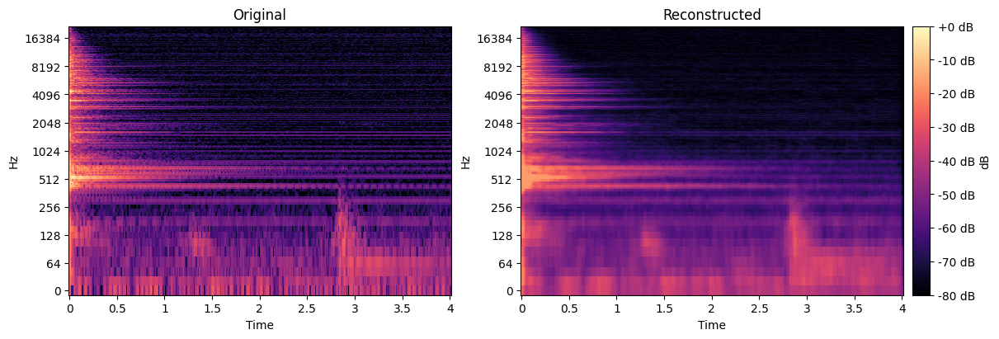

Strike 25 — reconstructed


Strike 25 — original


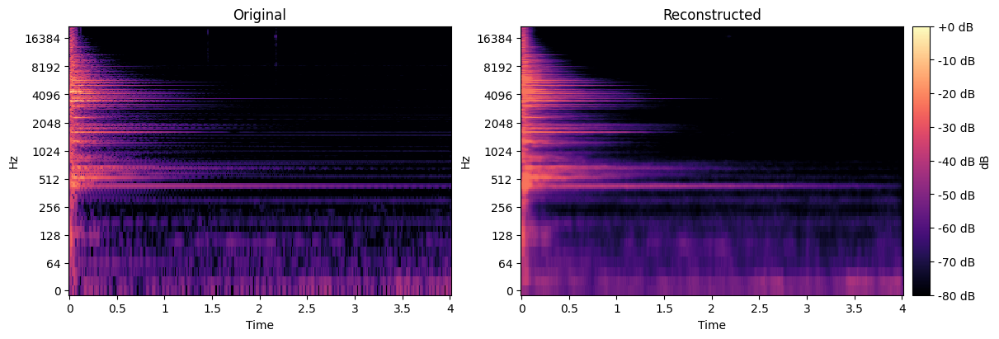

Strike 26 — reconstructed


Strike 26 — original


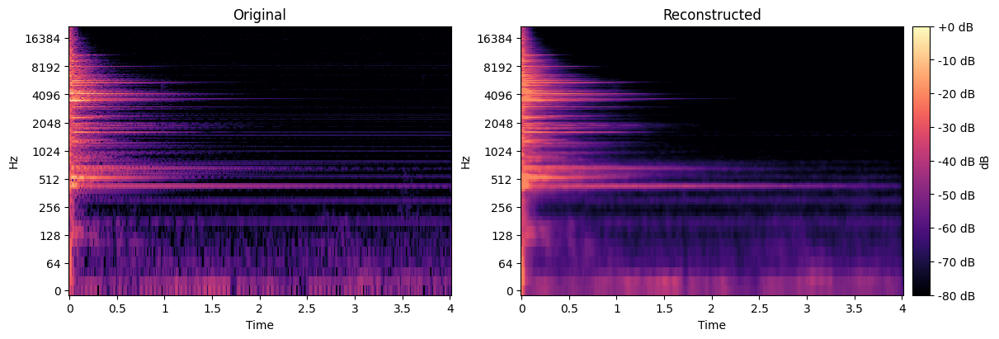

Strike 27 — reconstructed


Strike 27 — original


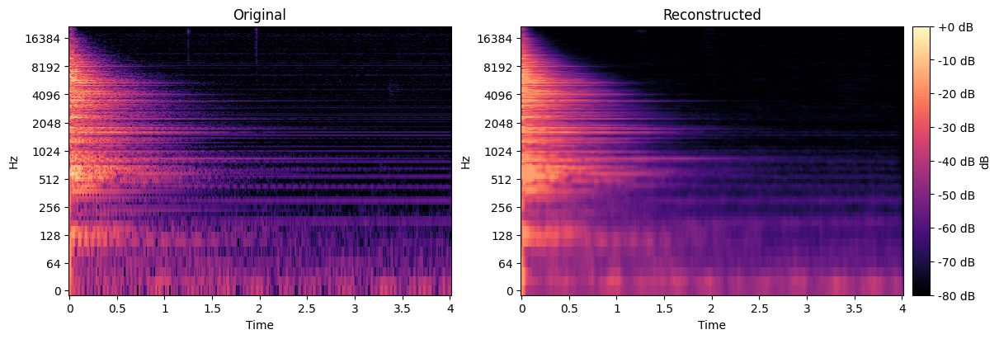

Strike 28 — reconstructed


Strike 28 — original


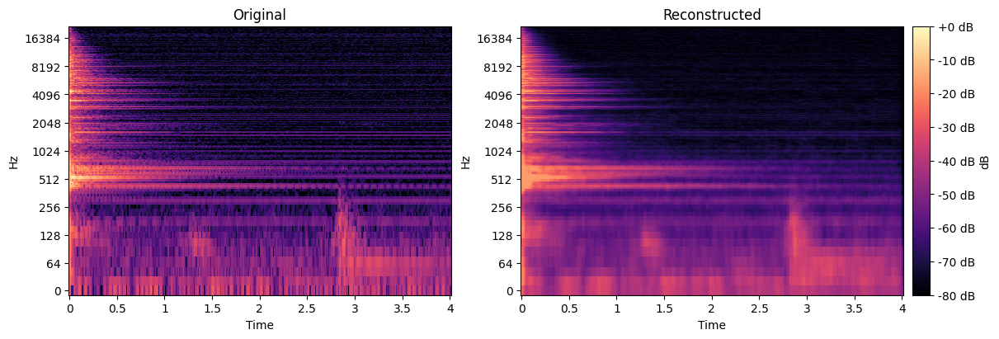

Strike 25 — reconstructed


Strike 25 — original


In [ ]:
# View any index:
show_idx(25)

# Flip through a few quickly:
for k in [26, 27, 28]:
    show_idx(k)

# Revisit instantly (uses cache):
show_idx(25)


## Sixth Encoder

### Model

In [ ]:
# --- Imports (same as before) ---
import numpy as np
import torch, torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, random_split
from tqdm import tqdm
import math
import librosa

# =========================
# Dataset (magnitude now in [0,1] for logmag/phase)
# =========================
class STFTDataset(Dataset):
    def __init__(self, npz_path, target_multiple=32, use_log_mag_phase=False,
                 percentile=99.0, waveforms_npz=None):
        z = np.load(npz_path, allow_pickle=True)
        if "strikes_STFTs" not in z.files:
            raise KeyError(f"'strikes_STFTs' not found in {npz_path}. Keys: {z.files}")
        self.items = z["strikes_STFTs"]              # object array/list-like
        self.target_multiple = target_multiple
        self.use_log_mag_phase = use_log_mag_phase
        self.percentile = percentile

        # Optional paired waveforms
        self.waves = None
        if waveforms_npz is not None:
            w = np.load(waveforms_npz, allow_pickle=True)
            for key in ("strikes", "waveforms", "audio", "audio_recon"):
                if key in w.files:
                    self.waves = w[key]
                    break
            if self.waves is None:
                raise KeyError(f"No waveforms key in {waveforms_npz}. Keys: {w.files}")
            if len(self.waves) != len(self.items):
                raise ValueError(f"Waveform count ({len(self.waves)}) != STFT count ({len(self.items)})")

    def __len__(self):
        # Be robust to object arrays / lists
        try:
            return int(self.items.shape[0])
        except Exception:
            return len(self.items)

    def _pad_to_multiple(self, x, m):
        C, H, W = x.shape
        Hp = (m - H % m) % m
        Wp = (m - W % m) % m
        if Hp or Wp:
            x = np.pad(x, ((0,0),(0,Hp),(0,Wp)), mode="constant")
        return x

    def __getitem__(self, i):
        S = np.asarray(self.items[i], dtype=np.float32)  # [T,F,2]
        T, F, _ = S.shape

        if not self.use_log_mag_phase:
            x = np.transpose(S, (2,1,0)).astype(np.float32)  # [2,F,T]
            scale = np.percentile(np.abs(x), self.percentile)
            scale = 1.0 if scale == 0 else float(scale)
            x = np.clip(x / scale, -1.0, 1.0)
            meta = {"rep": "re_im", "orig_hw": (F, T), "scale": scale}
        else:
            S_c = S[...,0] + 1j*S[...,1]
            mag = np.log1p(np.abs(S_c)).T
            pha = np.angle(S_c).T
            mag_scale = np.percentile(mag, self.percentile)
            mag_scale = 1.0 if mag_scale == 0 else float(mag_scale)
            mag_n = np.clip(mag / mag_scale, 0.0, 1.0)
            pha_n = np.clip(pha / math.pi, -1.0, 1.0)
            x = np.stack([mag_n, pha_n], axis=0).astype(np.float32)
            meta = {"rep": "logmag_phase", "orig_hw": (F, T), "mag_scale": mag_scale}

        x = self._pad_to_multiple(x, self.target_multiple)
        x_t = torch.from_numpy(x)

        if self.waves is None:
            return x_t, meta
        y = np.asarray(self.waves[i], dtype=np.float32)  # 1D waveform
        return x_t, meta, torch.from_numpy(y)

def make_train_val_subsets(ds, val_split=0.1, seed=42):
    n = len(ds)
    n_val = max(1, int(round(n * val_split)))
    n_tr  = n - n_val
    gen = torch.Generator().manual_seed(seed)
    ds_tr, ds_val = random_split(ds, [n_tr, n_val], generator=gen)
    return ds_tr, ds_val

def pad_collate(batch):
    has_waves = (len(batch[0]) == 3)
    if has_waves:
        xs, metas, waves = zip(*batch)
    else:
        xs, metas = zip(*batch); waves = None

    C = xs[0].shape[0]
    Hmax = max(x.shape[1] for x in xs)
    Wmax = max(x.shape[2] for x in xs)
    xb = torch.zeros(len(xs), C, Hmax, Wmax, dtype=xs[0].dtype)
    for i, x in enumerate(xs):
        _, H, W = x.shape
        xb[i, :, :H, :W] = x

    return (xb, metas, list(waves)) if has_waves else (xb, metas)

# =========================
# TinyCAE with conditional heads (sigmoid mag, tanh phase)
# =========================
class TinyCAE(nn.Module):
    def __init__(self, in_ch=2, latent_ch=64, rep="re_im"):
        super().__init__()
        self.rep = rep  # "re_im" or "logmag_phase"

        self.enc = nn.Sequential(
            nn.Conv2d(in_ch, 32, 3, 2, 1), nn.GELU(),
            nn.Conv2d(32, 64, 3, 2, 1),    nn.GELU(),
            nn.Conv2d(64, latent_ch, 3, 2, 1), nn.GELU()
        )

        self.dec_body = nn.Sequential(
            nn.ConvTranspose2d(latent_ch, 64, 4, 2, 1), nn.GELU(),
            nn.ConvTranspose2d(64, 32, 4, 2, 1),        nn.GELU(),
        )
        self.dec_out = nn.ConvTranspose2d(32, in_ch, 4, 2, 1)

    def encode(self, x):  return self.enc(x)

    def decode(self, z):
        h = self.dec_body(z)
        y = self.dec_out(h)  # [B,2,H,W]
        if self.rep == "logmag_phase":
            # y[:,0] -> magnitude in [0,1], y[:,1] -> phase in [-1,1]
            # mag = torch.sigmoid(y[:, 0:1])
            mag = torch.nn.functional.softplus(y[:,0:1])  # ≥0, no saturation near peaks
            pha = torch.tanh(   y[:, 1:2])
            return torch.cat([mag, pha], dim=1)
        else:
            # re/imag in [-1,1]
            return torch.tanh(y)

    def forward(self, x): return self.decode(self.encode(x))

# =========================
# Training with floor penalty & magnitude loss (configurable)
# =========================
def train_cae(
    npz_path,
    epochs=10,
    batch_size=8,
    lr=2e-4,
    in_ch=2,
    latent_ch=124,
    target_multiple=32,
    use_log_mag_phase=False,
    percentile=99.0,
    floor_penalty_w=0.1,
    mag_loss_w=0.2,
    quiet_threshold=0.02,
    # waveform supervision (optional)
    waveforms_npz=None,
    waveform_l1_w=0.0,
    mrstft_w=0.0,
    onset_boost_w=0.0,
    mrstft_ffts=(1024, 2048, 4096),
    mrstft_hops=(256, 512, 1024),
    # validation
    val_split=0.1,
    seed=42,
    # sys
    num_workers=2,
    device=None,
    steps_per_epoch=None,
    ckpt_best_path="ae_best.pt"
):
    import torch.nn.functional as F
    device = device or ("cuda" if torch.cuda.is_available() else "cpu")
    pin_mem = (device == "cuda")

    # Read STFT params (needed if you enable waveform-domain losses)
    hdr = np.load(npz_path, allow_pickle=True)
    n_fft      = int(hdr["n_fft"])      if "n_fft" in hdr else 2048
    hop_length = int(hdr["hop_length"]) if "hop_length" in hdr else 512

    # Base dataset (optionally with waveforms)
    base_ds = STFTDataset(npz_path, target_multiple=target_multiple,
                          use_log_mag_phase=use_log_mag_phase,
                          percentile=percentile,
                          waveforms_npz=waveforms_npz)

    # Split
    ds_tr, ds_val = make_train_val_subsets(base_ds, val_split=val_split, seed=seed)

    # Loaders
    dl_tr  = DataLoader(ds_tr,  batch_size=batch_size, shuffle=True,  drop_last=True,
                        num_workers=num_workers, collate_fn=pad_collate, pin_memory=pin_mem)
    dl_val = DataLoader(ds_val, batch_size=batch_size, shuffle=False, drop_last=False,
                        num_workers=num_workers, collate_fn=pad_collate, pin_memory=pin_mem)

    # Model & opt
    rep = "logmag_phase" if use_log_mag_phase else "re_im"
    model = TinyCAE(in_ch=in_ch, latent_ch=latent_ch, rep=rep).to(device)
    opt = torch.optim.AdamW(model.parameters(), lr=lr)
    L1  = nn.L1Loss()
    hann_main = torch.hann_window(n_fft, device=device)

    def center_pad_or_crop_1d_torch(x, L):
        n = x.shape[-1]
        if n == L: return x
        if n > L:
            s = (n - L) // 2
            return x[..., s:s+L]
        pad_left = (L - n)//2
        pad_right= L - n - pad_left
        return F.pad(x, (pad_left, pad_right))

    def mrstft_loss_time(pred_wav, true_wav):
        loss = 0.0
        cnt  = 0
        for N,H in zip(mrstft_ffts, mrstft_hops):
            win = torch.hann_window(N, device=pred_wav.device)
            P = torch.stft(pred_wav, n_fft=N, hop_length=H, win_length=N, window=win,
                           return_complex=True, center=True).abs()
            Tt= torch.stft(true_wav, n_fft=N, hop_length=H, win_length=N, window=win,
                           return_complex=True, center=True).abs()
            loss = loss + (P - Tt).abs().mean()
            cnt += 1
        return loss / max(1, cnt)

    def batch_loss(xb, metas, recon, training=True):
        """Compute total loss for a batch; used in train & val."""
        loss = L1(recon, xb)

        # mag channels for aux losses
        if use_log_mag_phase:
            true_mag = xb[:,0]        # 0..1
            pred_mag = recon[:,0]     # 0..1
        else:
            true_mag = torch.sqrt(xb[:,0]**2 + xb[:,1]**2 + 1e-8).clamp(0,1)
            pred_mag = torch.sqrt(recon[:,0]**2 + recon[:,1]**2 + 1e-8).clamp(0,1)

        if floor_penalty_w > 0:
            mask = (true_mag < quiet_threshold).float()
            loss = loss + floor_penalty_w * (pred_mag * mask).mean()

        if mag_loss_w > 0:
            loss = loss + mag_loss_w * L1(pred_mag, true_mag)

        # waveform-domain losses (loop per item because of variable lengths)
        if (waveform_l1_w>0 or mrstft_w>0 or onset_boost_w>0):
            B = xb.size(0)
            for b in range(B):
                if isinstance(metas[b], dict):
                    meta = metas[b]
                    # Use recon[b] + meta to rebuild complex STFT on-the-fly
                    F0,T0 = meta["orig_hw"]
                    if rep == "logmag_phase":
                        mag_scale = torch.tensor(meta["mag_scale"], device=recon.device, dtype=recon.dtype)
                        mag_n = recon[b,0,:F0,:T0].clamp(0,1)
                        phi_n = recon[b,1,:F0,:T0].clamp(-1,1)
                        mag   = torch.expm1(mag_n * mag_scale)
                        phi   = phi_n * math.pi
                        real  = mag * torch.cos(phi)
                        imag  = mag * torch.sin(phi)
                    else:
                        real = recon[b,0,:F0,:T0].clamp(-1,1) * meta["scale"]
                        imag = recon[b,1,:F0,:T0].clamp(-1,1) * meta["scale"]
                    S_pred = torch.complex(real, imag)                       # [F,T]
                    wav_pred = torch.istft(S_pred, n_fft=n_fft, hop_length=hop_length,
                                           win_length=n_fft, window=hann_main, center=True)

                    # Pull target waveform if available in metas: pad_collate returns waves only in batch tuple
                    # We don’t have waves here; we get them from the DataLoader batch itself in the outer loops.
                    # So we return loss only; outer loop passes y list when present.
                else:
                    pass  # metas could be simple placeholders in some setups
        return loss

    history = {"train": [], "val": []}
    best_val = float("inf")

    for epoch in range(1, epochs+1):
        # ---------- Train ----------
        model.train()
        run = 0.0
        pbar = tqdm(dl_tr, desc=f"Epoch {epoch}/{epochs}", leave=False)
        for i, batch in enumerate(pbar, start=1):
            has_waves = (len(batch) == 3)
            if has_waves:
                xb, metas, waves = batch
            else:
                xb, metas = batch; waves=None

            xb = xb.to(device, non_blocking=pin_mem)
            recon = model(xb)

            loss = batch_loss(xb, metas, recon, training=True)

            # Waveform losses (need target waves list)
            if (waveform_l1_w>0 or mrstft_w>0 or onset_boost_w>0) and waves is not None:
                for b in range(xb.size(0)):
                    meta = metas[b]
                    F0,T0 = meta["orig_hw"]
                    if rep == "logmag_phase":
                        mag_scale = torch.tensor(meta["mag_scale"], device=device, dtype=xb.dtype)
                        mag_n = recon[b,0,:F0,:T0].clamp(0,1)
                        phi_n = recon[b,1,:F0,:T0].clamp(-1,1)
                        mag   = torch.expm1(mag_n * mag_scale)
                        phi   = phi_n * math.pi
                        real  = mag * torch.cos(phi); imag = mag * torch.sin(phi)
                    else:
                        real = recon[b,0,:F0,:T0].clamp(-1,1) * meta["scale"]
                        imag = recon[b,1,:F0,:T0].clamp(-1,1) * meta["scale"]

                    S_pred = torch.complex(real, imag)
                    wav_pred = torch.istft(S_pred, n_fft=n_fft, hop_length=hop_length,
                                           win_length=n_fft, window=hann_main, center=True)
                    y_true = waves[b].to(device)

                    L = min(wav_pred.numel(), y_true.numel())
                    wav_pred_c = center_pad_or_crop_1d_torch(wav_pred, L)
                    y_true_c   = center_pad_or_crop_1d_torch(y_true, L)

                    if waveform_l1_w > 0:
                        loss = loss + waveform_l1_w * L1(wav_pred_c, y_true_c)

                    if onset_boost_w > 0:
                        idx = torch.argmax(y_true_c.abs())
                        Tlen = y_true_c.numel()
                        grid = torch.arange(Tlen, device=device, dtype=y_true_c.dtype)
                        sigma = 0.015 * Tlen
                        w = torch.exp(-0.5 * ((grid - idx) / (sigma + 1e-6))**2)
                        w = w / (w.mean() + 1e-6)
                        loss = loss + onset_boost_w * (w * (wav_pred_c - y_true_c).abs()).mean()

                    if mrstft_w > 0:
                        loss = loss + mrstft_w * mrstft_loss_time(wav_pred_c, y_true_c)

            opt.zero_grad(set_to_none=True)
            loss.backward()
            opt.step()

            run += loss.item()
            pbar.set_postfix({"train_L": f"{loss.item():.4f}"})
            if steps_per_epoch and i >= steps_per_epoch:
                break

        train_avg = run / (i if i else 1)
        history["train"].append(train_avg)

        # ---------- Validate ----------
        model.eval()
        vrun = 0.0
        with torch.no_grad():
            for batch in dl_val:
                has_waves = (len(batch) == 3)
                if has_waves:
                    xb, metas, waves = batch
                else:
                    xb, metas = batch; waves=None

                xb = xb.to(device, non_blocking=pin_mem)
                recon = model(xb)

                vloss = batch_loss(xb, metas, recon, training=False)

                if (waveform_l1_w>0 or mrstft_w>0 or onset_boost_w>0) and waves is not None:
                    for b in range(xb.size(0)):
                        meta = metas[b]
                        F0,T0 = meta["orig_hw"]
                        if rep == "logmag_phase":
                            mag_scale = torch.tensor(meta["mag_scale"], device=device, dtype=xb.dtype)
                            mag_n = recon[b,0,:F0,:T0].clamp(0,1)
                            phi_n = recon[b,1,:F0,:T0].clamp(-1,1)
                            mag   = torch.expm1(mag_n * mag_scale)
                            phi   = phi_n * math.pi
                            real  = mag * torch.cos(phi); imag = mag * torch.sin(phi)
                        else:
                            real = recon[b,0,:F0,:T0].clamp(-1,1) * meta["scale"]
                            imag = recon[b,1,:F0,:T0].clamp(-1,1) * meta["scale"]

                        S_pred = torch.complex(real, imag)
                        wav_pred = torch.istft(S_pred, n_fft=n_fft, hop_length=hop_length,
                                               win_length=n_fft, window=hann_main, center=True)
                        y_true = waves[b].to(device)

                        L = min(wav_pred.numel(), y_true.numel())
                        wav_pred_c = center_pad_or_crop_1d_torch(wav_pred, L)
                        y_true_c   = center_pad_or_crop_1d_torch(y_true, L)

                        if waveform_l1_w > 0:
                            vloss = vloss + waveform_l1_w * L1(wav_pred_c, y_true_c)
                        if onset_boost_w > 0:
                            idx = torch.argmax(y_true_c.abs())
                            Tlen = y_true_c.numel()
                            grid = torch.arange(Tlen, device=device, dtype=y_true_c.dtype)
                            sigma = 0.015 * Tlen
                            w = torch.exp(-0.5 * ((grid - idx) / (sigma + 1e-6))**2)
                            w = w / (w.mean() + 1e-6)
                            vloss = vloss + onset_boost_w * (w * (wav_pred_c - y_true_c).abs()).mean()
                        if mrstft_w > 0:
                            vloss = vloss + mrstft_w * mrstft_loss_time(wav_pred_c, y_true_c)

                vrun += vloss.item()

        val_avg = vrun / max(1, len(dl_val))
        history["val"].append(val_avg)
        print(f"Epoch {epoch}: train={train_avg:.4f}  val={val_avg:.4f}")

        # Checkpoint the best val
        if val_avg < best_val:
            best_val = val_avg
            torch.save(model.state_dict(), ckpt_best_path)

    print(f"Best val loss: {best_val:.4f} (saved to {ckpt_best_path})")
    return model, history


### Model Execution

In [ ]:
model, hist = train_cae(
    npz_path="ML_Data_complex/strikes_STFTs.npz",
    waveforms_npz="ML_Data_complex/strikes_waveforms.npz",   # optional but recommended for transients
    epochs=500, batch_size=1, lr=1.8e-3,
    in_ch=2, latent_ch=256,
    target_multiple=32,
    use_log_mag_phase=True,
    percentile=99.98,
    floor_penalty_w=0.1,
    mag_loss_w=0.3,
    quiet_threshold=0.01,
    # waveform losses
    waveform_l1_w=0.2, mrstft_w=0.2, onset_boost_w=0.1,
    # validation
    val_split=0.15, seed=123,          # 15% held-out
    ckpt_best_path="ae_best.pt",
)


Epoch 1: train=0.9424  val=0.8870


Epoch 2: train=0.6712  val=0.4109


Epoch 3: train=0.3787  val=0.3620


Epoch 4: train=0.3653  val=0.3551


Epoch 5: train=0.3554  val=0.3513


Epoch 6: train=0.3537  val=0.3509


Epoch 7: train=0.3516  val=0.3403


Epoch 8: train=0.3358  val=0.3267


Epoch 9: train=0.3210  val=0.3105


Epoch 10: train=0.3067  val=0.2999


Epoch 11: train=0.2951  val=0.2820


Epoch 12: train=0.2712  val=0.2600


Epoch 13: train=0.2599  val=0.2602


Epoch 14: train=0.2522  val=0.2465


Epoch 15: train=0.2453  val=0.2412


Epoch 16: train=0.2402  val=0.2376


Epoch 17: train=0.2327  val=0.2285


Epoch 18: train=0.2277  val=0.2241


Epoch 19: train=0.2237  val=0.2235


Epoch 20: train=0.2180  val=0.2126


Epoch 21: train=0.2070  val=0.2041


Epoch 22: train=0.1995  val=0.1979


Epoch 23: train=0.1955  val=0.1986


Epoch 24: train=0.1901  val=0.1866


Epoch 25: train=0.1832  val=0.1815


Epoch 26: train=0.1795  val=0.1889


Epoch 27: train=0.1755  val=0.1739


Epoch 28: train=0.1815  val=0.1759


Epoch 29: train=0.1645  val=0.1778


Epoch 30: train=0.1750  val=0.1642


Epoch 31: train=0.1600  val=0.1841


Epoch 32: train=0.1535  val=0.1551


Epoch 33: train=0.1453  val=0.1500


Epoch 34: train=0.1403  val=0.1451


Epoch 35: train=0.1399  val=0.1420


Epoch 36: train=0.1421  val=0.1467


Epoch 37: train=0.1413  val=0.1432


Epoch 38: train=0.1333  val=0.1391


Epoch 39: train=0.1317  val=0.1404


Epoch 40: train=0.1315  val=0.1467


Epoch 41: train=0.1357  val=0.1386


Epoch 42: train=0.1321  val=0.1367


Epoch 43: train=0.1289  val=0.1346


Epoch 44: train=0.1259  val=0.1362


Epoch 45: train=0.1282  val=0.1350


Epoch 46: train=0.1318  val=0.1346


Epoch 47: train=0.1271  val=0.1391


Epoch 48: train=0.1324  val=0.1406


Epoch 49: train=0.1262  val=0.1334


Epoch 50: train=0.1208  val=0.1312


Epoch 51: train=0.1196  val=0.1293


Epoch 52: train=0.1186  val=0.1274


Epoch 53: train=0.1244  val=0.1413


Epoch 54: train=0.1275  val=0.1365


Epoch 55: train=0.1158  val=0.1278


Epoch 56: train=0.1137  val=0.1329


Epoch 57: train=0.1124  val=0.1228


Epoch 58: train=0.1210  val=0.1251


Epoch 59: train=0.1126  val=0.1218


Epoch 60: train=0.1102  val=0.1245


Epoch 61: train=0.1104  val=0.1252


Epoch 62: train=0.1124  val=0.1232


Epoch 63: train=0.1101  val=0.1211


Epoch 64: train=0.1075  val=0.1213


Epoch 65: train=0.1080  val=0.1197


Epoch 66: train=0.1064  val=0.1203


Epoch 67: train=0.1055  val=0.1189


Epoch 68: train=0.1072  val=0.1173


Epoch 69: train=0.1053  val=0.1200


Epoch 70: train=0.1050  val=0.1203


Epoch 71: train=0.1039  val=0.1170


Epoch 72: train=0.1040  val=0.1176


Epoch 73: train=0.1042  val=0.1190


Epoch 74: train=0.1035  val=0.1168


Epoch 75: train=0.1026  val=0.1197


Epoch 76: train=0.1135  val=0.1214


Epoch 77: train=0.1054  val=0.1171


Epoch 78: train=0.1050  val=0.1467


Epoch 79: train=0.1160  val=0.1222


Epoch 80: train=0.1030  val=0.1180


Epoch 81: train=0.1010  val=0.1184


Epoch 82: train=0.1077  val=0.1171


Epoch 83: train=0.1007  val=0.1168


Epoch 84: train=0.0995  val=0.1169


Epoch 85: train=0.0986  val=0.1202


Epoch 86: train=0.1003  val=0.1151


Epoch 87: train=0.0991  val=0.1158


Epoch 88: train=0.0985  val=0.1166


Epoch 89: train=0.0997  val=0.1245


Epoch 90: train=0.1104  val=0.1157


Epoch 91: train=0.0996  val=0.1175


Epoch 92: train=0.1031  val=0.1201


Epoch 93: train=0.1018  val=0.1162


Epoch 94: train=0.0976  val=0.1135


Epoch 95: train=0.0969  val=0.1174


Epoch 96: train=0.0968  val=0.1181


Epoch 97: train=0.0979  val=0.1154


Epoch 98: train=0.0962  val=0.1146


Epoch 99: train=0.0958  val=0.1156


Epoch 100: train=0.0951  val=0.1143


Epoch 101: train=0.0973  val=0.1157


Epoch 102: train=0.0959  val=0.1161


Epoch 103: train=0.0973  val=0.1156


Epoch 104: train=0.0952  val=0.1134


Epoch 105: train=0.0961  val=0.1152


Epoch 106: train=0.1026  val=0.1190


Epoch 107: train=0.0954  val=0.1215


Epoch 108: train=0.0998  val=0.1204


Epoch 109: train=0.0971  val=0.1149


Epoch 110: train=0.0963  val=0.1166


Epoch 111: train=0.0943  val=0.1135


Epoch 112: train=0.0943  val=0.1168


Epoch 113: train=0.0958  val=0.1178


Epoch 114: train=0.0958  val=0.1174


Epoch 115: train=0.0942  val=0.1136


Epoch 116: train=0.0977  val=0.1198


Epoch 117: train=0.0991  val=0.1210


Epoch 118: train=0.0947  val=0.1154


Epoch 119: train=0.0921  val=0.1156


Epoch 120: train=0.0932  val=0.1132


Epoch 121: train=0.0918  val=0.1140


Epoch 122: train=0.0913  val=0.1136


Epoch 123: train=0.0932  val=0.1135


Epoch 124: train=0.0927  val=0.1162


Epoch 125: train=0.0921  val=0.1163


Epoch 126: train=0.0985  val=0.1215


Epoch 127: train=0.0962  val=0.1134


Epoch 128: train=0.0907  val=0.1167


Epoch 129: train=0.0912  val=0.1142


Epoch 130: train=0.0895  val=0.1149


Epoch 131: train=0.0896  val=0.1133


Epoch 132: train=0.0927  val=0.1128


Epoch 133: train=0.0897  val=0.1156


Epoch 134: train=0.0892  val=0.1148


Epoch 135: train=0.0894  val=0.1140


Epoch 136: train=0.0886  val=0.1137


Epoch 137: train=0.0883  val=0.1161


Epoch 138: train=0.0921  val=0.1143


Epoch 139: train=0.0898  val=0.1126


Epoch 140: train=0.0906  val=0.1135


Epoch 141: train=0.0886  val=0.1149


Epoch 142: train=0.0906  val=0.1194


Epoch 143: train=0.0935  val=0.1132


Epoch 144: train=0.0903  val=0.1138


Epoch 145: train=0.0894  val=0.1164


Epoch 146: train=0.0887  val=0.1129


Epoch 147: train=0.0880  val=0.1124


Epoch 148: train=0.0874  val=0.1136


Epoch 149: train=0.0880  val=0.1135


Epoch 150: train=0.0883  val=0.1127


Epoch 151: train=0.0923  val=0.1231


Epoch 152: train=0.0977  val=0.1154


Epoch 153: train=0.0909  val=0.1149


Epoch 154: train=0.0879  val=0.1141


Epoch 155: train=0.0868  val=0.1153


Epoch 156: train=0.0864  val=0.1130


Epoch 157: train=0.0872  val=0.1212


Epoch 158: train=0.0895  val=0.1122


Epoch 159: train=0.0894  val=0.1144


Epoch 160: train=0.0918  val=0.1124


Epoch 161: train=0.0868  val=0.1131


Epoch 162: train=0.0865  val=0.1156


Epoch 163: train=0.0872  val=0.1127


Epoch 164: train=0.0859  val=0.1118


Epoch 165: train=0.0855  val=0.1131


Epoch 166: train=0.0861  val=0.1142


Epoch 167: train=0.0854  val=0.1149


Epoch 168: train=0.0863  val=0.1129


Epoch 169: train=0.0878  val=0.1138


Epoch 170: train=0.0873  val=0.1179


Epoch 171: train=0.0898  val=0.1180


Epoch 172: train=0.0869  val=0.1169


Epoch 173: train=0.0854  val=0.1116


Epoch 174: train=0.0844  val=0.1120


Epoch 175: train=0.0862  val=0.1132


Epoch 176: train=0.0852  val=0.1151


Epoch 177: train=0.0918  val=0.1191


Epoch 178: train=0.0876  val=0.1144


Epoch 179: train=0.0852  val=0.1135


Epoch 180: train=0.0844  val=0.1144


Epoch 181: train=0.0839  val=0.1123


Epoch 182: train=0.0849  val=0.1115


Epoch 183: train=0.0844  val=0.1164


Epoch 184: train=0.0872  val=0.1187


Epoch 185: train=0.0844  val=0.1121


Epoch 186: train=0.0832  val=0.1117


Epoch 187: train=0.0835  val=0.1152


Epoch 188: train=0.0837  val=0.1117


Epoch 189: train=0.0867  val=0.1180


Epoch 190: train=0.0848  val=0.1151


Epoch 191: train=0.0838  val=0.1139


Epoch 192: train=0.0839  val=0.1158


Epoch 193: train=0.0834  val=0.1125


Epoch 194: train=0.0832  val=0.1120


Epoch 195: train=0.0834  val=0.1149


Epoch 196: train=0.0852  val=0.1126


Epoch 197: train=0.0825  val=0.1156


Epoch 198: train=0.0836  val=0.1108


Epoch 199: train=0.0833  val=0.1142


Epoch 200: train=0.0820  val=0.1130


Epoch 201: train=0.0820  val=0.1129


Epoch 202: train=0.0822  val=0.1113


Epoch 203: train=0.0839  val=0.1117


Epoch 204: train=0.0824  val=0.1124


Epoch 205: train=0.0826  val=0.1109


Epoch 206: train=0.0852  val=0.1248


Epoch 207: train=0.0867  val=0.1109


Epoch 208: train=0.0851  val=0.1253


Epoch 209: train=0.0848  val=0.1203


Epoch 210: train=0.0878  val=0.1117


Epoch 211: train=0.0824  val=0.1135


Epoch 212: train=0.0849  val=0.1120


Epoch 213: train=0.0831  val=0.1116


Epoch 214: train=0.0858  val=0.1175


Epoch 215: train=0.0839  val=0.1142


Epoch 216: train=0.0828  val=0.1122


Epoch 217: train=0.0812  val=0.1137


Epoch 218: train=0.0816  val=0.1109


Epoch 219: train=0.0833  val=0.1128


Epoch 220: train=0.0836  val=0.1133


Epoch 221: train=0.0825  val=0.1108


Epoch 222: train=0.0823  val=0.1112


Epoch 223: train=0.0807  val=0.1126


Epoch 224: train=0.0800  val=0.1095


Epoch 225: train=0.0801  val=0.1172


Epoch 226: train=0.0894  val=0.1208


Epoch 227: train=0.0859  val=0.1190


Epoch 228: train=0.0830  val=0.1108


Epoch 229: train=0.0804  val=0.1113


Epoch 230: train=0.0805  val=0.1133


Epoch 231: train=0.0899  val=0.1152


Epoch 232: train=0.0823  val=0.1124


Epoch 233: train=0.0798  val=0.1149


Epoch 234: train=0.0799  val=0.1116


Epoch 235: train=0.0801  val=0.1133


Epoch 236: train=0.0841  val=0.1102


Epoch 237: train=0.0804  val=0.1135


Epoch 238: train=0.0820  val=0.1143


Epoch 239: train=0.0794  val=0.1128


Epoch 240: train=0.0790  val=0.1115


Epoch 241: train=0.0785  val=0.1113


Epoch 242: train=0.0784  val=0.1108


Epoch 243: train=0.0783  val=0.1098


Epoch 244: train=0.0782  val=0.1101


Epoch 245: train=0.0780  val=0.1109


Epoch 246: train=0.0783  val=0.1113


Epoch 247: train=0.0799  val=0.1177


Epoch 248: train=0.0796  val=0.1129


Epoch 249: train=0.0803  val=0.1101


Epoch 250: train=0.0995  val=0.1189


Epoch 251: train=0.0834  val=0.1114


Epoch 252: train=0.0803  val=0.1160


Epoch 253: train=0.0851  val=0.1135


Epoch 254: train=0.0804  val=0.1126


Epoch 255: train=0.0794  val=0.1106


Epoch 256: train=0.0787  val=0.1105


Epoch 257: train=0.0783  val=0.1104


Epoch 258: train=0.0780  val=0.1117


Epoch 259: train=0.0779  val=0.1091


Epoch 260: train=0.0786  val=0.1088


Epoch 261: train=0.0782  val=0.1098


Epoch 262: train=0.0777  val=0.1097


Epoch 263: train=0.0808  val=0.1103


Epoch 264: train=0.0783  val=0.1152


Epoch 265: train=0.0785  val=0.1121


Epoch 266: train=0.0771  val=0.1101


Epoch 267: train=0.0780  val=0.1125


Epoch 268: train=0.0771  val=0.1106


Epoch 269: train=0.0772  val=0.1088


Epoch 270: train=0.0770  val=0.1094


Epoch 271: train=0.0766  val=0.1113


Epoch 272: train=0.0771  val=0.1118


Epoch 273: train=0.0812  val=0.1093


Epoch 274: train=0.0783  val=0.1110


Epoch 275: train=0.0780  val=0.1097


Epoch 276: train=0.0773  val=0.1092


Epoch 277: train=0.0766  val=0.1102


Epoch 278: train=0.0759  val=0.1110


Epoch 279: train=0.0761  val=0.1112


Epoch 280: train=0.0796  val=0.1180


Epoch 281: train=0.0829  val=0.1101


Epoch 282: train=0.0823  val=0.1100


Epoch 283: train=0.0771  val=0.1130


Epoch 284: train=0.0765  val=0.1123


Epoch 285: train=0.0763  val=0.1109


Epoch 286: train=0.0767  val=0.1114


Epoch 287: train=0.0763  val=0.1104


Epoch 288: train=0.0824  val=0.1131


Epoch 289: train=0.0804  val=0.1102


Epoch 290: train=0.0763  val=0.1121


Epoch 291: train=0.0759  val=0.1119


Epoch 292: train=0.0769  val=0.1145


Epoch 293: train=0.0785  val=0.1099


Epoch 294: train=0.0754  val=0.1110


Epoch 295: train=0.0749  val=0.1115


Epoch 296: train=0.0754  val=0.1083


Epoch 297: train=0.0755  val=0.1095


Epoch 298: train=0.0751  val=0.1103


Epoch 299: train=0.0754  val=0.1110


Epoch 300: train=0.0747  val=0.1087


Epoch 301: train=0.0756  val=0.1099


Epoch 302: train=0.0750  val=0.1082


Epoch 303: train=0.0749  val=0.1078


Epoch 304: train=0.0755  val=0.1204


Epoch 305: train=0.0819  val=0.1082


Epoch 306: train=0.0796  val=0.1168


Epoch 307: train=0.0790  val=0.1104


Epoch 308: train=0.0765  val=0.1094


Epoch 309: train=0.0755  val=0.1114


Epoch 310: train=0.0771  val=0.1076


Epoch 311: train=0.0748  val=0.1088


Epoch 312: train=0.0779  val=0.1105


Epoch 313: train=0.0750  val=0.1136


Epoch 314: train=0.0748  val=0.1091


Epoch 315: train=0.0751  val=0.1085


Epoch 316: train=0.0742  val=0.1076


Epoch 317: train=0.0747  val=0.1079


Epoch 318: train=0.0739  val=0.1095


Epoch 319: train=0.0746  val=0.1089


Epoch 320: train=0.0733  val=0.1077


Epoch 321: train=0.0738  val=0.1085


Epoch 322: train=0.0746  val=0.1085


Epoch 323: train=0.0739  val=0.1096


Epoch 324: train=0.0736  val=0.1084


Epoch 325: train=0.0731  val=0.1073


Epoch 326: train=0.0731  val=0.1088


Epoch 327: train=0.0745  val=0.1099


Epoch 328: train=0.0735  val=0.1073


Epoch 329: train=0.0726  val=0.1091


Epoch 330: train=0.0727  val=0.1100


Epoch 331: train=0.0734  val=0.1072


Epoch 332: train=0.0732  val=0.1120


Epoch 333: train=0.0759  val=0.1212


Epoch 334: train=0.0781  val=0.1146


Epoch 335: train=0.0728  val=0.1071


Epoch 336: train=0.0725  val=0.1092


Epoch 337: train=0.0769  val=0.1092


Epoch 338: train=0.0753  val=0.1086


Epoch 339: train=0.0737  val=0.1079


Epoch 340: train=0.0719  val=0.1083


Epoch 341: train=0.0719  val=0.1102


Epoch 342: train=0.0725  val=0.1089


Epoch 343: train=0.0723  val=0.1085


Epoch 344: train=0.0728  val=0.1108


Epoch 345: train=0.0718  val=0.1067


Epoch 346: train=0.0719  val=0.1078


Epoch 347: train=0.0719  val=0.1090


Epoch 348: train=0.0744  val=0.1127


Epoch 349: train=0.0741  val=0.1109


Epoch 350: train=0.0721  val=0.1085


Epoch 351: train=0.0718  val=0.1081


Epoch 352: train=0.0726  val=0.1100


Epoch 353: train=0.0739  val=0.1127


Epoch 354: train=0.0722  val=0.1079


Epoch 355: train=0.0725  val=0.1076


Epoch 356: train=0.0714  val=0.1057


Epoch 357: train=0.0709  val=0.1082


Epoch 358: train=0.0715  val=0.1076


Epoch 359: train=0.0709  val=0.1084


Epoch 360: train=0.0722  val=0.1076


Epoch 361: train=0.0710  val=0.1062


Epoch 362: train=0.0705  val=0.1071


Epoch 363: train=0.0707  val=0.1132


Epoch 364: train=0.0717  val=0.1063


Epoch 365: train=0.0733  val=0.1140


Epoch 366: train=0.0724  val=0.1083


Epoch 367: train=0.0707  val=0.1085


Epoch 368: train=0.0708  val=0.1074


Epoch 369: train=0.0714  val=0.1065


Epoch 370: train=0.0702  val=0.1064


Epoch 371: train=0.0705  val=0.1070


Epoch 372: train=0.0703  val=0.1082


Epoch 373: train=0.0705  val=0.1067


Epoch 374: train=0.0696  val=0.1069


Epoch 375: train=0.0698  val=0.1061


Epoch 376: train=0.0700  val=0.1072


Epoch 377: train=0.0698  val=0.1071


Epoch 378: train=0.0695  val=0.1064


Epoch 379: train=0.0696  val=0.1068


Epoch 380: train=0.0692  val=0.1073


Epoch 381: train=0.0730  val=0.1061


Epoch 382: train=0.0738  val=0.1059


Epoch 383: train=0.0699  val=0.1069


Epoch 384: train=0.0695  val=0.1060


Epoch 385: train=0.0690  val=0.1048


Epoch 386: train=0.0704  val=0.1089


Epoch 387: train=0.0702  val=0.1089


Epoch 388: train=0.0729  val=0.1086


Epoch 389: train=0.0709  val=0.1106


Epoch 390: train=0.0698  val=0.1078


Epoch 391: train=0.0695  val=0.1066


Epoch 392: train=0.0695  val=0.1068


Epoch 393: train=0.0689  val=0.1049


Epoch 394: train=0.0702  val=0.1079


Epoch 395: train=0.0735  val=0.1169


Epoch 396: train=0.0730  val=0.1068


Epoch 397: train=0.0694  val=0.1057


Epoch 398: train=0.0691  val=0.1076


Epoch 399: train=0.0685  val=0.1052


Epoch 400: train=0.0681  val=0.1052


Epoch 401: train=0.0680  val=0.1079


Epoch 402: train=0.0686  val=0.1060


Epoch 403: train=0.0684  val=0.1059


Epoch 404: train=0.0684  val=0.1063


Epoch 405: train=0.0688  val=0.1102


Epoch 406: train=0.0727  val=0.1055


Epoch 407: train=0.0702  val=0.1061


Epoch 408: train=0.0689  val=0.1053


Epoch 409: train=0.0699  val=0.1085


Epoch 410: train=0.0772  val=0.1048


Epoch 411: train=0.0703  val=0.1059


Epoch 412: train=0.0694  val=0.1065


Epoch 413: train=0.0692  val=0.1050


Epoch 414: train=0.0683  val=0.1088


Epoch 415: train=0.0685  val=0.1092


Epoch 416: train=0.0686  val=0.1070


Epoch 417: train=0.0703  val=0.1064


Epoch 418: train=0.0681  val=0.1053


Epoch 419: train=0.0676  val=0.1079


Epoch 420: train=0.0693  val=0.1053


Epoch 421: train=0.0708  val=0.1072


Epoch 422: train=0.0716  val=0.1062


Epoch 423: train=0.0693  val=0.1066


Epoch 424: train=0.0687  val=0.1068


Epoch 425: train=0.0679  val=0.1058


Epoch 426: train=0.0672  val=0.1087


Epoch 427: train=0.0680  val=0.1041


Epoch 428: train=0.0683  val=0.1064


Epoch 429: train=0.0677  val=0.1080


Epoch 430: train=0.0683  val=0.1042


Epoch 431: train=0.0689  val=0.1059


Epoch 432: train=0.0680  val=0.1060


Epoch 433: train=0.0677  val=0.1089


Epoch 434: train=0.0741  val=0.1071


Epoch 435: train=0.0739  val=0.1151


Epoch 436: train=0.0706  val=0.1061


Epoch 437: train=0.0699  val=0.1067


Epoch 438: train=0.0694  val=0.1092


Epoch 439: train=0.0676  val=0.1090


Epoch 440: train=0.0688  val=0.1051


Epoch 441: train=0.0720  val=0.1051


Epoch 442: train=0.0674  val=0.1098


Epoch 443: train=0.0729  val=0.1058


Epoch 444: train=0.0727  val=0.1056


Epoch 445: train=0.0681  val=0.1076


Epoch 446: train=0.0676  val=0.1059


Epoch 447: train=0.0665  val=0.1055


Epoch 448: train=0.0676  val=0.1061


Epoch 449: train=0.0713  val=0.1040


Epoch 450: train=0.0673  val=0.1057


Epoch 451: train=0.0663  val=0.1038


Epoch 452: train=0.0663  val=0.1066


Epoch 453: train=0.0667  val=0.1039


Epoch 454: train=0.0671  val=0.1068


Epoch 455: train=0.0670  val=0.1066


Epoch 456: train=0.0676  val=0.1079


Epoch 457: train=0.0709  val=0.1052


Epoch 458: train=0.0714  val=0.1066


Epoch 459: train=0.0678  val=0.1047


Epoch 460: train=0.0676  val=0.1042


Epoch 461: train=0.0679  val=0.1064


Epoch 462: train=0.0676  val=0.1047


Epoch 463: train=0.0689  val=0.1058


Epoch 464: train=0.0672  val=0.1057


Epoch 465: train=0.0660  val=0.1051


Epoch 466: train=0.0660  val=0.1066


Epoch 467: train=0.0667  val=0.1057


Epoch 468: train=0.0671  val=0.1077


Epoch 469: train=0.0712  val=0.1097


Epoch 470: train=0.0695  val=0.1050


Epoch 471: train=0.0676  val=0.1117


Epoch 472: train=0.0685  val=0.1050


Epoch 473: train=0.0681  val=0.1174


Epoch 474: train=0.0693  val=0.1078


Epoch 475: train=0.0675  val=0.1100


Epoch 476: train=0.0676  val=0.1062


Epoch 477: train=0.0666  val=0.1056


Epoch 478: train=0.0661  val=0.1058


Epoch 479: train=0.0707  val=0.1044


Epoch 480: train=0.0679  val=0.1047


Epoch 481: train=0.0672  val=0.1046


Epoch 482: train=0.0671  val=0.1077


Epoch 483: train=0.0677  val=0.1049


Epoch 484: train=0.0670  val=0.1082


Epoch 485: train=0.0670  val=0.1060


Epoch 486: train=0.0663  val=0.1045


Epoch 487: train=0.0660  val=0.1077


Epoch 488: train=0.0698  val=0.1036


Epoch 489: train=0.0668  val=0.1070


Epoch 490: train=0.0667  val=0.1057


Epoch 491: train=0.0661  val=0.1042


Epoch 492: train=0.0664  val=0.1061


Epoch 493: train=0.0690  val=0.1094


Epoch 494: train=0.0681  val=0.1068


Epoch 495: train=0.0658  val=0.1044


Epoch 496: train=0.0666  val=0.1070


Epoch 497: train=0.0670  val=0.1056


Epoch 498: train=0.0666  val=0.1046


Epoch 499: train=0.0652  val=0.1053


Epoch 500: train=0.0658  val=0.1048
Best val loss: 0.1036 (saved to ae_best.pt)


Best val loss: 0.1098 (saved to ae_best.pt)
with
    epochs=300, batch_size=1, lr=1.8e-3,
    in_ch=2, latent_ch=256,
    target_multiple=32,
    use_log_mag_phase=True,
    percentile=99.98,
    floor_penalty_w=0.2,
    mag_loss_w=0.1,
    quiet_threshold=0.01,
    # waveform losses
    waveform_l1_w=0.2, mrstft_w=0.2, onset_boost_w=0.1,
    # validation
    val_split=0.15, seed=123,          # 15% held-out
    ckpt_best_path="ae_best.pt",


Best val loss: 0.1036 (saved to ae_best.pt)
with
    epochs=500, batch_size=1, lr=1.8e-3,
    in_ch=2, latent_ch=256,
    target_multiple=32,
    use_log_mag_phase=True,
    percentile=99.98,
    floor_penalty_w=0.1,
    mag_loss_w=0.3,
    quiet_threshold=0.01,
    # waveform losses
    waveform_l1_w=0.2, mrstft_w=0.2, onset_boost_w=0.1,
    # validation
    val_split=0.15, seed=123,          # 15% held-out
    ckpt_best_path="ae_best.pt",


### Validation

#### Compute All Comparisons

In [ ]:
# --- Imports ---
import numpy as np, math
import torch
import librosa, librosa.display
import matplotlib.pyplot as plt
from tqdm import tqdm
from IPython.display import Audio, display

# --- Your model is assumed to already exist in memory as `model`.
# If you saved weights instead, uncomment and adapt:
# model = TinyCAE(in_ch=2, latent_ch=512, rep="logmag_phase")
# model.load_state_dict(torch.load("ae_weights.pt", map_location="cpu"))
# model.eval()

# --- Paths ---
STFT_NPZ = "ML_Data_complex/strikes_STFTs.npz"
WAVE_NPZ = "ML_Data_complex/strikes_waveforms.npz"  # optional

# If you saved the best checkpoint from the new training run:
CKPT = "ae_best.pt"  # or your path

# Must match training hyperparams:
IN_CH = 2
LATENT_CH = 256      # <-- set to what you used (e.g., 256 or 512)
REP = "logmag_phase" # "logmag_phase" if you trained with use_log_mag_phase=True

best = TinyCAE(in_ch=IN_CH, latent_ch=LATENT_CH, rep=REP)
best.load_state_dict(torch.load(CKPT, map_location="cpu"))
device = "cuda" if torch.cuda.is_available() else "cpu"
model = best.to(device).eval()

# --- Load STFT container (originals + params) ---
hdr = np.load(STFT_NPZ, allow_pickle=True)
orig_stfts = hdr["strikes_STFTs"]   # object array: each [T,F,2]
n_fft      = int(hdr["n_fft"])      if "n_fft" in hdr.files else 2048
hop_length = int(hdr["hop_length"]) if "hop_length" in hdr.files else 512
sr         = int(hdr["sample_rate"]) if "sample_rate" in hdr.files else 44100

# --- Optional: load ground-truth waveforms (if present) ---
waves = None
if WAVE_NPZ is not None:
    try:
        wz = np.load(WAVE_NPZ, allow_pickle=True)
        for k in ("strikes","waveforms","audio","audio_recon"):
            if k in wz.files:
                waves = wz[k]
                break
        if "sample_rate" in wz.files:
            sr = int(wz["sample_rate"])
    except Exception:
        waves = None

# --- Build a tiny transform that mirrors your dataset's normalization ---
# We’ll precompute normalized inputs (x_list) + metas once, so later calls are instant.

use_log_mag_phase = True        # match your training call
percentile = 99.98               # match your training call
target_multiple = 32            # match your training call

def _pad_to_multiple(x, m):
    C,H,W = x.shape
    Hp = (m - H % m) % m
    Wp = (m - W % m) % m
    if Hp or Wp:
        x = np.pad(x, ((0,0),(0,Hp),(0,Wp)), mode="constant")
    return x

def _prep_item(i):
    S_TF2 = np.asarray(orig_stfts[i], dtype=np.float32)     # [T,F,2]
    T, F, _ = S_TF2.shape
    S_c = S_TF2[...,0] + 1j*S_TF2[...,1]                    # [T,F] complex

    if use_log_mag_phase:
        mag = np.log1p(np.abs(S_c)).T                       # [F,T] >=0
        pha = np.angle(S_c).T                               # [F,T] in [-pi, pi]
        mag_scale = float(np.percentile(mag, percentile))
        if mag_scale == 0: mag_scale = 1.0
        mag_n = np.clip(mag / mag_scale, 0.0, 1.0)
        pha_n = np.clip(pha / math.pi, -1.0, 1.0)
        x = np.stack([mag_n, pha_n], axis=0).astype(np.float32)   # [2,F,T]
        meta = {"rep":"logmag_phase", "orig_hw":(F,T), "mag_scale":mag_scale}
    else:
        # (re/imag path—not used here, but left for completeness)
        X = np.transpose(S_TF2, (2,1,0)).astype(np.float32)       # [2,F,T]
        scale = float(np.percentile(np.abs(X), percentile))
        if scale == 0: scale = 1.0
        x = np.clip(X/scale, -1, 1)
        meta = {"rep":"re_im", "orig_hw":(F,T), "scale":scale}

    x = _pad_to_multiple(x, target_multiple)                      # [2,Fp,Tp]
    return torch.from_numpy(x), meta

# Precompute normalized inputs + meta (kept on CPU; we’ll move to GPU only for the chosen index)
x_list, meta_list = [], []
print("Precomputing normalized tensors...")
for i in tqdm(range(len(orig_stfts))):
    xi, mi = _prep_item(i)
    x_list.append(xi)      # torch.FloatTensor on CPU
    meta_list.append(mi)

# Small cache for fast browsing (stores recon STFT + audio after first compute)
_cache = {}
print("Ready. Use show_idx(i) in the next cell.")


Precomputing normalized tensors...


100%|██████████| 44/44 [00:01<00:00, 30.95it/s]

Ready. Use show_idx(i) in the next cell.


In [ ]:
def _invert_rep_to_complex(y_CHW, meta):
    """
    y_CHW: [2,H,W] torch/numpy in normalized rep; meta has orig_hw and scales.
    returns S_FT (complex64) with shape [F,T].
    """
    if isinstance(y_CHW, torch.Tensor):
        y = y_CHW.detach().cpu().numpy()
    else:
        y = y_CHW
    F, T = meta["orig_hw"]
    y = y[:, :F, :T]  # crop padding

    if meta["rep"] == "logmag_phase":
        mag_scale = float(meta["mag_scale"])
        mag_n = np.clip(y[0], 0.0, 1.0)
        pha_n = np.clip(y[1], -1.0, 1.0)
        mag = np.expm1(mag_n * mag_scale)
        pha = pha_n * math.pi
        S = mag * np.exp(1j * pha)      # [F,T]
    else:
        scale = float(meta["scale"])
        re = np.clip(y[0], -1, 1) * scale
        im = np.clip(y[1], -1, 1) * scale
        S = re + 1j * im
    return S.astype(np.complex64)

def _to_mag_TF(S_tf2):
    A = np.asarray(S_tf2, dtype=np.float32)
    S = A[...,0] + 1j*A[...,1]     # [T,F]
    return np.abs(S).T.astype(np.float32)  # [F,T]

def compare_stft_fig(S_orig_TF2, S_reco_TF2, sr, hop_length, top_db=80, log_freq=True):
    orig_mag = _to_mag_TF(S_orig_TF2)
    reco_mag = _to_mag_TF(S_reco_TF2)
    ref_val = float(np.max(orig_mag) + 1e-12)
    S_db_o = librosa.amplitude_to_db(orig_mag, ref=ref_val, top_db=top_db)
    S_db_r = librosa.amplitude_to_db(reco_mag, ref=ref_val, top_db=top_db)
    vmin, vmax = -top_db, 0
    y_axis = 'log' if log_freq else 'linear'

    fig = plt.figure(figsize=(12,4), layout='constrained')
    gs  = fig.add_gridspec(1, 3, width_ratios=[1,1,0.045])
    ax0 = fig.add_subplot(gs[0,0])
    ax1 = fig.add_subplot(gs[0,1], sharex=ax0, sharey=ax0)
    cax = fig.add_subplot(gs[0,2])

    im0 = librosa.display.specshow(S_db_o, sr=sr, hop_length=hop_length, x_axis='time', y_axis=y_axis,
                                   ax=ax0, vmin=vmin, vmax=vmax)
    ax0.set_title("Original")
    im1 = librosa.display.specshow(S_db_r, sr=sr, hop_length=hop_length, x_axis='time', y_axis=y_axis,
                                   ax=ax1, vmin=vmin, vmax=vmax)
    ax1.set_title("Reconstructed")
    cb = fig.colorbar(im1, cax=cax, format='%+2.0f dB'); cb.set_label("dB")
    plt.show()

def show_idx(i, play=True, cache=True, top_db=80, log_freq=True):
    """
    Fast viewer:
      - uses preloaded x_list/meta_list/orig_stfts/waves/model/device
      - caches recon STFT + audio for instant replays
    """
    assert 0 <= i < len(x_list)

    if cache and i in _cache:
        S_reco_TF2, y_recon = _cache[i]
    else:
        # 1) Forward pass on GPU
        x = x_list[i].unsqueeze(0).to(device)          # [1,2,H,W]
        with torch.no_grad():
            y = model(x)[0]                            # [2,H,W] on device

        # 2) Invert rep to complex STFT (numpy), crop to orig size
        meta = meta_list[i]
        S_recon_FT = _invert_rep_to_complex(y, meta)   # [F,T]
        S_reco_TF2 = np.stack([S_recon_FT.T.real, S_recon_FT.T.imag], axis=-1).astype(np.float32)

        # 3) ISTFT to waveform (CPU)
        y_recon = librosa.istft(S_recon_FT, hop_length=hop_length, win_length=n_fft).astype(np.float32)

        if cache:
            _cache[i] = (S_reco_TF2, y_recon)

    # Originals
    S_orig_TF2 = np.asarray(orig_stfts[i], dtype=np.float32)
    if waves is not None:
        y_orig = np.asarray(waves[i], dtype=np.float32)
    else:
        S_orig_FT = (S_orig_TF2[...,0] + 1j*S_orig_TF2[...,1]).T
        y_orig = librosa.istft(S_orig_FT, hop_length=hop_length, win_length=n_fft).astype(np.float32)

    # Plots
    compare_stft_fig(S_orig_TF2, S_reco_TF2, sr, hop_length, top_db=top_db, log_freq=log_freq)

    # Audio (optional)
    if play:
        print(f"Strike {i} — reconstructed")
        display(Audio(y_recon, rate=sr))
        print(f"Strike {i} — original")
        display(Audio(y_orig, rate=sr))


import torch

VAL_SPLIT = 0.15
SEED = 123

n = len(orig_stfts)
n_val = max(1, int(round(n * VAL_SPLIT)))
n_tr  = n - n_val

gen = torch.Generator().manual_seed(SEED)
perm = torch.randperm(n, generator=gen)  # same randomness as random_split
train_indices = perm[:n_tr].tolist()
val_indices   = perm[n_tr:].tolist()

print(f"Train: {len(train_indices)}  Val: {len(val_indices)}")


Train: 37  Val: 7


### Verification

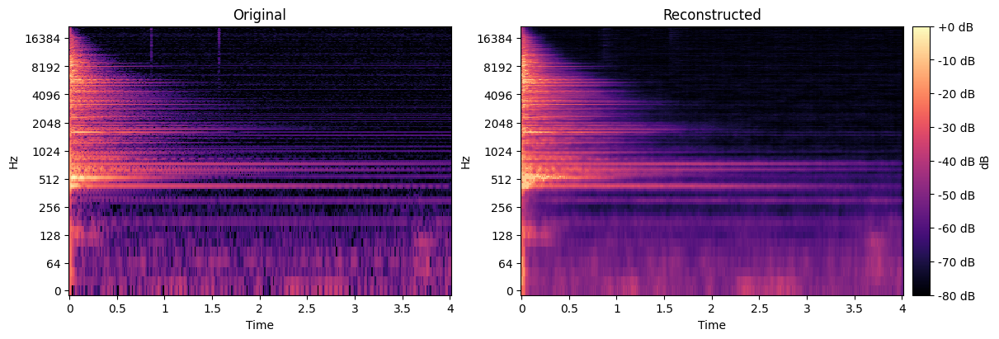

Strike 22 — reconstructed


Strike 22 — original


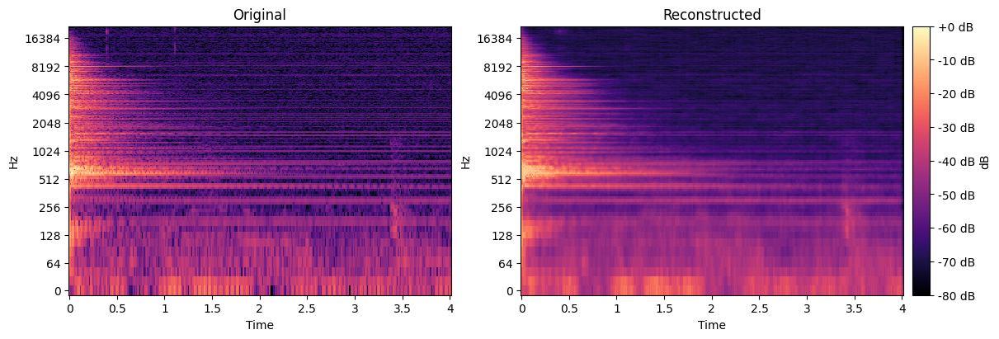

Strike 20 — reconstructed


Strike 20 — original


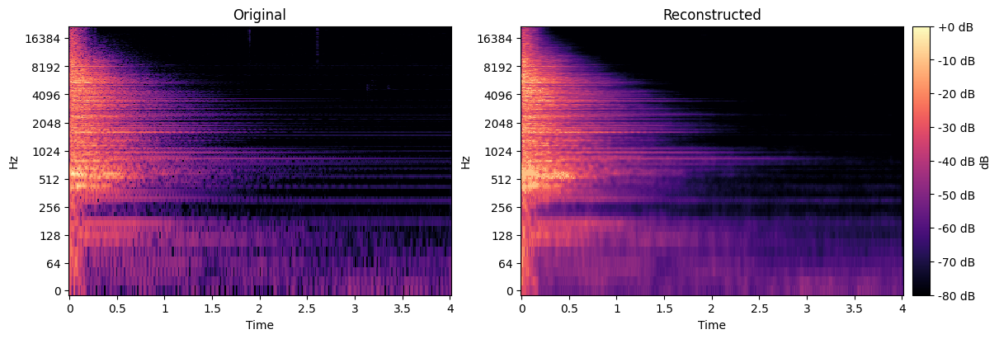

Strike 11 — reconstructed


Strike 11 — original


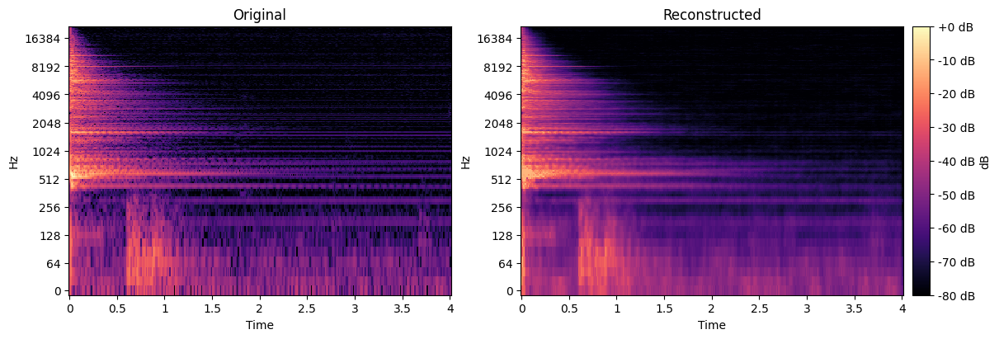

Strike 21 — reconstructed


Strike 21 — original


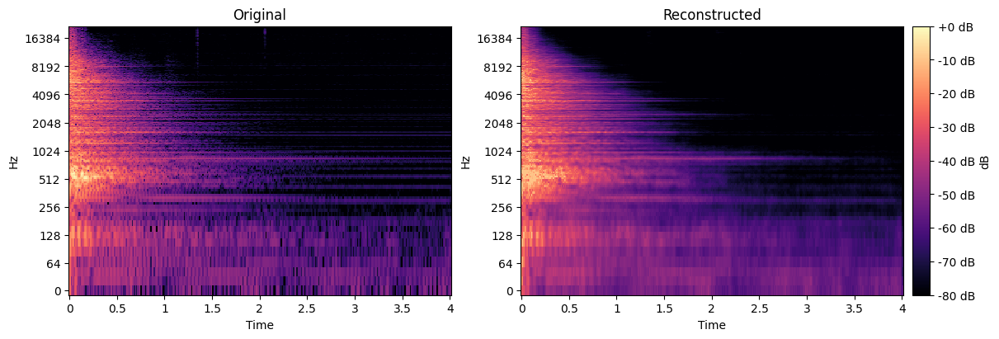

Strike 41 — reconstructed


Strike 41 — original


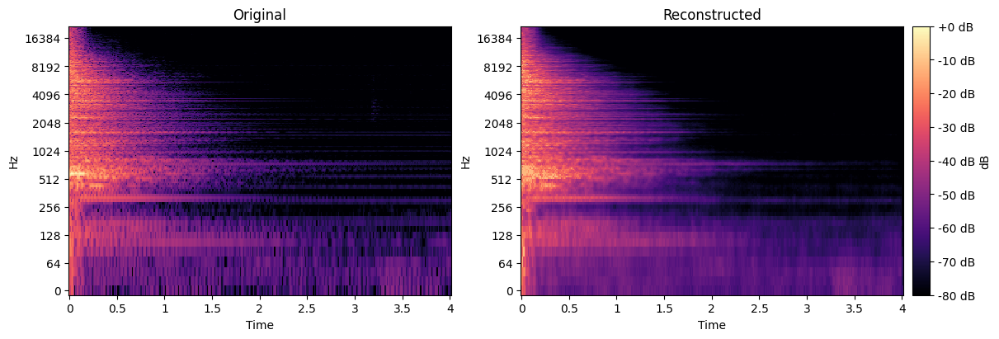

Strike 8 — reconstructed


Strike 8 — original


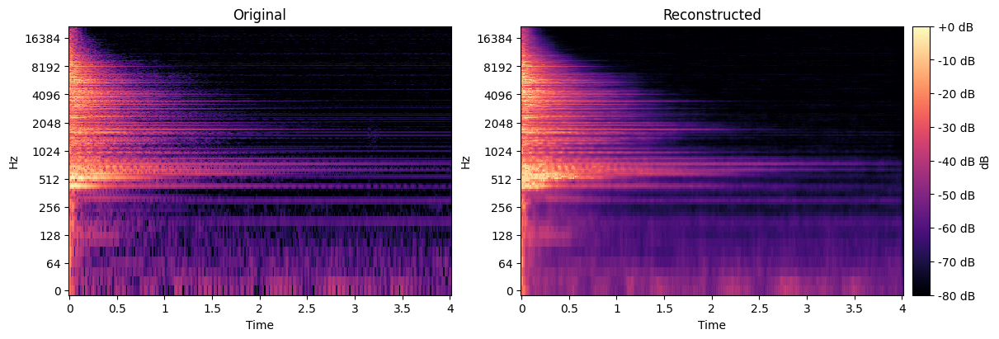

Strike 37 — reconstructed


Strike 37 — original


In [ ]:
# Show one val example
# show_idx(val_indices[0])

# Flip through a few val items
for idx in val_indices[:]:
    show_idx(idx)


In [ ]:
import time, numpy as np, torch

# Optional: a little extra speed on CUDA
torch.backends.cudnn.benchmark = True
torch.backends.cuda.matmul.allow_tf32 = True
torch.backends.cudnn.allow_tf32 = True

def get_val_z(idx, use_amp=True):
    """
    Encodes one validation item to a spatial latent map z (no grad).
    Returns z on the same device as the model.
    """
    x = x_list[idx].unsqueeze(0).to(device)  # [1,2,H,W]
    model.eval()
    with torch.no_grad(), torch.cuda.amp.autocast(enabled=(device=="cuda" and use_amp)):
        z = model.encode(x)
    return z  # [1, C, H', W']

def bench_decode(z, iters=200, warmup=50, use_amp=True, label="decode"):
    """
    Times model.decode(z). Prints p50/p90/min/max/mean in ms.
    """
    use_cuda = (device == "cuda")
    times = []

    # warmup
    with torch.no_grad():
        for _ in range(warmup):
            with torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
                _ = model.decode(z)
        if use_cuda: torch.cuda.synchronize()

    # timed runs
    with torch.no_grad():
        for _ in range(iters):
            t0 = time.perf_counter()
            with torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
                _ = model.decode(z)
            if use_cuda: torch.cuda.synchronize()
            times.append((time.perf_counter() - t0) * 1000.0)

    arr = np.array(times, dtype=np.float64)
    print(
        f"{label} only on {device} | z shape {tuple(z.shape)} | "
        f"p50={np.percentile(arr,50):.3f} ms  p90={np.percentile(arr,90):.3f} ms  "
        f"mean={arr.mean():.3f}  min={arr.min():.3f}  max={arr.max():.3f}"
    )
    return arr

def bench_forward(idx, iters=100, warmup=20, use_amp=True):
    """
    (Optional) Also measure encode+decode for the same item, for context.
    """
    x = x_list[idx].unsqueeze(0).to(device)
    use_cuda = (device == "cuda")
    times = []

    # warmup
    with torch.no_grad():
        for _ in range(warmup):
            with torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
                _ = model(x)
        if use_cuda: torch.cuda.synchronize()

    # timed
    with torch.no_grad():
        for _ in range(iters):
            t0 = time.perf_counter()
            with torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
                _ = model(x)
            if use_cuda: torch.cuda.synchronize()
            times.append((time.perf_counter() - t0) * 1000.0)

    arr = np.array(times, dtype=np.float64)
    print(
        f"forward (encode+decode) on {device} | x shape {tuple(x.shape)} | "
        f"p50={np.percentile(arr,50):.3f} ms  p90={np.percentile(arr,90):.3f} ms  "
        f"mean={arr.mean():.3f}  min={arr.min():.3f}  max={arr.max():.3f}"
    )
    return arr


In [ ]:
# e.g., first validation item
idx = val_indices[0]

# 1) get the spatial latent map for that val item
z = get_val_z(idx, use_amp=True)

# 2) time *decode only*
_ = bench_decode(z, iters=200, warmup=50, use_amp=True)

# (optional) also time full forward (encode+decode) for comparison
_ = bench_forward(idx, iters=100, warmup=20, use_amp=True)


/tmp/ipython-input-4036486074.py:15: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.no_grad(), torch.cuda.amp.autocast(enabled=(device=="cuda" and use_amp)):
/tmp/ipython-input-4036486074.py:29: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
/tmp/ipython-input-4036486074.py:37: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
/tmp/ipython-input-4036486074.py:61: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
/tmp/ipython-input-4036486074.py:69: FutureWarning: `torch.cuda.amp.autocast(args

decode only on cuda | z shape (1, 256, 132, 44) | p50=0.577 ms  p90=0.593 ms  mean=0.579  min=0.556  max=0.650
forward (encode+decode) on cuda | x shape (1, 2, 1056, 352) | p50=0.923 ms  p90=0.940 ms  mean=0.930  min=0.899  max=1.293


In [ ]:
model_cpu = model.to("cpu").eval()
device = "cpu"   # update the global device used by helpers
z_cpu = get_val_z(idx, use_amp=False)   # re-encode on CPU
_ = bench_decode(z_cpu, iters=100, warmup=20, use_amp=False, label="decode (CPU)")


/tmp/ipython-input-4036486074.py:15: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.no_grad(), torch.cuda.amp.autocast(enabled=(device=="cuda" and use_amp)):
/tmp/ipython-input-4036486074.py:29: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
/tmp/ipython-input-4036486074.py:37: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):


decode (CPU) only on cpu | z shape (1, 256, 132, 44) | p50=96.742 ms  p90=99.844 ms  mean=97.301  min=94.194  max=109.616


## Seventh Encoder: VAE


### Model

In [ ]:
# --- Imports (same as before) ---
import numpy as np
import torch, torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, random_split
from tqdm import tqdm
import math
import librosa

# =========================
# Dataset (magnitude now in [0,1] for logmag/phase)
# =========================
class STFTDataset(Dataset):
    def __init__(self, npz_path, target_multiple=32, use_log_mag_phase=False,
                 percentile=99.0, waveforms_npz=None):
        z = np.load(npz_path, allow_pickle=True)
        if "strikes_STFTs" not in z.files:
            raise KeyError(f"'strikes_STFTs' not found in {npz_path}. Keys: {z.files}")
        self.items = z["strikes_STFTs"]              # object array/list-like
        self.target_multiple = target_multiple
        self.use_log_mag_phase = use_log_mag_phase
        self.percentile = percentile

        # Optional paired waveforms
        self.waves = None
        if waveforms_npz is not None:
            w = np.load(waveforms_npz, allow_pickle=True)
            for key in ("strikes", "waveforms", "audio", "audio_recon"):
                if key in w.files:
                    self.waves = w[key]
                    break
            if self.waves is None:
                raise KeyError(f"No waveforms key in {waveforms_npz}. Keys: {w.files}")
            if len(self.waves) != len(self.items):
                raise ValueError(f"Waveform count ({len(self.waves)}) != STFT count ({len(self.items)})")

    def __len__(self):
        # Be robust to object arrays / lists
        try:
            return int(self.items.shape[0])
        except Exception:
            return len(self.items)

    def _pad_to_multiple(self, x, m):
        C, H, W = x.shape
        Hp = (m - H % m) % m
        Wp = (m - W % m) % m
        if Hp or Wp:
            x = np.pad(x, ((0,0),(0,Hp),(0,Wp)), mode="constant")
        return x

    def __getitem__(self, i):
        S = np.asarray(self.items[i], dtype=np.float32)  # [T,F,2]
        T, F, _ = S.shape

        if not self.use_log_mag_phase:
            x = np.transpose(S, (2,1,0)).astype(np.float32)  # [2,F,T]
            scale = np.percentile(np.abs(x), self.percentile)
            scale = 1.0 if scale == 0 else float(scale)
            x = np.clip(x / scale, -1.0, 1.0)
            meta = {"rep": "re_im", "orig_hw": (F, T), "scale": scale}
        else:
            S_c = S[...,0] + 1j*S[...,1]
            mag = np.log1p(np.abs(S_c)).T
            pha = np.angle(S_c).T
            mag_scale = np.percentile(mag, self.percentile)
            mag_scale = 1.0 if mag_scale == 0 else float(mag_scale)
            mag_n = np.clip(mag / mag_scale, 0.0, 1.0)
            pha_n = np.clip(pha / math.pi, -1.0, 1.0)
            x = np.stack([mag_n, pha_n], axis=0).astype(np.float32)
            meta = {"rep": "logmag_phase", "orig_hw": (F, T), "mag_scale": mag_scale}

        x = self._pad_to_multiple(x, self.target_multiple)
        x_t = torch.from_numpy(x)

        if self.waves is None:
            return x_t, meta
        y = np.asarray(self.waves[i], dtype=np.float32)  # 1D waveform
        return x_t, meta, torch.from_numpy(y)

def make_train_val_subsets(ds, val_split=0.1, seed=42):
    n = len(ds)
    n_val = max(1, int(round(n * val_split)))
    n_tr  = n - n_val
    gen = torch.Generator().manual_seed(seed)
    ds_tr, ds_val = random_split(ds, [n_tr, n_val], generator=gen)
    return ds_tr, ds_val

def pad_collate(batch):
    has_waves = (len(batch[0]) == 3)
    if has_waves:
        xs, metas, waves = zip(*batch)
    else:
        xs, metas = zip(*batch); waves = None

    C = xs[0].shape[0]
    Hmax = max(x.shape[1] for x in xs)
    Wmax = max(x.shape[2] for x in xs)
    xb = torch.zeros(len(xs), C, Hmax, Wmax, dtype=xs[0].dtype)
    for i, x in enumerate(xs):
        _, H, W = x.shape
        xb[i, :, :H, :W] = x

    return (xb, metas, list(waves)) if has_waves else (xb, metas)

# =========================
# TinyCAE with conditional heads (sigmoid mag, tanh phase)
# =========================
# =========================
# TinyVAE (logmag/phase: softplus mag, tanh phase)
# =========================
class TinyVAE(nn.Module):
    def __init__(self, in_ch=2, latent_ch=64, rep="re_im"):
        super().__init__()
        self.rep = rep  # "re_im" or "logmag_phase"

        # Encoder body (same downsampling as before)
        self.enc = nn.Sequential(
            nn.Conv2d(in_ch, 32, 3, 2, 1), nn.GELU(),
            nn.Conv2d(32, 64, 3, 2, 1),    nn.GELU(),
            nn.Conv2d(64, latent_ch, 3, 2, 1), nn.GELU()
        )
        # Heads to parameterize q(z|x) ~ N(mu, diag(sigma^2))
        self.to_mu     = nn.Conv2d(latent_ch, latent_ch, 1)
        self.to_logvar = nn.Conv2d(latent_ch, latent_ch, 1)

        # Decoder (same topology as your CAE decoder)
        self.dec_body = nn.Sequential(
            nn.ConvTranspose2d(latent_ch, 64, 4, 2, 1), nn.GELU(),
            nn.ConvTranspose2d(64, 32, 4, 2, 1),        nn.GELU(),
        )
        self.dec_out = nn.ConvTranspose2d(32, in_ch, 4, 2, 1)

    # ---- VAE bits ----
    def encode(self, x):
        h = self.enc(x)
        mu, logvar = self.to_mu(h), self.to_logvar(h)
        if self.training:
            std = torch.exp(0.5 * logvar)
            eps = torch.randn_like(std)
            z = mu + eps * std          # reparameterization
        else:
            z = mu                      # deterministic at eval
        return z, mu, logvar

    def decode(self, z):
        h = self.dec_body(z)
        y = self.dec_out(h)  # [B,2,H,W]
        if self.rep == "logmag_phase":
            mag = F.softplus(y[:, 0:1])  # ≥0
            pha = torch.tanh( y[:, 1:2]) # [-1,1]
            return torch.cat([mag, pha], dim=1)
        else:
            return torch.tanh(y)         # re/imag in [-1,1]

    def forward(self, x):
        z, mu, logvar = self.encode(x)
        recon = self.decode(z)
        return recon, mu, logvar


# =========================
# Training with floor penalty & magnitude loss (configurable)
# =========================
def train_cae(  # you can keep the name; it now trains a VAE
    npz_path,
    epochs=10,
    batch_size=8,
    lr=2e-4,
    in_ch=2,
    latent_ch=124,
    target_multiple=32,
    use_log_mag_phase=False,
    percentile=99.0,
    floor_penalty_w=0.1,
    mag_loss_w=0.2,
    quiet_threshold=0.02,
    # waveform supervision (optional)
    waveforms_npz=None,
    waveform_l1_w=0.0,
    mrstft_w=0.0,
    onset_boost_w=0.0,
    mrstft_ffts=(1024, 2048, 4096),
    mrstft_hops=(256, 512, 1024),
    # validation
    val_split=0.1,
    seed=42,
    # ---- NEW: VAE KL weight ----
    beta_kl=1e-3,   # try 1e-4 .. 1e-2; can anneal later if you want
    # sys
    num_workers=2,
    device=None,
    steps_per_epoch=None,
    ckpt_best_path="ae_best.pt", # <-- Add comma here
    # HPO hooks:
    trial=None,            # <- NEW: optuna trial (or None)
    report_every=1,        # <- NEW: report every N epochs
    ):

    import torch.nn.functional as F
    device = device or ("cuda" if torch.cuda.is_available() else "cpu")
    pin_mem = (device == "cuda")

    hdr = np.load(npz_path, allow_pickle=True)
    n_fft      = int(hdr["n_fft"])      if "n_fft" in hdr else 2048
    hop_length = int(hdr["hop_length"]) if "hop_length" in hdr else 512

    base_ds = STFTDataset(npz_path, target_multiple=target_multiple,
                          use_log_mag_phase=use_log_mag_phase,
                          percentile=percentile,
                          waveforms_npz=waveforms_npz)
    ds_tr, ds_val = make_train_val_subsets(base_ds, val_split=val_split, seed=seed)

    dl_tr  = DataLoader(ds_tr,  batch_size=batch_size, shuffle=True,  drop_last=True,
                        num_workers=num_workers, collate_fn=pad_collate, pin_memory=pin_mem)
    dl_val = DataLoader(ds_val, batch_size=batch_size, shuffle=False, drop_last=False,
                        num_workers=num_workers, collate_fn=pad_collate, pin_memory=pin_mem)

    rep = "logmag_phase" if use_log_mag_phase else "re_im"
    model = TinyVAE(in_ch=in_ch, latent_ch=latent_ch, rep=rep).to(device)
    model.hparams = {
        "in_ch": in_ch,
        "latent_ch": latent_ch,
        "rep": rep,
        "percentile": percentile,
        "target_multiple": target_multiple,
    }
    opt = torch.optim.AdamW(model.parameters(), lr=lr)
    L1  = nn.L1Loss()
    hann_main = torch.hann_window(n_fft, device=device)

    def center_pad_or_crop_1d_torch(x, L):
        n = x.shape[-1]
        if n == L: return x
        if n > L:
            s = (n - L) // 2
            return x[..., s:s+L]
        pad_left = (L - n)//2
        pad_right= L - n - pad_left
        return F.pad(x, (pad_left, pad_right))

    def mrstft_loss_time(pred_wav, true_wav):
        loss = 0.0; cnt = 0
        for N,H in zip(mrstft_ffts, mrstft_hops):
            win = torch.hann_window(N, device=pred_wav.device)
            P = torch.stft(pred_wav, n_fft=N, hop_length=H, win_length=N, window=win,
                           return_complex=True, center=True).abs()
            Tt= torch.stft(true_wav, n_fft=N, hop_length=H, win_length=N, window=win,
                           return_complex=True, center=True).abs()
            loss = loss + (P - Tt).abs().mean(); cnt += 1
        return loss / max(1, cnt)

    def base_losses(xb, metas, recon):
        # main reconstruction loss in representation space
        loss = L1(recon, xb)

        # magnitude helpers
        if use_log_mag_phase:
            true_mag = xb[:,0]        # [B,H,W], 0..1
            pred_mag = recon[:,0]     # ≥0 (softplus), not clamped
        else:
            true_mag = torch.sqrt(xb[:,0]**2 + xb[:,1]**2 + 1e-8).clamp(0,1)
            pred_mag = torch.sqrt(recon[:,0]**2 + recon[:,1]**2 + 1e-8).clamp(0,1)

        if floor_penalty_w > 0:
            mask = (true_mag < quiet_threshold).float()
            loss = loss + floor_penalty_w * (pred_mag * mask).mean()

        if mag_loss_w > 0:
            loss = loss + mag_loss_w * L1(pred_mag, true_mag)

        return loss

    history = {"train": [], "val": []}
    best_val = float("inf")

    for epoch in range(1, epochs+1):
        # ---------- Train ----------
        model.train()
        run = 0.0
        pbar = tqdm(dl_tr, desc=f"Epoch {epoch}/{epochs}", leave=False)
        for i, batch in enumerate(pbar, start=1):
            has_waves = (len(batch) == 3)
            xb, metas = (batch[0], batch[1]) if not has_waves else (batch[0], batch[1])
            waves = None if not has_waves else batch[2]

            xb = xb.to(device, non_blocking=pin_mem)

            # VAE forward
            recon, mu, logvar = model(xb)

            # Recon-related losses
            loss = base_losses(xb, metas, recon)

            # Optional waveform-domain losses
            if (waveform_l1_w>0 or mrstft_w>0 or onset_boost_w>0) and waves is not None:
                for b in range(xb.size(0)):
                    meta = metas[b]; F0,T0 = meta["orig_hw"]
                    if rep == "logmag_phase":
                        mag_scale = torch.tensor(meta["mag_scale"], device=device, dtype=xb.dtype)
                        mag_n = recon[b,0,:F0,:T0].clamp_min(0)
                        phi_n = recon[b,1,:F0,:T0].clamp(-1,1)
                        mag   = torch.expm1(mag_n * mag_scale)
                        phi   = phi_n * math.pi
                        real  = mag * torch.cos(phi); imag = mag * torch.sin(phi)
                    else:
                        real = recon[b,0,:F0,:T0].clamp(-1,1) * meta["scale"]
                        imag = recon[b,1,:F0,:T0].clamp(-1,1) * meta["scale"]

                    S_pred = torch.complex(real, imag)
                    wav_pred = torch.istft(S_pred, n_fft=n_fft, hop_length=hop_length,
                                           win_length=n_fft, window=hann_main, center=True)
                    y_true = waves[b].to(device)

                    L = min(wav_pred.numel(), y_true.numel())
                    wav_pred_c = center_pad_or_crop_1d_torch(wav_pred, L)
                    y_true_c   = center_pad_or_crop_1d_torch(y_true, L)

                    if waveform_l1_w > 0:
                        loss = loss + waveform_l1_w * L1(wav_pred_c, y_true_c)
                    if onset_boost_w > 0:
                        idx = torch.argmax(y_true_c.abs())
                        Tlen = y_true_c.numel()
                        grid = torch.arange(Tlen, device=device, dtype=y_true_c.dtype)
                        sigma = 0.015 * Tlen
                        w = torch.exp(-0.5 * ((grid - idx) / (sigma + 1e-6))**2)
                        w = w / (w.mean() + 1e-6)
                        loss = loss + onset_boost_w * (w * (wav_pred_c - y_true_c).abs()).mean()
                    if mrstft_w > 0:
                        loss = loss + mrstft_w * mrstft_loss_time(wav_pred_c, y_true_c)

            # ---- VAE KL term ----
            # KL(q(z|x) || N(0,I)) = -0.5 * sum(1 + logσ² - μ² - σ²)
            kl = -0.5 * torch.mean(1 + logvar - mu.pow(2) - logvar.exp())
            loss = loss + beta_kl * kl

            opt.zero_grad(set_to_none=True)
            loss.backward()
            opt.step()

            run += loss.item()
            pbar.set_postfix({"train_L": f"{loss.item():.4f}"})
            if steps_per_epoch and i >= steps_per_epoch:
                break

        train_avg = run / (i if i else 1)
        history["train"].append(train_avg)

        # ---------- Validate ----------
        model.eval()
        vrun = 0.0
        with torch.no_grad():
            for batch in dl_val:
                has_waves = (len(batch) == 3)
                xb, metas = (batch[0], batch[1]) if not has_waves else (batch[0], batch[1])
                waves = None if not has_waves else batch[2]

                xb = xb.to(device, non_blocking=pin_mem)

                # deterministic (z=mu) at eval by encode()
                recon, mu, logvar = model(xb)

                vloss = base_losses(xb, metas, recon)

                if (waveform_l1_w>0 or mrstft_w>0 or onset_boost_w>0) and waves is not None:
                    for b in range(xb.size(0)):
                        meta = metas[b]; F0,T0 = meta["orig_hw"]
                        if rep == "logmag_phase":
                            mag_scale = torch.tensor(meta["mag_scale"], device=device, dtype=xb.dtype)
                            mag_n = recon[b,0,:F0,:T0].clamp_min(0)
                            phi_n = recon[b,1,:F0,:T0].clamp(-1,1)
                            mag   = torch.expm1(mag_n * mag_scale)
                            phi   = phi_n * math.pi
                            real  = mag * torch.cos(phi); imag = mag * torch.sin(phi)
                        else:
                            real = recon[b,0,:F0,:T0].clamp(-1,1) * meta["scale"]
                            imag = recon[b,1,:F0,:T0].clamp(-1,1) * meta["scale"]

                        S_pred = torch.complex(real, imag)
                        wav_pred = torch.istft(S_pred, n_fft=n_fft, hop_length=hop_length,
                                               win_length=n_fft, window=hann_main, center=True)
                        y_true = waves[b].to(device)

                        L = min(wav_pred.numel(), y_true.numel())
                        wav_pred_c = center_pad_or_crop_1d_torch(wav_pred, L)
                        y_true_c   = center_pad_or_crop_1d_torch(y_true, L)

                        if waveform_l1_w > 0:
                            vloss = vloss + waveform_l1_w * L1(wav_pred_c, y_true_c)
                        if onset_boost_w > 0:
                            idx = torch.argmax(y_true_c.abs())
                            Tlen = y_true_c.numel()
                            grid = torch.arange(Tlen, device=device, dtype=y_true_c.dtype)
                            sigma = 0.015 * Tlen
                            w = torch.exp(-0.5 * ((grid - idx) / (sigma + 1e-6))**2)
                            w = w / (w.mean() + 1e-6)
                            vloss = vloss + onset_boost_w * (w * (wav_pred_c - y_true_c).abs()).mean()
                        if mrstft_w > 0:
                            vloss = vloss + mrstft_w * mrstft_loss_time(wav_pred_c, y_true_c)

                # KL at eval (still encourage posteriors to stay near prior)
                kl = -0.5 * torch.mean(1 + logvar - mu.pow(2) - logvar.exp())
                vloss = vloss + beta_kl * kl

                vrun += vloss.item()

        val_avg = vrun / max(1, len(dl_val))
        history["val"].append(val_avg)
        print(f"Epoch {epoch}: train={train_avg:.4f}  val={val_avg:.4f}")

        # ---- NEW: Optuna reporting/pruning ----
        if trial is not None and (epoch % report_every == 0):
            trial.report(val_avg, epoch)
            if trial.should_prune():
                raise optuna.TrialPruned()
        # ---------------------------------------

        if val_avg < best_val:
            best_val = val_avg
            torch.save(model.state_dict(), ckpt_best_path)

    print(f"Best val loss: {best_val:.4f} (saved to {ckpt_best_path})")
    return model, history

### Model Execution

In [ ]:
model, hist = train_cae(
    npz_path="ML_Data_complex/strikes_STFTs.npz",
    waveforms_npz="ML_Data_complex/strikes_waveforms.npz",
    epochs=300, batch_size=1, lr=1.8e-3,
    in_ch=2, latent_ch=256,
    target_multiple=16,
    use_log_mag_phase=True,
    percentile=99.98,
    floor_penalty_w=0.1, mag_loss_w=0.3, quiet_threshold=0.01,
    waveform_l1_w=0.2, mrstft_w=0.2, onset_boost_w=0.1,
    val_split=0.15, seed=123,
    beta_kl=1e-3,                 # <-- new
    ckpt_best_path="ae_best.pt",
)


### Hyper-Parameter Optimization

In [ ]:
import optuna
from optuna.pruners import MedianPruner
from optuna.samplers import TPESampler
import tempfile, os

STFT_NPZ = "ML_Data_complex/strikes_STFTs.npz"
WAVE_NPZ = "ML_Data_complex/strikes_waveforms.npz"  # optional

SEED = 123
VAL_SPLIT = 0.15

def objective(trial: optuna.trial.Trial):
    # --- search space (tweak as you like) ---
    latent_ch      = trial.suggest_categorical("latent_ch", [128, 192, 256, 320])
    lr             = trial.suggest_float("lr", 3e-4, 5e-3, log=True)
    beta_kl        = trial.suggest_float("beta_kl", 1e-4, 3e-3, log=True)
    percentile     = trial.suggest_float("percentile", 99.6, 99.99)
    floor_w        = trial.suggest_float("floor_penalty_w", 0.05, 0.3)
    mag_w          = trial.suggest_float("mag_loss_w", 0.0, 0.4)
    quiet_thresh   = trial.suggest_float("quiet_threshold", 0.005, 0.05)
    w_l1           = trial.suggest_categorical("waveform_l1_w", [0.0, 0.1, 0.2])
    w_mrstft       = trial.suggest_categorical("mrstft_w", [0.0, 0.1, 0.2])
    w_onset        = trial.suggest_categorical("onset_boost_w", [0.0, 0.05, 0.1])

    # small-ish search budget; crank up later
    epochs = 60
    batch_size = 1

    # unique checkpoint per trial, cleaned automatically
    with tempfile.TemporaryDirectory() as tmp:
        ckpt = os.path.join(tmp, f"ae_best_t{trial.number}.pt")

        try:
            model, hist = train_cae(
                npz_path=STFT_NPZ,
                waveforms_npz=WAVE_NPZ,
                epochs=epochs, batch_size=batch_size, lr=lr,
                in_ch=2, latent_ch=latent_ch,
                target_multiple=32,
                use_log_mag_phase=True,
                percentile=percentile,
                floor_penalty_w=floor_w,
                mag_loss_w=mag_w,
                quiet_threshold=quiet_thresh,
                waveform_l1_w=w_l1, mrstft_w=w_mrstft, onset_boost_w=w_onset,
                val_split=VAL_SPLIT, seed=SEED,
                beta_kl=beta_kl,
                # HPO hooks
                trial=trial, report_every=1,
                ckpt_best_path=ckpt,
                # speed/determinism tips:
                num_workers=0,            # reproducible, avoids Windows spawn overhead
                # steps_per_epoch=200,    # (optional) cap steps for faster trials
            )
        except optuna.TrialPruned:
            raise
        except Exception as e:
            # Fail-safe: if a combo explodes, signal a bad value
            return float("inf")

    # Use the best validation loss seen during training
    return float(min(hist["val"]))


In [ ]:
study = optuna.create_study(
    direction="minimize",
    sampler=TPESampler(seed=SEED),
    pruner=MedianPruner(n_startup_trials=8, n_warmup_steps=5),  # prune after a few epochs
)

study.optimize(objective, n_trials=30, gc_after_trial=True)
print("Best value:", study.best_value)
print("Best params:", study.best_params)


[I 2025-09-19 23:27:59,826] A new study created in memory with name: no-name-546d9aa5-584d-4fea-aa53-28dc05a77e35


Epoch 1: train=0.7826  val=0.6114


Epoch 2: train=0.4629  val=0.3764


Epoch 3: train=0.3643  val=0.3532


Epoch 4: train=0.3540  val=0.3484


Epoch 5: train=0.3536  val=0.3489


Epoch 6: train=0.3587  val=0.3593


Epoch 7: train=0.3503  val=0.3406


Epoch 8: train=0.3413  val=0.3381


Epoch 9: train=0.3340  val=0.3274


Epoch 10: train=0.3252  val=0.3170


Epoch 11: train=0.3136  val=0.3036


Epoch 12: train=0.3002  val=0.2911


Epoch 13: train=0.2858  val=0.2748


Epoch 14: train=0.2761  val=0.2768


Epoch 15: train=0.2659  val=0.2575


Epoch 16: train=0.2621  val=0.2599


Epoch 17: train=0.2582  val=0.2525


Epoch 18: train=0.2527  val=0.2482


Epoch 19: train=0.2536  val=0.2581


Epoch 20: train=0.2562  val=0.2436


Epoch 21: train=0.2454  val=0.2445


Epoch 22: train=0.2397  val=0.2331


Epoch 23: train=0.2417  val=0.2681


Epoch 24: train=0.2521  val=0.2335


Epoch 25: train=0.2284  val=0.2212


Epoch 26: train=0.2214  val=0.2162


Epoch 27: train=0.2214  val=0.2183


Epoch 28: train=0.2192  val=0.2107


Epoch 29: train=0.2109  val=0.2205


Epoch 30: train=0.2099  val=0.2070


Epoch 31: train=0.2118  val=0.2054


Epoch 32: train=0.2025  val=0.1982


Epoch 33: train=0.2285  val=0.2141


Epoch 34: train=0.2033  val=0.2423


Epoch 35: train=0.2081  val=0.1966


Epoch 36: train=0.1944  val=0.1898


Epoch 37: train=0.2147  val=0.2043


Epoch 38: train=0.1969  val=0.1892


Epoch 39: train=0.2175  val=0.2227


Epoch 40: train=0.2012  val=0.1919


Epoch 41: train=0.1892  val=0.1908


Epoch 42: train=0.1820  val=0.1791


Epoch 43: train=0.1769  val=0.1797


Epoch 44: train=0.1747  val=0.1747


Epoch 45: train=0.1723  val=0.1758


Epoch 46: train=0.1850  val=0.1758


Epoch 47: train=0.1739  val=0.1735


Epoch 48: train=0.1680  val=0.1723


Epoch 49: train=0.1707  val=0.1681


Epoch 50: train=0.1708  val=0.1673


Epoch 51: train=0.1615  val=0.1646


Epoch 52: train=0.1603  val=0.1671


Epoch 53: train=0.1595  val=0.1615


Epoch 54: train=0.1549  val=0.1593


Epoch 55: train=0.1533  val=0.1591


Epoch 56: train=0.1510  val=0.1567


Epoch 57: train=0.1515  val=0.1609


Epoch 58: train=0.1501  val=0.1561


Epoch 59: train=0.1492  val=0.1568


Epoch 60: train=0.1473  val=0.1538
Best val loss: 0.1538 (saved to /tmp/tmp2isbim2v/ae_best_t0.pt)


[I 2025-09-19 23:30:19,484] Trial 0 finished with value: 0.15383952536753245 and parameters: {'latent_ch': 128, 'lr': 0.0022709287882831802, 'beta_kl': 0.00042167664250477427, 'percentile': 99.98249803737, 'floor_penalty_w': 0.22120743464621584, 'mag_loss_w': 0.1923727605937444, 'quiet_threshold': 0.022645288318736776, 'waveform_l1_w': 0.1, 'mrstft_w': 0.2, 'onset_boost_w': 0.1}. Best is trial 0 with value: 0.15383952536753245.


Epoch 1: train=0.5126  val=0.3398


Epoch 2: train=0.3355  val=0.3394


Epoch 3: train=0.3343  val=0.3301


Epoch 4: train=0.3251  val=0.3191


Epoch 5: train=0.3273  val=0.3233


Epoch 6: train=0.3205  val=0.3131


Epoch 7: train=0.3090  val=0.3008


Epoch 8: train=0.2901  val=0.2791


Epoch 9: train=0.2728  val=0.2621


Epoch 10: train=0.2556  val=0.2434


Epoch 11: train=0.2562  val=0.2557


Epoch 12: train=0.2434  val=0.2333


Epoch 13: train=0.2333  val=0.2279


Epoch 14: train=0.2292  val=0.2241


Epoch 15: train=0.2232  val=0.2181


Epoch 16: train=0.2171  val=0.2115


Epoch 17: train=0.2134  val=0.2156


Epoch 18: train=0.2091  val=0.2010


Epoch 19: train=0.2008  val=0.1953


Epoch 20: train=0.1994  val=0.1923


Epoch 21: train=0.1918  val=0.1959


Epoch 22: train=0.1911  val=0.1844


Epoch 23: train=0.1883  val=0.1818


Epoch 24: train=0.1827  val=0.1765


Epoch 25: train=0.1764  val=0.1736


Epoch 26: train=0.1752  val=0.1843


Epoch 27: train=0.1999  val=0.1846


Epoch 28: train=0.1792  val=0.1671


Epoch 29: train=0.1653  val=0.1606


Epoch 30: train=0.1758  val=0.2263


Epoch 31: train=0.1835  val=0.1615


Epoch 32: train=0.1592  val=0.1531


Epoch 33: train=0.1545  val=0.1495


Epoch 34: train=0.1508  val=0.1479


Epoch 35: train=0.1470  val=0.1429


Epoch 36: train=0.1461  val=0.1562


Epoch 37: train=0.1548  val=0.1458


Epoch 38: train=0.1425  val=0.1371


Epoch 39: train=0.1441  val=0.1420


Epoch 40: train=0.1369  val=0.1304


Epoch 41: train=0.1328  val=0.1530


Epoch 42: train=0.1322  val=0.1283


Epoch 43: train=0.1380  val=0.1355


Epoch 44: train=0.1309  val=0.1322


Epoch 45: train=0.1284  val=0.1291


Epoch 46: train=0.1249  val=0.1234


Epoch 47: train=0.1490  val=0.1680


Epoch 48: train=0.1654  val=0.1599


Epoch 49: train=0.1608  val=0.1564


Epoch 50: train=0.1577  val=0.1517


Epoch 51: train=0.1522  val=0.1995


Epoch 52: train=0.1460  val=0.1229


Epoch 53: train=0.1199  val=0.1176


Epoch 54: train=0.1194  val=0.1288


Epoch 55: train=0.1173  val=0.1147


Epoch 56: train=0.1122  val=0.1171


Epoch 57: train=0.1211  val=0.1100


Epoch 58: train=0.1101  val=0.1141


Epoch 59: train=0.1097  val=0.1076


Epoch 60: train=0.1108  val=0.1140
Best val loss: 0.1076 (saved to /tmp/tmp0t1yrkf3/ae_best_t1.pt)


[I 2025-09-19 23:32:39,297] Trial 1 finished with value: 0.10757135174104146 and parameters: {'latent_ch': 256, 'lr': 0.0016737845980814192, 'beta_kl': 0.0011671763410683598, 'percentile': 99.72595397640274, 'floor_penalty_w': 0.14044716390557854, 'mag_loss_w': 0.09130529235158225, 'quiet_threshold': 0.018217132087497322, 'waveform_l1_w': 0.0, 'mrstft_w': 0.1, 'onset_boost_w': 0.1}. Best is trial 1 with value: 0.10757135174104146.


Epoch 1: train=0.4480  val=0.3038


Epoch 2: train=0.3032  val=0.2956


Epoch 3: train=0.2970  val=0.2950


Epoch 4: train=0.2943  val=0.2937


Epoch 5: train=0.2906  val=0.2900


Epoch 6: train=0.2869  val=0.2860


Epoch 7: train=0.2790  val=0.2767


Epoch 8: train=0.2703  val=0.2680


Epoch 9: train=0.2588  val=0.2523


Epoch 10: train=0.2436  val=0.2363


Epoch 11: train=0.2285  val=0.2210


Epoch 12: train=0.2165  val=0.2091


Epoch 13: train=0.2075  val=0.2032


Epoch 14: train=0.2038  val=0.2003


Epoch 15: train=0.2004  val=0.1968


Epoch 16: train=0.1969  val=0.1925


Epoch 17: train=0.1921  val=0.1891


Epoch 18: train=0.1907  val=0.1858


Epoch 19: train=0.1853  val=0.1816


Epoch 20: train=0.1848  val=0.1798


Epoch 21: train=0.1790  val=0.1751


Epoch 22: train=0.1747  val=0.1715


Epoch 23: train=0.1761  val=0.1699


Epoch 24: train=0.1697  val=0.1655


Epoch 25: train=0.1657  val=0.1624


Epoch 26: train=0.1625  val=0.1594


Epoch 27: train=0.1625  val=0.1613


Epoch 28: train=0.1595  val=0.1558


Epoch 29: train=0.1563  val=0.1538


Epoch 30: train=0.1535  val=0.1509


Epoch 31: train=0.1547  val=0.1502


Epoch 32: train=0.1503  val=0.1472


Epoch 33: train=0.1503  val=0.1466


Epoch 34: train=0.1472  val=0.1439


Epoch 35: train=0.1445  val=0.1415


Epoch 36: train=0.1437  val=0.1407


Epoch 37: train=0.1410  val=0.1378


Epoch 38: train=0.1395  val=0.1418


Epoch 39: train=0.1383  val=0.1348


Epoch 40: train=0.1365  val=0.1339


Epoch 41: train=0.1640  val=0.1454


Epoch 42: train=0.1413  val=0.1359


Epoch 43: train=0.1361  val=0.1339


Epoch 44: train=0.1338  val=0.1320


Epoch 45: train=0.1318  val=0.1296


Epoch 46: train=0.1311  val=0.1303


Epoch 47: train=0.1310  val=0.1293


Epoch 48: train=0.1292  val=0.1277


Epoch 49: train=0.1279  val=0.1267


Epoch 50: train=0.1278  val=0.1267


Epoch 51: train=0.1261  val=0.1259


Epoch 52: train=0.1252  val=0.1258


Epoch 53: train=0.1238  val=0.1236


Epoch 54: train=0.1231  val=0.1240


Epoch 55: train=0.1263  val=0.1219


Epoch 56: train=0.1221  val=0.1200


Epoch 57: train=0.1217  val=0.1203


Epoch 58: train=0.1211  val=0.1193


Epoch 59: train=0.1195  val=0.1187


Epoch 60: train=0.1181  val=0.1175
Best val loss: 0.1175 (saved to /tmp/tmpobu5w_xk/ae_best_t2.pt)


[I 2025-09-19 23:34:51,624] Trial 2 finished with value: 0.11750704156500953 and parameters: {'latent_ch': 128, 'lr': 0.0007324805952996749, 'beta_kl': 0.00040996673076469723, 'percentile': 99.9378605715745, 'floor_penalty_w': 0.11261384134912668, 'mag_loss_w': 0.19321370570508176, 'quiet_threshold': 0.049350190352481726, 'waveform_l1_w': 0.1, 'mrstft_w': 0.0, 'onset_boost_w': 0.1}. Best is trial 1 with value: 0.10757135174104146.


Epoch 1: train=0.4705  val=0.3065


Epoch 2: train=0.2974  val=0.2993


Epoch 3: train=0.2915  val=0.2908


Epoch 4: train=0.2892  val=0.2927


Epoch 5: train=0.2833  val=0.2867


Epoch 6: train=0.2787  val=0.2724


Epoch 7: train=0.2659  val=0.2605


Epoch 8: train=0.2514  val=0.2405


Epoch 9: train=0.2324  val=0.2222


Epoch 10: train=0.2109  val=0.2032


Epoch 11: train=0.1983  val=0.1959


Epoch 12: train=0.2412  val=0.2240


Epoch 13: train=0.2075  val=0.1981


Epoch 14: train=0.2003  val=0.1966


Epoch 15: train=0.1926  val=0.1897


Epoch 16: train=0.1884  val=0.1855


Epoch 17: train=0.1830  val=0.1816


Epoch 18: train=0.1840  val=0.1774


Epoch 19: train=0.1763  val=0.1735


Epoch 20: train=0.1704  val=0.1681


Epoch 21: train=0.1666  val=0.1651


Epoch 22: train=0.1622  val=0.1579


Epoch 23: train=0.1570  val=0.1567


Epoch 24: train=0.1784  val=0.1638


Epoch 25: train=0.1547  val=0.1498


Epoch 26: train=0.1493  val=0.1459


Epoch 27: train=0.1448  val=0.1440


Epoch 28: train=0.1393  val=0.1403


Epoch 29: train=0.1336  val=0.1303


Epoch 30: train=0.1270  val=0.1258


Epoch 31: train=0.1261  val=0.1276


Epoch 32: train=0.1272  val=0.1155


Epoch 33: train=0.1141  val=0.1121


Epoch 34: train=0.1213  val=0.1102


Epoch 35: train=0.1081  val=0.1055


Epoch 36: train=0.1183  val=0.1080


Epoch 37: train=0.1042  val=0.1010


Epoch 38: train=0.0993  val=0.0963


Epoch 39: train=0.0970  val=0.0949


Epoch 40: train=0.0977  val=0.1367


Epoch 41: train=0.1026  val=0.0945


Epoch 42: train=0.0932  val=0.0932


Epoch 43: train=0.0903  val=0.0916


Epoch 44: train=0.0895  val=0.0940


Epoch 45: train=0.0905  val=0.1105


Epoch 46: train=0.0957  val=0.0855


Epoch 47: train=0.0860  val=0.0848


Epoch 48: train=0.0811  val=0.0791


Epoch 49: train=0.0892  val=0.0845


Epoch 50: train=0.0807  val=0.0781


Epoch 51: train=0.0796  val=0.0820


Epoch 52: train=0.0776  val=0.0755


Epoch 53: train=0.0762  val=0.0727


Epoch 54: train=0.0726  val=0.0713


Epoch 55: train=0.0768  val=0.0756


Epoch 56: train=0.0722  val=0.0696


Epoch 57: train=0.0694  val=0.0678


Epoch 58: train=0.0669  val=0.0698


Epoch 59: train=0.0681  val=0.0687


Epoch 60: train=0.0665  val=0.0674
Best val loss: 0.0674 (saved to /tmp/tmpvgjxea2j/ae_best_t3.pt)


[I 2025-09-19 23:37:10,979] Trial 3 finished with value: 0.06737173614757401 and parameters: {'latent_ch': 192, 'lr': 0.0015597216439797762, 'beta_kl': 0.0008376416143006977, 'percentile': 99.86312872988525, 'floor_penalty_w': 0.2605856094050643, 'mag_loss_w': 0.033277995332975506, 'quiet_threshold': 0.03936572786495022, 'waveform_l1_w': 0.2, 'mrstft_w': 0.1, 'onset_boost_w': 0.0}. Best is trial 3 with value: 0.06737173614757401.


Epoch 1: train=0.6136  val=0.3887


Epoch 2: train=0.3650  val=0.3533


Epoch 3: train=0.3476  val=0.3509


Epoch 4: train=0.3460  val=0.3439


Epoch 5: train=0.3392  val=0.3393


Epoch 6: train=0.3353  val=0.3325


Epoch 7: train=0.3336  val=0.3313


Epoch 8: train=0.3288  val=0.3245


Epoch 9: train=0.3241  val=0.3230


Epoch 10: train=0.3177  val=0.3110


Epoch 11: train=0.3069  val=0.2979


Epoch 12: train=0.2912  val=0.2809


Epoch 13: train=0.2746  val=0.2643


Epoch 14: train=0.2613  val=0.2625


Epoch 15: train=0.2525  val=0.2479


Epoch 16: train=0.2507  val=0.2456


Epoch 17: train=0.2415  val=0.2374


Epoch 18: train=0.2374  val=0.2359


Epoch 19: train=0.2317  val=0.2276


Epoch 20: train=0.2360  val=0.2417


Epoch 21: train=0.2326  val=0.2243


Epoch 22: train=0.2226  val=0.2190


Epoch 23: train=0.2177  val=0.2146


Epoch 24: train=0.2142  val=0.2119


Epoch 25: train=0.2108  val=0.2078


Epoch 26: train=0.2063  val=0.2035


Epoch 27: train=0.2024  val=0.2010


Epoch 28: train=0.1992  val=0.1987


Epoch 29: train=0.1944  val=0.1934


Epoch 30: train=0.1950  val=0.1895


Epoch 31: train=0.1862  val=0.1857


Epoch 32: train=0.1937  val=0.1927


Epoch 33: train=0.1841  val=0.1904


Epoch 34: train=0.1947  val=0.1811


Epoch 35: train=0.1757  val=0.1717


Epoch 36: train=0.1711  val=0.1659


Epoch 37: train=0.1721  val=0.1665


Epoch 38: train=0.1642  val=0.1596


Epoch 39: train=0.1625  val=0.1587


Epoch 40: train=0.1618  val=0.1645


Epoch 41: train=0.1550  val=0.1520


Epoch 42: train=0.1668  val=0.1518


Epoch 43: train=0.1538  val=0.1520


Epoch 44: train=0.1533  val=0.1551


Epoch 45: train=0.1496  val=0.1443


Epoch 46: train=0.1432  val=0.1445


Epoch 47: train=0.1387  val=0.1358


Epoch 48: train=0.1366  val=0.1357


Epoch 49: train=0.1354  val=0.1379


Epoch 50: train=0.1326  val=0.1330


Epoch 51: train=0.1478  val=0.1386


Epoch 52: train=0.1314  val=0.1303


Epoch 53: train=0.1285  val=0.1315


Epoch 54: train=0.1284  val=0.1403


Epoch 55: train=0.1289  val=0.1297


Epoch 56: train=0.1281  val=0.1261


Epoch 57: train=0.1242  val=0.1276


Epoch 58: train=0.1265  val=0.1269


Epoch 59: train=0.1219  val=0.1242


Epoch 60: train=0.1219  val=0.1200
Best val loss: 0.1200 (saved to /tmp/tmp2f4ntnnv/ae_best_t4.pt)


[I 2025-09-19 23:39:32,247] Trial 4 finished with value: 0.12001980521849223 and parameters: {'latent_ch': 320, 'lr': 0.0007355388462676616, 'beta_kl': 0.001052262348950396, 'percentile': 99.81620946738992, 'floor_penalty_w': 0.14723764353078617, 'mag_loss_w': 0.3700529958455945, 'quiet_threshold': 0.042875149861072236, 'waveform_l1_w': 0.0, 'mrstft_w': 0.2, 'onset_boost_w': 0.05}. Best is trial 3 with value: 0.06737173614757401.


Epoch 1: train=0.4423  val=0.3044


Epoch 2: train=0.3005  val=0.2938


Epoch 3: train=0.2948  val=0.2933


Epoch 4: train=0.2929  val=0.2922


Epoch 5: train=0.2909  val=0.2899


Epoch 6: train=0.2873  val=0.2868


Epoch 7: train=0.2830  val=0.2790


Epoch 8: train=0.2734  val=0.2691


Epoch 9: train=0.2653  val=0.2621


Epoch 10: train=0.2572  val=0.2507


Epoch 11: train=0.2429  val=0.2314


Epoch 12: train=0.2260  val=0.2177


Epoch 13: train=0.2145  val=0.2077


Epoch 14: train=0.2070  val=0.2024


Epoch 15: train=0.2027  val=0.1993


Epoch 16: train=0.2002  val=0.1963


Epoch 17: train=0.1959  val=0.1912


Epoch 18: train=0.1924  val=0.1916


Epoch 19: train=0.1889  val=0.1832


Epoch 20: train=0.1831  val=0.1785


Epoch 21: train=0.1787  val=0.1753


Epoch 22: train=0.1752  val=0.1715


Epoch 23: train=0.1717  val=0.1678


Epoch 24: train=0.1683  val=0.1662


Epoch 25: train=0.1659  val=0.1623


Epoch 26: train=0.1811  val=0.1757


Epoch 27: train=0.1733  val=0.1678


Epoch 28: train=0.1658  val=0.1598


Epoch 29: train=0.1599  val=0.1565


Epoch 30: train=0.1571  val=0.1536


Epoch 31: train=0.1547  val=0.1510


Epoch 32: train=0.1523  val=0.1493


Epoch 33: train=0.1503  val=0.1477


Epoch 34: train=0.1521  val=0.1573


Epoch 35: train=0.1517  val=0.1456


Epoch 36: train=0.1462  val=0.1422


Epoch 37: train=0.1433  val=0.1391


Epoch 38: train=0.1408  val=0.1374


Epoch 39: train=0.1384  val=0.1355


Epoch 40: train=0.1372  val=0.1358


Epoch 41: train=0.1354  val=0.1329


Epoch 42: train=0.1335  val=0.1305


Epoch 43: train=0.1315  val=0.1289


Epoch 44: train=0.1304  val=0.1279


Epoch 45: train=0.1287  val=0.1274


Epoch 46: train=0.1280  val=0.1256


Epoch 47: train=0.1268  val=0.1232


Epoch 48: train=0.1245  val=0.1232


Epoch 49: train=0.1291  val=0.1266


Epoch 50: train=0.1244  val=0.1220


Epoch 51: train=0.1233  val=0.1222


Epoch 52: train=0.1214  val=0.1217


Epoch 53: train=0.1198  val=0.1224


Epoch 54: train=0.1408  val=0.1602


Epoch 55: train=0.1440  val=0.1328


Epoch 56: train=0.1310  val=0.1260


Epoch 57: train=0.1259  val=0.1215


Epoch 58: train=0.1225  val=0.1196


Epoch 59: train=0.1208  val=0.1183


Epoch 60: train=0.1193  val=0.1176
Best val loss: 0.1176 (saved to /tmp/tmpq27dproi/ae_best_t5.pt)


[I 2025-09-19 23:41:45,004] Trial 5 finished with value: 0.11758129617997579 and parameters: {'latent_ch': 128, 'lr': 0.0007884470925674822, 'beta_kl': 0.000572733390017342, 'percentile': 99.85998357456398, 'floor_penalty_w': 0.07647712126420346, 'mag_loss_w': 0.0523579802656323, 'quiet_threshold': 0.019489127291073865, 'waveform_l1_w': 0.1, 'mrstft_w': 0.0, 'onset_boost_w': 0.1}. Best is trial 3 with value: 0.06737173614757401.


Epoch 1: train=0.7060  val=0.3775


Epoch 2: train=0.3513  val=0.3240


Epoch 3: train=0.3035  val=0.2928


Epoch 4: train=0.2920  val=0.2890


Epoch 5: train=0.2898  val=0.2879


Epoch 6: train=0.2881  val=0.2863


Epoch 7: train=0.2871  val=0.2851


Epoch 8: train=0.2851  val=0.2830


Epoch 9: train=0.2828  val=0.2807


Epoch 10: train=0.2814  val=0.2793


Epoch 11: train=0.2802  val=0.2783


Epoch 12: train=0.2785  val=0.2761


Epoch 13: train=0.2757  val=0.2726


Epoch 14: train=0.2716  val=0.2682


Epoch 15: train=0.2662  val=0.2620


Epoch 16: train=0.2600  val=0.2572


Epoch 17: train=0.2551  val=0.2503


Epoch 18: train=0.2476  val=0.2414


Epoch 19: train=0.2378  val=0.2327


Epoch 20: train=0.2305  val=0.2256


Epoch 21: train=0.2233  val=0.2187


Epoch 22: train=0.2167  val=0.2127


Epoch 23: train=0.2113  val=0.2070


Epoch 24: train=0.2055  val=0.2014


Epoch 25: train=0.2000  val=0.1962


Epoch 26: train=0.1956  val=0.1929


Epoch 27: train=0.1926  val=0.1903


Epoch 28: train=0.1902  val=0.1891


Epoch 29: train=0.1882  val=0.1852


Epoch 30: train=0.1849  val=0.1827


Epoch 31: train=0.1822  val=0.1799


Epoch 32: train=0.1797  val=0.1775


Epoch 33: train=0.1801  val=0.1770


Epoch 34: train=0.1759  val=0.1737


Epoch 35: train=0.1734  val=0.1729


Epoch 36: train=0.1724  val=0.1709


Epoch 37: train=0.1699  val=0.1683


Epoch 38: train=0.1678  val=0.1663


Epoch 39: train=0.1668  val=0.1671


Epoch 40: train=0.1644  val=0.1615


Epoch 41: train=0.1609  val=0.1599


Epoch 42: train=0.1595  val=0.1574


Epoch 43: train=0.1565  val=0.1544


Epoch 44: train=0.1543  val=0.1526


Epoch 45: train=0.1523  val=0.1510


Epoch 46: train=0.1498  val=0.1511


Epoch 47: train=0.1472  val=0.1453


Epoch 48: train=0.1457  val=0.1455


Epoch 49: train=0.1432  val=0.1404


Epoch 50: train=0.1393  val=0.1380


Epoch 51: train=0.1365  val=0.1350


Epoch 52: train=0.1353  val=0.1344


Epoch 53: train=0.1332  val=0.1313


Epoch 54: train=0.1299  val=0.1289


Epoch 55: train=0.1280  val=0.1267


Epoch 56: train=0.1269  val=0.1253


Epoch 57: train=0.1248  val=0.1242


Epoch 58: train=0.1242  val=0.1305


Epoch 59: train=0.1256  val=0.1210


Epoch 60: train=0.1186  val=0.1172
Best val loss: 0.1172 (saved to /tmp/tmp9o4xwglt/ae_best_t6.pt)


[I 2025-09-19 23:44:04,810] Trial 6 finished with value: 0.11718814713614327 and parameters: {'latent_ch': 256, 'lr': 0.00030227738957693754, 'beta_kl': 0.002883407513725755, 'percentile': 99.95308321450803, 'floor_penalty_w': 0.10190896529908113, 'mag_loss_w': 0.11699576511696992, 'quiet_threshold': 0.028400456888261757, 'waveform_l1_w': 0.1, 'mrstft_w': 0.1, 'onset_boost_w': 0.0}. Best is trial 3 with value: 0.06737173614757401.


Epoch 1: train=0.4124  val=0.2759


Epoch 2: train=0.2692  val=0.2622


Epoch 3: train=0.2609  val=0.2606


Epoch 4: train=0.2578  val=0.2584


Epoch 5: train=0.2536  val=0.2550


Epoch 6: train=0.2505  val=0.2512


Epoch 7: train=0.2441  val=0.2418


Epoch 8: train=0.2334  val=0.2309


Epoch 9: train=0.2215  val=0.2150


Epoch 10: train=0.2021  val=0.1913


Epoch 11: train=0.1835  val=0.1757


Epoch 12: train=0.1720  val=0.1690


Epoch 13: train=0.1672  val=0.1657


Epoch 14: train=0.1636  val=0.1615


Epoch 15: train=0.1594  val=0.1571


Epoch 16: train=0.1547  val=0.1521


Epoch 17: train=0.1498  val=0.1472


Epoch 18: train=0.1463  val=0.1464


Epoch 19: train=0.1427  val=0.1391


Epoch 20: train=0.1371  val=0.1350


Epoch 21: train=0.1331  val=0.1305


Epoch 22: train=0.1288  val=0.1264


Epoch 23: train=0.1244  val=0.1212


Epoch 24: train=0.1195  val=0.1180


Epoch 25: train=0.1145  val=0.1135


Epoch 26: train=0.1111  val=0.1062


Epoch 27: train=0.1049  val=0.1013


Epoch 28: train=0.0997  val=0.1001


Epoch 29: train=0.0952  val=0.0918


Epoch 30: train=0.0911  val=0.0898


Epoch 31: train=0.0879  val=0.0863


Epoch 32: train=0.0841  val=0.0809


Epoch 33: train=0.0812  val=0.0804


Epoch 34: train=0.0785  val=0.0768


Epoch 35: train=0.0762  val=0.0757


Epoch 36: train=0.0744  val=0.0755


Epoch 37: train=0.0758  val=0.0720


Epoch 38: train=0.0710  val=0.0716


Epoch 39: train=0.0692  val=0.0674


Epoch 40: train=0.0674  val=0.0683


Epoch 41: train=0.0660  val=0.0670


Epoch 42: train=0.0641  val=0.0623


Epoch 43: train=0.0625  val=0.0611


Epoch 44: train=0.0616  val=0.0618


Epoch 45: train=0.0610  val=0.0599


Epoch 46: train=0.0590  val=0.0595


Epoch 47: train=0.0580  val=0.0590


Epoch 48: train=0.0570  val=0.0564


Epoch 49: train=0.0562  val=0.0591


Epoch 50: train=0.0563  val=0.0566


Epoch 51: train=0.0572  val=0.0599


Epoch 52: train=0.0572  val=0.0553


Epoch 53: train=0.0560  val=0.0578


Epoch 54: train=0.0551  val=0.0551


Epoch 55: train=0.0541  val=0.0544


Epoch 56: train=0.0541  val=0.0536


Epoch 57: train=0.0538  val=0.0546


Epoch 58: train=0.0544  val=0.0536


Epoch 59: train=0.0533  val=0.0550


Epoch 60: train=0.0528  val=0.0521
Best val loss: 0.0521 (saved to /tmp/tmpfohlam4n/ae_best_t7.pt)


[I 2025-09-19 23:46:16,639] Trial 7 finished with value: 0.052088551223278046 and parameters: {'latent_ch': 192, 'lr': 0.0005333860976398161, 'beta_kl': 0.00046306796576498903, 'percentile': 99.81362779332525, 'floor_penalty_w': 0.0733316775924552, 'mag_loss_w': 0.11874431019227179, 'quiet_threshold': 0.046741290806846636, 'waveform_l1_w': 0.2, 'mrstft_w': 0.0, 'onset_boost_w': 0.0}. Best is trial 7 with value: 0.052088551223278046.


Epoch 1: train=0.5765  val=0.3826


Epoch 2: train=0.3742  val=0.3865


Epoch 3: train=0.3710  val=0.3753


Epoch 4: train=0.3645  val=0.3564


[I 2025-09-19 23:46:32,781] Trial 8 pruned. 


Epoch 5: train=0.3551  val=0.3460


Epoch 1: train=0.6517  val=0.3716


Epoch 2: train=0.3417  val=0.3262


Epoch 3: train=0.3220  val=0.3164


Epoch 4: train=0.3169  val=0.3143


[I 2025-09-19 23:46:49,436] Trial 9 pruned. 


Epoch 5: train=0.3144  val=0.3120


Epoch 1: train=0.3373  val=0.3861


Epoch 2: train=0.2638  val=0.2685


Epoch 3: train=0.2611  val=0.2586


Epoch 4: train=0.2391  val=0.2267


Epoch 5: train=0.2165  val=0.2058


Epoch 6: train=0.1915  val=0.1825


Epoch 7: train=0.1765  val=0.1699


Epoch 8: train=0.1593  val=0.1503


Epoch 9: train=0.1430  val=0.1363


Epoch 10: train=0.1336  val=0.1250


Epoch 11: train=0.1184  val=0.1116


Epoch 12: train=0.1095  val=0.1034


Epoch 13: train=0.1023  val=0.0988


Epoch 14: train=0.0919  val=0.0871


Epoch 15: train=0.0826  val=0.0794


Epoch 16: train=0.0785  val=0.0721


Epoch 17: train=0.0698  val=0.0672


Epoch 18: train=0.0643  val=0.0667


Epoch 19: train=0.0624  val=0.0618


Epoch 20: train=0.0596  val=0.0596


Epoch 21: train=0.0569  val=0.0551


Epoch 22: train=0.0547  val=0.0567


Epoch 23: train=0.0521  val=0.0521


Epoch 24: train=0.0507  val=0.0491


Epoch 25: train=0.0495  val=0.0492


Epoch 26: train=0.0488  val=0.0470


Epoch 27: train=0.0473  val=0.0448


Epoch 28: train=0.0474  val=0.0460


Epoch 29: train=0.0458  val=0.0449


Epoch 30: train=0.0451  val=0.0439


Epoch 31: train=0.0444  val=0.0444


Epoch 32: train=0.0440  val=0.0422


Epoch 33: train=0.0432  val=0.0457


Epoch 34: train=0.0430  val=0.0435


Epoch 35: train=0.0424  val=0.0420


Epoch 36: train=0.0430  val=0.0423


Epoch 37: train=0.0417  val=0.0410


Epoch 38: train=0.0412  val=0.0413


Epoch 39: train=0.0407  val=0.0407


Epoch 40: train=0.0404  val=0.0396


Epoch 41: train=0.0401  val=0.0399


Epoch 42: train=0.0399  val=0.0393


Epoch 43: train=0.0396  val=0.0405


Epoch 44: train=0.0395  val=0.0394


Epoch 45: train=0.0391  val=0.0397


Epoch 46: train=0.0387  val=0.0387


Epoch 47: train=0.0383  val=0.0379


Epoch 48: train=0.0377  val=0.0368


Epoch 49: train=0.0377  val=0.0370


Epoch 50: train=0.0384  val=0.0368


Epoch 51: train=0.0373  val=0.0374


Epoch 52: train=0.0372  val=0.0390


Epoch 53: train=0.0372  val=0.0354


Epoch 54: train=0.0361  val=0.0376


Epoch 55: train=0.0365  val=0.0369


Epoch 56: train=0.0357  val=0.0355


Epoch 57: train=0.0353  val=0.0354


Epoch 58: train=0.0353  val=0.0350


Epoch 59: train=0.0352  val=0.0357


Epoch 60: train=0.0345  val=0.0341
Best val loss: 0.0341 (saved to /tmp/tmplzwo6wv1/ae_best_t10.pt)


[I 2025-09-19 23:49:01,916] Trial 10 finished with value: 0.03410403324025018 and parameters: {'latent_ch': 192, 'lr': 0.004448310504267106, 'beta_kl': 0.00017750621443461713, 'percentile': 99.71667577516479, 'floor_penalty_w': 0.0616210339983764, 'mag_loss_w': 0.35242244701807335, 'quiet_threshold': 0.0051727164905189665, 'waveform_l1_w': 0.2, 'mrstft_w': 0.0, 'onset_boost_w': 0.0}. Best is trial 10 with value: 0.03410403324025018.


Epoch 1: train=0.3304  val=0.4315


Epoch 2: train=0.2826  val=0.3225


Epoch 3: train=0.2583  val=0.2536


Epoch 4: train=0.2499  val=0.2397


Epoch 5: train=0.2279  val=0.2178


Epoch 6: train=0.2085  val=0.1981


Epoch 7: train=0.1887  val=0.1813


Epoch 8: train=0.1748  val=0.1675


Epoch 9: train=0.1647  val=0.1635


Epoch 10: train=0.1594  val=0.1551


Epoch 11: train=0.1513  val=0.1449


Epoch 12: train=0.1421  val=0.1381


Epoch 13: train=0.1374  val=0.1328


Epoch 14: train=0.1277  val=0.1230


Epoch 15: train=0.1200  val=0.1174


Epoch 16: train=0.1125  val=0.1089


Epoch 17: train=0.1045  val=0.0994


Epoch 18: train=0.0994  val=0.0990


Epoch 19: train=0.0938  val=0.0900


Epoch 20: train=0.0883  val=0.0879


Epoch 21: train=0.0844  val=0.0827


Epoch 22: train=0.0807  val=0.0798


Epoch 23: train=0.0767  val=0.0737


Epoch 24: train=0.0754  val=0.0714


Epoch 25: train=0.0707  val=0.0705


Epoch 26: train=0.0677  val=0.0659


Epoch 27: train=0.0653  val=0.0638


Epoch 28: train=0.0642  val=0.0637


Epoch 29: train=0.0608  val=0.0630


Epoch 30: train=0.0623  val=0.0586


Epoch 31: train=0.0608  val=0.0616


Epoch 32: train=0.0573  val=0.0557


Epoch 33: train=0.0555  val=0.0546


Epoch 34: train=0.0544  val=0.0541


Epoch 35: train=0.0530  val=0.0519


Epoch 36: train=0.0521  val=0.0565


Epoch 37: train=0.0512  val=0.0496


Epoch 38: train=0.0498  val=0.0493


Epoch 39: train=0.0487  val=0.0485


Epoch 40: train=0.0478  val=0.0471


Epoch 41: train=0.0475  val=0.0458


Epoch 42: train=0.0466  val=0.0461


Epoch 43: train=0.0471  val=0.0500


Epoch 44: train=0.0463  val=0.0470


Epoch 45: train=0.0453  val=0.0462


Epoch 46: train=0.0450  val=0.0443


Epoch 47: train=0.0446  val=0.0432


Epoch 48: train=0.0438  val=0.0446


Epoch 49: train=0.0434  val=0.0424


Epoch 50: train=0.0429  val=0.0424


Epoch 51: train=0.0426  val=0.0431


Epoch 52: train=0.0428  val=0.0427


Epoch 53: train=0.0420  val=0.0405


Epoch 54: train=0.0419  val=0.0425


Epoch 55: train=0.0412  val=0.0446


Epoch 56: train=0.0414  val=0.0417


Epoch 57: train=0.0411  val=0.0407


Epoch 58: train=0.0406  val=0.0414


Epoch 59: train=0.0412  val=0.0394


Epoch 60: train=0.0404  val=0.0412
Best val loss: 0.0394 (saved to /tmp/tmpggvawc08/ae_best_t11.pt)


[I 2025-09-19 23:51:14,202] Trial 11 finished with value: 0.03935565214071955 and parameters: {'latent_ch': 192, 'lr': 0.00450858255210531, 'beta_kl': 0.00017363713571787352, 'percentile': 99.72092532919062, 'floor_penalty_w': 0.05137043378492438, 'mag_loss_w': 0.33107781927858004, 'quiet_threshold': 0.005689638053613673, 'waveform_l1_w': 0.2, 'mrstft_w': 0.0, 'onset_boost_w': 0.0}. Best is trial 10 with value: 0.03410403324025018.


Epoch 1: train=0.3644  val=0.3529


Epoch 2: train=0.2661  val=0.3208


Epoch 3: train=0.2602  val=0.2877


Epoch 4: train=0.2570  val=0.2685


Epoch 5: train=0.2450  val=0.2304


Epoch 6: train=0.2163  val=0.2021


Epoch 7: train=0.1871  val=0.1771


Epoch 8: train=0.1702  val=0.1648


Epoch 9: train=0.1619  val=0.1552


Epoch 10: train=0.1484  val=0.1420


Epoch 11: train=0.1371  val=0.1318


Epoch 12: train=0.1256  val=0.1189


Epoch 13: train=0.1141  val=0.1063


Epoch 14: train=0.1031  val=0.0954


Epoch 15: train=0.0942  val=0.0891


Epoch 16: train=0.0864  val=0.0954


Epoch 17: train=0.0803  val=0.0758


Epoch 18: train=0.0727  val=0.0678


Epoch 19: train=0.0681  val=0.0660


Epoch 20: train=0.0630  val=0.0611


Epoch 21: train=0.0603  val=0.0598


Epoch 22: train=0.0573  val=0.0542


Epoch 23: train=0.0559  val=0.0547


Epoch 24: train=0.0527  val=0.0531


Epoch 25: train=0.0508  val=0.0491


Epoch 26: train=0.0498  val=0.0490


Epoch 27: train=0.0487  val=0.0474


Epoch 28: train=0.0472  val=0.0469


Epoch 29: train=0.0462  val=0.0443


Epoch 30: train=0.0464  val=0.0450


Epoch 31: train=0.0446  val=0.0445


Epoch 32: train=0.0459  val=0.0445


Epoch 33: train=0.0440  val=0.0425


Epoch 34: train=0.0429  val=0.0428


Epoch 35: train=0.0429  val=0.0436


Epoch 36: train=0.0421  val=0.0413


Epoch 37: train=0.0413  val=0.0408


Epoch 38: train=0.0414  val=0.0404


Epoch 39: train=0.0401  val=0.0396


Epoch 40: train=0.0400  val=0.0391


Epoch 41: train=0.0393  val=0.0392


Epoch 42: train=0.0391  val=0.0393


Epoch 43: train=0.0388  val=0.0380


Epoch 44: train=0.0387  val=0.0392


Epoch 45: train=0.0378  val=0.0381


Epoch 46: train=0.0379  val=0.0389


Epoch 47: train=0.0372  val=0.0378


Epoch 48: train=0.0367  val=0.0372


Epoch 49: train=0.0367  val=0.0363


Epoch 50: train=0.0375  val=0.0365


Epoch 51: train=0.0363  val=0.0379


Epoch 52: train=0.0359  val=0.0354


Epoch 53: train=0.0355  val=0.0365


Epoch 54: train=0.0355  val=0.0352


Epoch 55: train=0.0349  val=0.0348


Epoch 56: train=0.0349  val=0.0346


Epoch 57: train=0.0349  val=0.0345


Epoch 58: train=0.0343  val=0.0336


Epoch 59: train=nan  val=nan


Epoch 60: train=nan  val=nan
Best val loss: 0.0336 (saved to /tmp/tmprghzw22h/ae_best_t12.pt)


[I 2025-09-19 23:53:26,948] Trial 12 finished with value: 0.03357737830707005 and parameters: {'latent_ch': 192, 'lr': 0.004539213802849244, 'beta_kl': 0.00014094529391504442, 'percentile': 99.71093064521212, 'floor_penalty_w': 0.05091940898473031, 'mag_loss_w': 0.3405961756821432, 'quiet_threshold': 0.005159876725955492, 'waveform_l1_w': 0.2, 'mrstft_w': 0.0, 'onset_boost_w': 0.0}. Best is trial 12 with value: 0.03357737830707005.


Epoch 1: train=0.3616  val=2.0905


Epoch 2: train=0.3166  val=0.2863


Epoch 3: train=0.2664  val=0.2606


Epoch 4: train=0.2566  val=0.2530


Epoch 5: train=0.2478  val=0.2420


Epoch 6: train=0.2324  val=0.2200


Epoch 7: train=0.2112  val=0.1978


Epoch 8: train=0.1898  val=0.1830


Epoch 9: train=0.1782  val=0.1809


Epoch 10: train=0.1863  val=0.1723


Epoch 11: train=0.1690  val=0.1669


Epoch 12: train=0.1631  val=0.1597


Epoch 13: train=0.1560  val=0.1518


Epoch 14: train=0.1499  val=0.1457


Epoch 15: train=0.1415  val=0.1389


Epoch 16: train=0.1357  val=0.1318


Epoch 17: train=0.1319  val=0.1304


Epoch 18: train=0.1259  val=0.1262


Epoch 19: train=0.1222  val=0.1178


Epoch 20: train=0.1154  val=0.1135


Epoch 21: train=0.1133  val=0.1095


Epoch 22: train=0.1085  val=0.1077


Epoch 23: train=0.1064  val=0.1031


Epoch 24: train=0.1019  val=0.0998


Epoch 25: train=0.0973  val=0.0950


Epoch 26: train=0.0956  val=0.0941


Epoch 27: train=0.0924  val=0.0897


Epoch 28: train=0.0897  val=0.0896


Epoch 29: train=0.0863  val=0.0859


Epoch 30: train=0.0855  val=0.0856


Epoch 31: train=0.0825  val=0.0805


Epoch 32: train=0.0804  val=0.0796


Epoch 33: train=0.0801  val=0.0794


Epoch 34: train=0.0766  val=0.0771


Epoch 35: train=0.0759  val=0.0729


Epoch 36: train=0.0735  val=0.0725


Epoch 37: train=0.0726  val=0.0759


Epoch 38: train=0.0712  val=0.0723


Epoch 39: train=0.0754  val=0.0802


Epoch 40: train=0.0762  val=0.0689


Epoch 41: train=0.0705  val=0.0706


Epoch 42: train=0.0682  val=0.0665


Epoch 43: train=0.0663  val=0.0670


Epoch 44: train=0.0660  val=0.0651


Epoch 45: train=0.0639  val=0.0625


Epoch 46: train=0.0646  val=0.0634


Epoch 47: train=0.0613  val=0.0635


Epoch 48: train=0.0605  val=0.0608


Epoch 49: train=0.0603  val=0.0596


Epoch 50: train=0.0589  val=0.0584


Epoch 51: train=0.0576  val=0.0577


Epoch 52: train=0.0565  val=0.0590


Epoch 53: train=0.0568  val=0.0553


Epoch 54: train=0.0552  val=0.0569


Epoch 55: train=0.0552  val=0.0542


Epoch 56: train=0.0549  val=0.0561


Epoch 57: train=0.0539  val=0.0537


Epoch 58: train=0.0530  val=0.0528


Epoch 59: train=0.0525  val=0.0527


Epoch 60: train=0.0520  val=0.0517
Best val loss: 0.0517 (saved to /tmp/tmpuh75h1j7/ae_best_t13.pt)


[I 2025-09-19 23:55:39,710] Trial 13 finished with value: 0.05165467570934977 and parameters: {'latent_ch': 192, 'lr': 0.004686883651320076, 'beta_kl': 0.00022560652625180734, 'percentile': 99.60418107302026, 'floor_penalty_w': 0.21785058323270556, 'mag_loss_w': 0.2883396929737767, 'quiet_threshold': 0.005006653359118016, 'waveform_l1_w': 0.2, 'mrstft_w': 0.0, 'onset_boost_w': 0.0}. Best is trial 12 with value: 0.03357737830707005.


Epoch 1: train=0.3506  val=0.3545


Epoch 2: train=0.2644  val=0.2647


Epoch 3: train=0.2580  val=0.2572


Epoch 4: train=0.2491  val=0.2384


Epoch 5: train=0.2256  val=0.2112


Epoch 6: train=0.1976  val=0.1857


Epoch 7: train=0.1771  val=0.1699


Epoch 8: train=0.1662  val=0.1608


Epoch 9: train=0.1543  val=0.1486


Epoch 10: train=0.1442  val=0.1389


Epoch 11: train=0.1351  val=0.1318


Epoch 12: train=0.1269  val=0.1227


Epoch 13: train=0.1153  val=0.1145


Epoch 14: train=0.1063  val=0.1025


Epoch 15: train=0.0978  val=0.0937


Epoch 16: train=0.0906  val=0.0959


Epoch 17: train=0.0846  val=0.0809


Epoch 18: train=0.0793  val=0.0748


Epoch 19: train=0.0761  val=0.0760


Epoch 20: train=0.0722  val=0.0688


Epoch 21: train=0.0680  val=0.0654


Epoch 22: train=0.0638  val=0.0614


Epoch 23: train=0.0604  val=0.0610


Epoch 24: train=0.0571  val=0.0543


Epoch 25: train=0.0561  val=0.0554


Epoch 26: train=0.0534  val=0.0521


Epoch 27: train=0.0518  val=0.0514


Epoch 28: train=0.0504  val=0.0486


Epoch 29: train=0.0491  val=0.0483


Epoch 30: train=0.0485  val=0.0482


Epoch 31: train=0.0478  val=0.0464


Epoch 32: train=0.0470  val=0.0509


Epoch 33: train=0.0467  val=0.0451


Epoch 34: train=0.0459  val=0.0463


Epoch 35: train=0.0452  val=0.0464


Epoch 36: train=0.0459  val=0.0460


Epoch 37: train=0.0448  val=0.0437


Epoch 38: train=0.0441  val=0.0434


Epoch 39: train=0.0437  val=0.0459


Epoch 40: train=0.0442  val=0.0514


Epoch 41: train=0.0472  val=0.0443


Epoch 42: train=0.0434  val=0.0436


Epoch 43: train=0.0423  val=0.0425


Epoch 44: train=0.0422  val=0.0421


Epoch 45: train=0.0415  val=0.0419


Epoch 46: train=0.0415  val=0.0419


Epoch 47: train=0.0411  val=0.0412


Epoch 48: train=0.0407  val=0.0413


Epoch 49: train=0.0405  val=0.0398


Epoch 50: train=0.0407  val=0.0405


Epoch 51: train=0.0402  val=0.0410


Epoch 52: train=0.0402  val=0.0428


Epoch 53: train=0.0401  val=0.0398


Epoch 54: train=0.0396  val=0.0407


Epoch 55: train=0.0394  val=0.0391


Epoch 56: train=0.0390  val=0.0416


Epoch 57: train=0.0392  val=0.0398


Epoch 58: train=0.0389  val=0.0394


Epoch 59: train=0.0391  val=0.0380


Epoch 60: train=0.0383  val=0.0397
Best val loss: 0.0380 (saved to /tmp/tmpizu0izky/ae_best_t14.pt)


[I 2025-09-19 23:57:52,360] Trial 14 finished with value: 0.038028213594641 and parameters: {'latent_ch': 192, 'lr': 0.003000429329180787, 'beta_kl': 0.00010391939701823452, 'percentile': 99.72115623155229, 'floor_penalty_w': 0.10736565359485029, 'mag_loss_w': 0.27003910969414846, 'quiet_threshold': 0.0132151385478732, 'waveform_l1_w': 0.2, 'mrstft_w': 0.0, 'onset_boost_w': 0.0}. Best is trial 12 with value: 0.03357737830707005.


Epoch 1: train=0.3554  val=0.3531


Epoch 2: train=0.2689  val=0.2836


Epoch 3: train=0.2597  val=0.2570


Epoch 4: train=0.2443  val=0.2342


Epoch 5: train=0.2194  val=0.2057


Epoch 6: train=0.1989  val=0.1905


Epoch 7: train=0.1822  val=0.1726


Epoch 8: train=0.1682  val=0.1640


Epoch 9: train=0.1611  val=0.1578


Epoch 10: train=0.1504  val=0.1431


Epoch 11: train=0.1385  val=0.1336


Epoch 12: train=0.1285  val=0.1220


Epoch 13: train=0.1203  val=0.1140


Epoch 14: train=0.1093  val=0.1047


Epoch 15: train=0.1019  val=0.0980


Epoch 16: train=0.0949  val=0.0921


Epoch 17: train=0.0878  val=0.0846


Epoch 18: train=0.0839  val=0.0808


Epoch 19: train=0.0786  val=0.0781


Epoch 20: train=0.0750  val=0.0746


Epoch 21: train=0.0706  val=0.0673


Epoch 22: train=0.0681  val=0.0680


Epoch 23: train=0.0652  val=0.0648


Epoch 24: train=0.0629  val=0.0644


Epoch 25: train=0.0611  val=0.0596


Epoch 26: train=0.0579  val=0.0548


Epoch 27: train=0.0552  val=0.0549


Epoch 28: train=0.0537  val=0.0535


Epoch 29: train=0.0523  val=0.0536


Epoch 30: train=0.0522  val=0.0493


Epoch 31: train=0.0500  val=0.0509


Epoch 32: train=0.0492  val=0.0477


Epoch 33: train=0.0478  val=0.0480


Epoch 34: train=0.0473  val=0.0467


Epoch 35: train=0.0464  val=0.0470


Epoch 36: train=0.0458  val=0.0457


Epoch 37: train=0.0454  val=0.0465


Epoch 38: train=0.0454  val=0.0456


Epoch 39: train=0.0448  val=0.0460


Epoch 40: train=0.0441  val=0.0439


Epoch 41: train=0.0436  val=0.0431


Epoch 42: train=0.0435  val=0.0463


Epoch 43: train=0.0435  val=0.0449


Epoch 44: train=0.0430  val=0.0426


Epoch 45: train=0.0424  val=0.0431


Epoch 46: train=0.0426  val=0.0444


Epoch 47: train=0.0424  val=0.0432


Epoch 48: train=0.0418  val=0.0408


Epoch 49: train=0.0423  val=0.0423


Epoch 50: train=0.0414  val=0.0408


Epoch 51: train=0.0416  val=0.0407


Epoch 52: train=0.0408  val=0.0408


Epoch 53: train=0.0402  val=0.0407


Epoch 54: train=0.0404  val=0.0408


Epoch 55: train=0.0413  val=0.0417


Epoch 56: train=0.0408  val=0.0411


Epoch 57: train=0.0406  val=0.0399


Epoch 58: train=0.0397  val=0.0399


Epoch 59: train=0.0399  val=0.0417


Epoch 60: train=0.0397  val=0.0394
Best val loss: 0.0394 (saved to /tmp/tmp1m7jbq4j/ae_best_t15.pt)


[I 2025-09-20 00:00:05,222] Trial 15 finished with value: 0.03935822205884116 and parameters: {'latent_ch': 192, 'lr': 0.0031561096538579108, 'beta_kl': 0.00024070119284391183, 'percentile': 99.66914514149792, 'floor_penalty_w': 0.06126383788326076, 'mag_loss_w': 0.3934064938991714, 'quiet_threshold': 0.011663754443504523, 'waveform_l1_w': 0.2, 'mrstft_w': 0.0, 'onset_boost_w': 0.0}. Best is trial 12 with value: 0.03357737830707005.


Epoch 1: train=0.4064  val=0.3362


Epoch 2: train=0.2592  val=0.2595


Epoch 3: train=0.2500  val=0.2452


Epoch 4: train=0.2326  val=0.2199


Epoch 5: train=0.2081  val=0.1945


Epoch 6: train=0.1835  val=0.1733


Epoch 7: train=0.1667  val=0.1614


Epoch 8: train=0.1574  val=0.1538


Epoch 9: train=0.1503  val=0.1466


Epoch 10: train=0.1373  val=0.1309


Epoch 11: train=0.1303  val=0.1320


Epoch 12: train=0.1215  val=0.1159


Epoch 13: train=0.1099  val=0.1157


Epoch 14: train=0.1030  val=0.0995


Epoch 15: train=0.0936  val=0.0893


Epoch 16: train=0.0859  val=0.0837


Epoch 17: train=0.0790  val=0.0762


Epoch 18: train=0.0734  val=0.0695


Epoch 19: train=0.0674  val=0.0639


Epoch 20: train=0.0628  val=0.0624


Epoch 21: train=0.0591  val=0.0627


Epoch 22: train=0.0581  val=0.0537


Epoch 23: train=0.0536  val=0.0506


Epoch 24: train=0.0507  val=0.0535


Epoch 25: train=0.0484  val=0.0481


Epoch 26: train=0.0465  val=0.0463


Epoch 27: train=0.0461  val=0.0439


Epoch 28: train=0.0437  val=0.0430


Epoch 29: train=0.0428  val=0.0424


Epoch 30: train=0.0427  val=0.0422


Epoch 31: train=0.0421  val=0.0404


Epoch 32: train=0.0403  val=0.0403


Epoch 33: train=0.0397  val=0.0394


Epoch 34: train=0.0395  val=0.0401


Epoch 35: train=0.0387  val=0.0386


Epoch 36: train=0.0379  val=0.0376


Epoch 37: train=0.0374  val=0.0379


Epoch 38: train=0.0369  val=0.0365


Epoch 39: train=0.0366  val=0.0361


Epoch 40: train=0.0366  val=0.0392


Epoch 41: train=0.0378  val=0.0371


Epoch 42: train=0.0362  val=0.0364


Epoch 43: train=0.0353  val=0.0347


Epoch 44: train=0.0351  val=0.0348


Epoch 45: train=0.0345  val=0.0365


Epoch 46: train=0.0351  val=0.0345


Epoch 47: train=0.0341  val=0.0335


Epoch 48: train=0.0338  val=0.0346


Epoch 49: train=0.0335  val=0.0332


Epoch 50: train=0.0340  val=0.0332


Epoch 51: train=0.0334  val=0.0329


Epoch 52: train=0.0329  val=0.0320


Epoch 53: train=0.0325  val=0.0332


Epoch 54: train=0.0326  val=0.0317


Epoch 55: train=0.0326  val=0.0330


Epoch 56: train=0.0324  val=0.0341


Epoch 57: train=0.0324  val=0.0319


Epoch 58: train=0.0316  val=0.0312


Epoch 59: train=0.0316  val=0.0311


Epoch 60: train=0.0311  val=0.0312
Best val loss: 0.0311 (saved to /tmp/tmpey08rcad/ae_best_t16.pt)


[I 2025-09-20 00:02:12,449] Trial 16 finished with value: 0.03107485281569617 and parameters: {'latent_ch': 192, 'lr': 0.0033642078237482186, 'beta_kl': 0.000265289708112043, 'percentile': 99.75897016975823, 'floor_penalty_w': 0.18822089353419288, 'mag_loss_w': 0.2668322423588447, 'quiet_threshold': 0.011329718939361287, 'waveform_l1_w': 0.0, 'mrstft_w': 0.0, 'onset_boost_w': 0.0}. Best is trial 16 with value: 0.03107485281569617.


Epoch 1: train=0.3934  val=0.2944


Epoch 2: train=0.2772  val=0.2745


Epoch 3: train=0.2733  val=0.2708


Epoch 4: train=0.2679  val=0.2593


Epoch 5: train=0.2455  val=0.2326


Epoch 6: train=0.2195  val=0.2068


Epoch 7: train=0.2043  val=0.1916


Epoch 8: train=0.1853  val=0.1792


Epoch 9: train=0.1758  val=0.1698


Epoch 10: train=0.1681  val=0.1677


Epoch 11: train=0.1585  val=0.1496


Epoch 12: train=0.1461  val=0.1417


Epoch 13: train=0.1381  val=0.1343


Epoch 14: train=0.1294  val=0.1240


Epoch 15: train=0.1241  val=0.1211


Epoch 16: train=0.1138  val=0.1137


Epoch 17: train=0.1064  val=0.1031


Epoch 18: train=0.1016  val=0.0976


Epoch 19: train=0.0954  val=0.0909


Epoch 20: train=0.0920  val=0.0891


Epoch 21: train=0.0889  val=0.0839


Epoch 22: train=0.1001  val=0.0931


Epoch 23: train=0.0926  val=0.0841


Epoch 24: train=0.0841  val=0.0815


Epoch 25: train=0.0797  val=0.0763


Epoch 26: train=0.0773  val=0.0773


Epoch 27: train=0.0749  val=0.0723


Epoch 28: train=0.0753  val=0.0747


Epoch 29: train=0.0723  val=0.0708


Epoch 30: train=0.0707  val=0.0695


Epoch 31: train=0.0705  val=0.0669


Epoch 32: train=0.0671  val=0.0653


Epoch 33: train=0.0657  val=0.0658


Epoch 34: train=0.0661  val=0.0634


Epoch 35: train=0.0823  val=0.1134


Epoch 36: train=0.0902  val=0.0761


Epoch 37: train=0.0728  val=0.0671


Epoch 38: train=0.0682  val=0.0649


Epoch 39: train=0.0681  val=0.0697


Epoch 40: train=0.0676  val=0.0646


Epoch 41: train=0.0639  val=0.0620


Epoch 42: train=0.0629  val=0.0602


Epoch 43: train=0.0622  val=0.0599


Epoch 44: train=0.0615  val=0.0613


Epoch 45: train=0.0627  val=0.0613


Epoch 46: train=0.0608  val=0.0584


Epoch 47: train=0.0628  val=0.0611


Epoch 48: train=0.0601  val=0.0593


Epoch 49: train=0.0601  val=0.0593


[I 2025-09-20 00:04:04,042] Trial 17 pruned. 


Epoch 50: train=0.0594  val=0.0610


Epoch 1: train=0.4080  val=0.2607


Epoch 2: train=0.2553  val=0.2519


Epoch 3: train=0.2484  val=0.2437


Epoch 4: train=0.2351  val=0.2261


Epoch 5: train=0.2198  val=0.2126


Epoch 6: train=0.2078  val=0.2003


Epoch 7: train=0.1945  val=0.1900


Epoch 8: train=0.1832  val=0.1770


Epoch 9: train=0.1777  val=0.1807


Epoch 10: train=0.1737  val=0.1677


Epoch 11: train=0.1657  val=0.1652


Epoch 12: train=0.1627  val=0.1615


Epoch 13: train=0.1628  val=0.1606


Epoch 14: train=0.1605  val=0.1620


Epoch 15: train=0.1571  val=0.1562


[I 2025-09-20 00:04:41,984] Trial 18 pruned. 


Epoch 16: train=0.1539  val=0.1557


Epoch 1: train=0.5496  val=0.3360


Epoch 2: train=0.3330  val=0.3293


Epoch 3: train=0.3221  val=0.3292


Epoch 4: train=0.3190  val=0.3249


[I 2025-09-20 00:04:58,525] Trial 19 pruned. 


Epoch 5: train=0.3178  val=0.3172


Epoch 1: train=0.4146  val=0.2914


Epoch 2: train=0.2831  val=0.2850


Epoch 3: train=0.2772  val=0.2836


Epoch 4: train=0.2742  val=0.2830


[I 2025-09-20 00:05:14,614] Trial 20 pruned. 


Epoch 5: train=0.2698  val=0.2739


Epoch 1: train=0.4420  val=0.2855


Epoch 2: train=0.2708  val=0.2603


Epoch 3: train=0.2595  val=0.2588


Epoch 4: train=0.2575  val=0.2615


Epoch 5: train=0.2552  val=0.2507


Epoch 6: train=0.2481  val=0.2423


Epoch 7: train=0.2355  val=0.2273


Epoch 8: train=0.2178  val=0.2075


Epoch 9: train=0.2023  val=0.2000


[I 2025-09-20 00:05:41,308] Trial 21 pruned. 


Epoch 10: train=0.1939  val=0.1954


Epoch 1: train=0.3559  val=0.8876


Epoch 2: train=0.2751  val=0.5715


Epoch 3: train=0.2639  val=0.3546


Epoch 4: train=0.2604  val=0.3179


[I 2025-09-20 00:05:57,280] Trial 22 pruned. 


Epoch 5: train=0.2505  val=0.2552


Epoch 1: train=0.3597  val=0.3063


Epoch 2: train=0.2598  val=0.2566


Epoch 3: train=0.2488  val=0.2449


Epoch 4: train=0.2371  val=0.2264


Epoch 5: train=0.2138  val=0.2034


Epoch 6: train=0.1923  val=0.1813


Epoch 7: train=0.1720  val=0.1652


Epoch 8: train=0.1650  val=0.1611


Epoch 9: train=0.1553  val=0.1513


Epoch 10: train=0.1450  val=0.1397


Epoch 11: train=0.1380  val=0.1340


Epoch 12: train=0.1271  val=0.1242


Epoch 13: train=0.1286  val=0.1285


Epoch 14: train=0.1195  val=0.1142


Epoch 15: train=0.1077  val=0.1042


Epoch 16: train=0.0997  val=0.0956


Epoch 17: train=0.0908  val=0.0876


Epoch 18: train=0.0827  val=0.0782


Epoch 19: train=0.0773  val=0.0782


Epoch 20: train=0.0714  val=0.0701


Epoch 21: train=0.0661  val=0.0622


Epoch 22: train=0.0613  val=0.0567


Epoch 23: train=0.0573  val=0.0568


Epoch 24: train=0.0532  val=0.0528


Epoch 25: train=0.0520  val=0.0501


Epoch 26: train=0.0490  val=0.0486


Epoch 27: train=0.0471  val=0.0504


Epoch 28: train=0.0477  val=0.0488


Epoch 29: train=0.0462  val=0.0444


Epoch 30: train=0.0441  val=0.0434


Epoch 31: train=0.0437  val=0.0426


Epoch 32: train=0.0429  val=0.0434


Epoch 33: train=0.0418  val=0.0436


Epoch 34: train=0.0419  val=0.0417


Epoch 35: train=0.0410  val=0.0403


Epoch 36: train=0.0403  val=0.0412


Epoch 37: train=0.0397  val=0.0411


Epoch 38: train=0.0402  val=0.0403


Epoch 39: train=0.0395  val=0.0402


Epoch 40: train=0.0385  val=0.0402


Epoch 41: train=0.0383  val=0.0376


Epoch 42: train=0.0380  val=0.0383


Epoch 43: train=0.0389  val=0.0440


Epoch 44: train=0.0385  val=0.0383


Epoch 45: train=0.0372  val=0.0381


Epoch 46: train=0.0370  val=0.0377


Epoch 47: train=0.0367  val=0.0370


Epoch 48: train=0.0363  val=0.0369


Epoch 49: train=0.0363  val=0.0360


Epoch 50: train=0.0358  val=0.0363


Epoch 51: train=0.0358  val=0.0364


Epoch 52: train=0.0356  val=0.0355


Epoch 53: train=0.0360  val=0.0361


Epoch 54: train=0.0356  val=0.0357


Epoch 55: train=0.0350  val=0.0346


Epoch 56: train=0.0368  val=0.0369


Epoch 57: train=0.0353  val=0.0362


Epoch 58: train=0.0348  val=0.0337


Epoch 59: train=0.0346  val=0.0343


Epoch 60: train=0.0342  val=0.0346
Best val loss: 0.0337 (saved to /tmp/tmpeekmrobf/ae_best_t23.pt)


[I 2025-09-20 00:08:05,271] Trial 23 finished with value: 0.03373358292239053 and parameters: {'latent_ch': 192, 'lr': 0.0024616345902386547, 'beta_kl': 0.00013948043649165555, 'percentile': 99.75874723087425, 'floor_penalty_w': 0.1753994952269484, 'mag_loss_w': 0.3984517737699366, 'quiet_threshold': 0.015435400895544541, 'waveform_l1_w': 0.0, 'mrstft_w': 0.0, 'onset_boost_w': 0.0}. Best is trial 16 with value: 0.03107485281569617.


Epoch 1: train=0.3645  val=0.2938


Epoch 2: train=0.2608  val=0.2951


Epoch 3: train=0.2549  val=0.2697


Epoch 4: train=0.2499  val=0.2637


Epoch 5: train=0.2368  val=0.2346


Epoch 6: train=0.2116  val=0.1988


Epoch 7: train=0.1841  val=0.2008


Epoch 8: train=0.1751  val=0.1651


Epoch 9: train=0.1621  val=0.1583


Epoch 10: train=0.1511  val=0.1455


Epoch 11: train=0.1399  val=0.1344


Epoch 12: train=0.1300  val=0.1505


Epoch 13: train=0.1318  val=0.1187


Epoch 14: train=0.1140  val=0.1094


Epoch 15: train=0.1054  val=0.1025


Epoch 16: train=0.0977  val=0.0973


Epoch 17: train=0.0901  val=0.0892


Epoch 18: train=0.0844  val=0.0859


Epoch 19: train=0.0798  val=0.0775


Epoch 20: train=0.0742  val=0.0715


Epoch 21: train=0.0706  val=0.0693


Epoch 22: train=0.0655  val=0.0624


Epoch 23: train=0.0628  val=0.0611


Epoch 24: train=0.0590  val=0.0575


Epoch 25: train=0.0557  val=0.0571


Epoch 26: train=0.0540  val=0.0523


Epoch 27: train=0.0518  val=0.0528


Epoch 28: train=0.0510  val=0.0489


Epoch 29: train=0.0489  val=0.0494


Epoch 30: train=0.0475  val=0.0470


Epoch 31: train=0.0459  val=0.0454


Epoch 32: train=0.0458  val=0.0452


Epoch 33: train=0.0437  val=0.0436


Epoch 34: train=0.0422  val=0.0435


Epoch 35: train=0.0415  val=0.0414


Epoch 36: train=0.0406  val=0.0408


Epoch 37: train=0.0402  val=0.0392


Epoch 38: train=0.0403  val=0.0405


Epoch 39: train=0.0397  val=0.0385


Epoch 40: train=0.0388  val=0.0399


Epoch 41: train=0.0379  val=0.0374


Epoch 42: train=0.0374  val=0.0375


Epoch 43: train=0.0385  val=0.0386


Epoch 44: train=0.0370  val=0.0366


Epoch 45: train=0.0366  val=0.0361


Epoch 46: train=0.0359  val=0.0364


Epoch 47: train=0.0356  val=0.0363


Epoch 48: train=0.0355  val=0.0360


Epoch 49: train=0.0369  val=0.0355


Epoch 50: train=0.0351  val=0.0351


Epoch 51: train=0.0345  val=0.0345


Epoch 52: train=0.0344  val=0.0364


Epoch 53: train=0.0347  val=0.0337


Epoch 54: train=0.0338  val=0.0343


Epoch 55: train=0.0338  val=0.0336


Epoch 56: train=0.0333  val=0.0343


Epoch 57: train=0.0334  val=0.0326


Epoch 58: train=0.0334  val=0.0327


Epoch 59: train=0.0329  val=0.0329


Epoch 60: train=0.0328  val=0.0336
Best val loss: 0.0326 (saved to /tmp/tmpxj9msqfs/ae_best_t24.pt)


[I 2025-09-20 00:10:13,132] Trial 24 finished with value: 0.032582734312329976 and parameters: {'latent_ch': 192, 'lr': 0.002532271589541088, 'beta_kl': 0.0001341857453331437, 'percentile': 99.7620050857006, 'floor_penalty_w': 0.17964628532122506, 'mag_loss_w': 0.3919462589995894, 'quiet_threshold': 0.015266105740360792, 'waveform_l1_w': 0.0, 'mrstft_w': 0.0, 'onset_boost_w': 0.0}. Best is trial 16 with value: 0.03107485281569617.


Epoch 1: train=0.3779  val=0.2804


Epoch 2: train=0.2597  val=0.2745


Epoch 3: train=0.2523  val=0.2505


Epoch 4: train=0.2415  val=0.2303


Epoch 5: train=0.2174  val=0.2023


Epoch 6: train=0.1881  val=0.1769


Epoch 7: train=0.1683  val=0.1740


Epoch 8: train=0.1835  val=0.1644


Epoch 9: train=0.1589  val=0.1544


Epoch 10: train=0.1501  val=0.1464


Epoch 11: train=0.1424  val=0.1394


Epoch 12: train=0.1442  val=0.1361


Epoch 13: train=0.1303  val=0.1265


Epoch 14: train=0.1227  val=0.1203


Epoch 15: train=0.1170  val=0.1152


Epoch 16: train=0.1138  val=0.1097


Epoch 17: train=0.1066  val=0.1050


Epoch 18: train=0.1010  val=0.0980


Epoch 19: train=0.0947  val=0.0902


Epoch 20: train=0.0888  val=0.0863


Epoch 21: train=0.0835  val=0.0829


Epoch 22: train=0.0801  val=0.0769


Epoch 23: train=0.0750  val=0.0731


Epoch 24: train=0.0708  val=0.0682


Epoch 25: train=0.0669  val=0.0663


Epoch 26: train=0.0643  val=0.0627


Epoch 27: train=0.0608  val=0.0589


Epoch 28: train=0.0599  val=0.0578


Epoch 29: train=0.0555  val=0.0523


Epoch 30: train=0.0542  val=0.0543


Epoch 31: train=0.0506  val=0.0496


Epoch 32: train=0.0480  val=0.0489


Epoch 33: train=0.0468  val=0.0482


Epoch 34: train=0.0455  val=0.0451


Epoch 35: train=0.0442  val=0.0445


Epoch 36: train=0.0431  val=0.0448


Epoch 37: train=0.0430  val=0.0550


Epoch 38: train=0.0444  val=0.0415


Epoch 39: train=0.0410  val=0.0418


Epoch 40: train=0.0405  val=0.0406


Epoch 41: train=0.0398  val=0.0407


Epoch 42: train=0.0401  val=0.0395


Epoch 43: train=0.0391  val=0.0419


Epoch 44: train=0.0391  val=0.0392


Epoch 45: train=0.0383  val=0.0415


Epoch 46: train=0.0391  val=0.0382


Epoch 47: train=0.0378  val=0.0374


Epoch 48: train=0.0371  val=0.0371


Epoch 49: train=0.0373  val=0.0370


Epoch 50: train=0.0367  val=0.0358


Epoch 51: train=0.0361  val=0.0357


Epoch 52: train=0.0371  val=0.0375


Epoch 53: train=0.0362  val=0.0368


Epoch 54: train=0.0356  val=0.0363


Epoch 55: train=0.0355  val=0.0367


Epoch 56: train=0.0352  val=0.0346


Epoch 57: train=0.0351  val=0.0350


Epoch 58: train=0.0346  val=0.0367


Epoch 59: train=0.0347  val=0.0345


Epoch 60: train=0.0344  val=0.0343
Best val loss: 0.0343 (saved to /tmp/tmpis2ltud_/ae_best_t25.pt)


[I 2025-09-20 00:12:20,836] Trial 25 finished with value: 0.034331457423312325 and parameters: {'latent_ch': 192, 'lr': 0.0023176642527112166, 'beta_kl': 0.00012547249529748579, 'percentile': 99.79000710831193, 'floor_penalty_w': 0.20918836911459684, 'mag_loss_w': 0.30819795158797153, 'quiet_threshold': 0.03334606705414084, 'waveform_l1_w': 0.0, 'mrstft_w': 0.0, 'onset_boost_w': 0.0}. Best is trial 16 with value: 0.03107485281569617.


Epoch 1: train=0.3917  val=0.2700


Epoch 2: train=0.2656  val=0.2674


Epoch 3: train=0.2596  val=0.2653


Epoch 4: train=0.2570  val=0.2625


[I 2025-09-20 00:12:35,837] Trial 26 pruned. 


Epoch 5: train=0.2545  val=0.2578


Epoch 1: train=0.3502  val=0.4664


Epoch 2: train=0.2616  val=0.3174


Epoch 3: train=0.2537  val=0.2527


Epoch 4: train=0.2401  val=0.2287


Epoch 5: train=0.2125  val=0.2043


Epoch 6: train=0.1907  val=0.1790


Epoch 7: train=0.1698  val=0.1637


Epoch 8: train=0.1595  val=0.1553


Epoch 9: train=0.1482  val=0.1439


Epoch 10: train=0.1381  val=0.1309


Epoch 11: train=0.1247  val=0.1184


Epoch 12: train=0.1134  val=0.1093


Epoch 13: train=0.1029  val=0.0986


Epoch 14: train=0.0937  val=0.0841


Epoch 15: train=0.0819  val=0.0757


Epoch 16: train=0.0738  val=0.0717


Epoch 17: train=0.0652  val=0.0616


Epoch 18: train=0.0616  val=0.0648


Epoch 19: train=0.0587  val=0.0573


Epoch 20: train=0.0549  val=0.0533


Epoch 21: train=0.0526  val=0.0521


Epoch 22: train=0.0513  val=0.0512


Epoch 23: train=0.0492  val=0.0472


Epoch 24: train=0.0475  val=0.0477


Epoch 25: train=0.0453  val=0.0443


Epoch 26: train=0.0435  val=0.0415


Epoch 27: train=0.0424  val=0.0412


Epoch 28: train=0.0416  val=0.0427


Epoch 29: train=0.0409  val=0.0402


Epoch 30: train=0.0401  val=0.0400


Epoch 31: train=0.0396  val=0.0402


Epoch 32: train=0.0389  val=0.0394


Epoch 33: train=0.0384  val=0.0399


Epoch 34: train=0.0381  val=0.0396


Epoch 35: train=0.0380  val=0.0374


Epoch 36: train=0.0369  val=0.0394


Epoch 37: train=0.0392  val=0.0372


Epoch 38: train=0.0371  val=0.0358


Epoch 39: train=0.0363  val=0.0354


Epoch 40: train=0.0367  val=0.0404


Epoch 41: train=0.0362  val=0.0354


Epoch 42: train=0.0353  val=0.0356


Epoch 43: train=0.0352  val=0.0353


Epoch 44: train=0.0367  val=0.0355


Epoch 45: train=0.0349  val=0.0343


Epoch 46: train=0.0343  val=0.0339


Epoch 47: train=0.0338  val=0.0352


Epoch 48: train=0.0339  val=0.0332


Epoch 49: train=0.0335  val=0.0340


Epoch 50: train=0.0334  val=0.0332


Epoch 51: train=0.0334  val=0.0335


Epoch 52: train=0.0342  val=0.0333


Epoch 53: train=0.0326  val=0.0326


Epoch 54: train=0.0325  val=0.0322


Epoch 55: train=0.0326  val=0.0331


Epoch 56: train=0.0321  val=0.0324


Epoch 57: train=0.0318  val=0.0322


Epoch 58: train=0.0334  val=0.0319


Epoch 59: train=0.0317  val=0.0319


Epoch 60: train=0.0313  val=0.0314
Best val loss: 0.0314 (saved to /tmp/tmp5vk23ln5/ae_best_t27.pt)


[I 2025-09-20 00:14:44,177] Trial 27 finished with value: 0.0313897542655468 and parameters: {'latent_ch': 320, 'lr': 0.002684757389201463, 'beta_kl': 0.0006335218457071151, 'percentile': 99.68948259077823, 'floor_penalty_w': 0.24621798810654202, 'mag_loss_w': 0.31516232849280784, 'quiet_threshold': 0.014757928632002442, 'waveform_l1_w': 0.0, 'mrstft_w': 0.0, 'onset_boost_w': 0.0}. Best is trial 16 with value: 0.03107485281569617.


Epoch 1: train=0.5036  val=0.3501


Epoch 2: train=0.3224  val=0.3150


Epoch 3: train=0.3118  val=0.3093


Epoch 4: train=0.3070  val=0.3022


[I 2025-09-20 00:15:00,418] Trial 28 pruned. 


Epoch 5: train=0.3017  val=0.3004


Epoch 1: train=0.5676  val=0.3809


Epoch 2: train=0.3387  val=0.3427


Epoch 3: train=0.3226  val=0.3189


Epoch 4: train=0.3138  val=0.3100


[I 2025-09-20 00:15:16,965] Trial 29 pruned. 


Epoch 5: train=0.3034  val=0.3032
Best value: 0.03107485281569617
Best params: {'latent_ch': 192, 'lr': 0.0033642078237482186, 'beta_kl': 0.000265289708112043, 'percentile': 99.75897016975823, 'floor_penalty_w': 0.18822089353419288, 'mag_loss_w': 0.2668322423588447, 'quiet_threshold': 0.011329718939361287, 'waveform_l1_w': 0.0, 'mrstft_w': 0.0, 'onset_boost_w': 0.0}


### Training Final Model

In [ ]:
best = study.best_params
final_model, final_hist = train_cae(
    npz_path=STFT_NPZ, waveforms_npz=WAVE_NPZ,
    epochs=300, batch_size=1, lr=best["lr"],
    in_ch=2, latent_ch=best["latent_ch"],
    target_multiple=32,
    use_log_mag_phase=True,
    percentile=best["percentile"],
    floor_penalty_w=best["floor_penalty_w"],
    mag_loss_w=best["mag_loss_w"],
    quiet_threshold=best["quiet_threshold"],
    waveform_l1_w=best["waveform_l1_w"],
    mrstft_w=best["mrstft_w"],
    onset_boost_w=best["onset_boost_w"],
    val_split=VAL_SPLIT, seed=SEED,
    beta_kl=best["beta_kl"],
    ckpt_best_path="ae_best_final.pt",
)


Epoch 1: train=0.3830  val=0.2941


Epoch 2: train=0.2618  val=0.2653


Epoch 3: train=0.2494  val=0.2429


Epoch 4: train=0.2332  val=0.2153


Epoch 5: train=0.1980  val=0.1849


Epoch 6: train=0.1770  val=0.1683


Epoch 7: train=0.1644  val=0.1590


Epoch 8: train=0.1546  val=0.1511


Epoch 9: train=0.1442  val=0.1395


Epoch 10: train=0.1335  val=0.1311


Epoch 11: train=0.1254  val=0.1367


Epoch 12: train=0.1240  val=0.1149


Epoch 13: train=0.1122  val=0.1064


Epoch 14: train=0.1035  val=0.1037


Epoch 15: train=0.0978  val=0.0964


Epoch 16: train=0.0919  val=0.1037


Epoch 17: train=0.3655  val=0.5252


Epoch 18: train=0.4027  val=0.2754


Epoch 19: train=0.2614  val=0.2582


Epoch 20: train=0.2547  val=0.2526


Epoch 21: train=0.2535  val=0.2638


Epoch 22: train=0.2537  val=0.2483


Epoch 23: train=0.2453  val=0.2423


Epoch 24: train=0.2373  val=0.2337


Epoch 25: train=0.2322  val=0.2315


Epoch 26: train=0.2302  val=0.2297


Epoch 27: train=0.2288  val=0.2284


Epoch 28: train=0.2281  val=0.2283


Epoch 29: train=0.2270  val=0.2274


Epoch 30: train=0.2271  val=0.2268


Epoch 31: train=0.2261  val=0.2264


Epoch 32: train=0.2249  val=0.2253


Epoch 33: train=0.2263  val=0.2280


Epoch 34: train=0.2257  val=0.2256


Epoch 35: train=0.2252  val=0.2268


Epoch 36: train=0.2241  val=0.2210


Epoch 37: train=0.2196  val=0.2193


Epoch 38: train=0.2191  val=0.2196


Epoch 39: train=0.2189  val=0.2185


Epoch 40: train=0.2177  val=0.2178


Epoch 41: train=0.2169  val=0.2176


Epoch 42: train=0.2162  val=0.2147


Epoch 43: train=0.2150  val=0.2165


Epoch 44: train=0.2123  val=0.2110


Epoch 45: train=0.2086  val=0.2038


Epoch 46: train=0.2060  val=0.2011


Epoch 47: train=0.1953  val=0.1888


Epoch 48: train=0.1875  val=0.1851


Epoch 49: train=0.1813  val=0.1821


Epoch 50: train=0.1776  val=0.1823


Epoch 51: train=0.1743  val=0.1716


Epoch 52: train=0.1694  val=0.1673


Epoch 53: train=0.1658  val=0.1646


Epoch 54: train=0.1624  val=0.1621


Epoch 55: train=0.1575  val=0.1563


Epoch 56: train=0.1532  val=0.1530


Epoch 57: train=0.1504  val=0.1476


Epoch 58: train=0.1462  val=0.1461


Epoch 59: train=0.1435  val=0.1410


Epoch 60: train=0.1406  val=0.1387


Epoch 61: train=0.1364  val=0.1336


Epoch 62: train=0.1331  val=0.1313


Epoch 63: train=0.1335  val=0.1289


Epoch 64: train=0.1273  val=0.1243


Epoch 65: train=0.1240  val=0.1248


Epoch 66: train=0.1212  val=0.1216


Epoch 67: train=0.1182  val=0.1178


Epoch 68: train=0.1151  val=0.1143


Epoch 69: train=0.1123  val=0.1119


Epoch 70: train=0.1088  val=0.1070


Epoch 71: train=0.1051  val=0.1038


Epoch 72: train=0.1114  val=0.1074


Epoch 73: train=0.1037  val=0.0994


Epoch 74: train=0.0962  val=0.0941


Epoch 75: train=0.0928  val=0.0919


Epoch 76: train=0.0897  val=0.0869


Epoch 77: train=0.0869  val=0.0852


Epoch 78: train=0.0841  val=0.0846


Epoch 79: train=0.0821  val=0.0815


Epoch 80: train=0.0795  val=0.0797


Epoch 81: train=0.0773  val=0.0753


Epoch 82: train=0.0746  val=0.0719


Epoch 83: train=0.0720  val=0.0740


Epoch 84: train=0.0702  val=0.0707


Epoch 85: train=0.0682  val=0.0693


Epoch 86: train=0.0672  val=0.0654


Epoch 87: train=0.0649  val=0.0633


Epoch 88: train=0.0636  val=0.0625


Epoch 89: train=0.0607  val=0.0595


Epoch 90: train=0.0586  val=0.0571


Epoch 91: train=0.0569  val=0.0552


Epoch 92: train=0.0543  val=0.0536


Epoch 93: train=0.0518  val=0.0506


Epoch 94: train=0.0492  val=0.0493


Epoch 95: train=0.0477  val=0.0476


Epoch 96: train=0.0470  val=0.0482


Epoch 97: train=0.0469  val=0.0469


Epoch 98: train=0.0455  val=0.0454


Epoch 99: train=0.0440  val=0.0452


Epoch 100: train=0.0432  val=0.0442


Epoch 101: train=0.0431  val=0.0423


Epoch 102: train=0.0423  val=0.0436


Epoch 103: train=0.0419  val=0.0414


Epoch 104: train=0.0412  val=0.0422


Epoch 105: train=0.0422  val=0.0429


Epoch 106: train=0.0410  val=0.0396


Epoch 107: train=0.0403  val=0.0420


Epoch 108: train=0.0399  val=0.0412


Epoch 109: train=0.0397  val=0.0401


Epoch 110: train=0.0394  val=0.0392


Epoch 111: train=0.0391  val=0.0382


Epoch 112: train=0.0391  val=0.0386


Epoch 113: train=0.0392  val=0.0387


Epoch 114: train=0.0383  val=0.0381


Epoch 115: train=0.0381  val=0.0393


Epoch 116: train=0.0378  val=0.0375


Epoch 117: train=0.0375  val=0.0373


Epoch 118: train=0.0376  val=0.0382


Epoch 119: train=0.0373  val=0.0377


Epoch 120: train=0.0372  val=0.0375


Epoch 121: train=0.0372  val=0.0367


Epoch 122: train=0.0368  val=0.0369


Epoch 123: train=0.0365  val=0.0375


Epoch 124: train=0.0365  val=0.0369


Epoch 125: train=0.0364  val=0.0364


Epoch 126: train=0.0369  val=0.0372


Epoch 127: train=0.0364  val=0.0368


Epoch 128: train=0.0358  val=0.0367


Epoch 129: train=0.0356  val=0.0356


Epoch 130: train=0.0353  val=0.0366


Epoch 131: train=0.0353  val=0.0354


Epoch 132: train=0.0349  val=0.0378


Epoch 133: train=0.0353  val=0.0354


Epoch 134: train=0.0351  val=0.0382


Epoch 135: train=0.0356  val=0.0345


Epoch 136: train=0.0347  val=0.0351


Epoch 137: train=0.0344  val=0.0344


Epoch 138: train=0.0343  val=0.0350


Epoch 139: train=0.0340  val=0.0347


Epoch 140: train=0.0343  val=0.0338


Epoch 141: train=0.0338  val=0.0345


Epoch 142: train=0.0335  val=0.0333


Epoch 143: train=0.0337  val=0.0341


Epoch 144: train=0.0334  val=0.0330


Epoch 145: train=0.0340  val=0.0339


Epoch 146: train=0.0343  val=0.0346


Epoch 147: train=0.0334  val=0.0336


Epoch 148: train=0.0331  val=0.0329


Epoch 149: train=0.0330  val=0.0331


Epoch 150: train=0.0326  val=0.0326


Epoch 151: train=0.0326  val=0.0328


Epoch 152: train=0.0330  val=0.0329


Epoch 153: train=0.0325  val=0.0323


Epoch 154: train=0.0323  val=0.0331


Epoch 155: train=0.0324  val=0.0316


Epoch 156: train=0.0320  val=0.0327


Epoch 157: train=0.0350  val=0.0352


Epoch 158: train=0.0331  val=0.0327


Epoch 159: train=0.0320  val=0.0322


Epoch 160: train=0.0320  val=0.0318


Epoch 161: train=0.0322  val=0.0325


Epoch 162: train=0.0314  val=0.0321


Epoch 163: train=0.0315  val=0.0307


Epoch 164: train=0.0316  val=0.0325


Epoch 165: train=0.0314  val=0.0322


Epoch 166: train=0.0313  val=0.0317


Epoch 167: train=0.0322  val=0.0316


Epoch 168: train=0.0312  val=0.0319


Epoch 169: train=0.0311  val=0.0306


Epoch 170: train=0.0310  val=0.0317


Epoch 171: train=0.0308  val=0.0302


Epoch 172: train=0.0306  val=0.0311


Epoch 173: train=0.0305  val=0.0299


Epoch 174: train=0.0306  val=0.0330


Epoch 175: train=0.0311  val=0.0309


Epoch 176: train=0.0303  val=0.0309


Epoch 177: train=0.0304  val=0.0304


Epoch 178: train=0.0307  val=0.0305


Epoch 179: train=0.0302  val=0.0303


Epoch 180: train=0.0300  val=0.0294


Epoch 181: train=0.0300  val=0.0304


Epoch 182: train=0.0298  val=0.0310


Epoch 183: train=0.0298  val=0.0300


Epoch 184: train=0.0298  val=0.0299


Epoch 185: train=0.0334  val=0.0372


Epoch 186: train=0.0314  val=0.0299


Epoch 187: train=0.0299  val=0.0305


Epoch 188: train=0.0297  val=0.0296


Epoch 189: train=0.0296  val=0.0297


Epoch 190: train=0.0304  val=0.0305


Epoch 191: train=0.0300  val=0.0296


Epoch 192: train=0.0294  val=0.0294


Epoch 193: train=0.0291  val=0.0292


Epoch 194: train=0.0291  val=0.0298


Epoch 195: train=0.0290  val=0.0288


Epoch 196: train=0.0289  val=0.0288


Epoch 197: train=0.0287  val=0.0280


Epoch 198: train=0.0287  val=0.0286


Epoch 199: train=0.0291  val=0.0302


Epoch 200: train=0.0290  val=0.0290


Epoch 201: train=0.0284  val=0.0288


Epoch 202: train=0.0283  val=0.0280


Epoch 203: train=0.0283  val=0.0284


Epoch 204: train=0.0282  val=0.0287


Epoch 205: train=0.0283  val=0.0277


Epoch 206: train=0.0281  val=0.0281


Epoch 207: train=0.0280  val=0.0297


Epoch 208: train=0.0282  val=0.0288


Epoch 209: train=0.0278  val=0.0282


Epoch 210: train=0.0277  val=0.0280


Epoch 211: train=0.0284  val=0.0304


Epoch 212: train=0.0288  val=0.0276


Epoch 213: train=0.0275  val=0.0273


Epoch 214: train=0.0274  val=0.0271


Epoch 215: train=0.0280  val=0.0286


Epoch 216: train=0.0273  val=0.0270


Epoch 217: train=0.0272  val=0.0269


Epoch 218: train=0.0272  val=0.0278


Epoch 219: train=0.0270  val=0.0264


Epoch 220: train=0.0269  val=0.0267


Epoch 221: train=0.0275  val=0.0262


Epoch 222: train=0.0267  val=0.0275


Epoch 223: train=0.0270  val=0.0276


Epoch 224: train=0.0268  val=0.0268


Epoch 225: train=0.0264  val=0.0275


Epoch 226: train=0.0263  val=0.0270


Epoch 227: train=0.0269  val=0.0260


Epoch 228: train=0.0263  val=0.0253


Epoch 229: train=0.0262  val=0.0261


Epoch 230: train=0.0263  val=0.0256


Epoch 231: train=0.0260  val=0.0270


Epoch 232: train=0.0260  val=0.0265


Epoch 233: train=0.0258  val=0.0256


Epoch 234: train=0.0268  val=0.0264


Epoch 235: train=0.0259  val=0.0256


Epoch 236: train=0.0256  val=0.0258


Epoch 237: train=0.0257  val=0.0251


Epoch 238: train=0.0255  val=0.0272


Epoch 239: train=0.0256  val=0.0244


Epoch 240: train=0.0252  val=0.0253


Epoch 241: train=0.0252  val=0.0255


Epoch 242: train=0.0250  val=0.0259


Epoch 243: train=0.0253  val=0.0265


Epoch 244: train=0.0251  val=0.0247


Epoch 245: train=0.0250  val=0.0268


Epoch 246: train=0.0258  val=0.0245


Epoch 247: train=0.0248  val=0.0258


Epoch 248: train=0.0248  val=0.0244


Epoch 249: train=0.0247  val=0.0254


Epoch 250: train=0.0245  val=0.0261


Epoch 251: train=0.0246  val=0.0268


Epoch 252: train=0.0250  val=0.0252


Epoch 253: train=0.0244  val=0.0241


Epoch 254: train=0.0247  val=0.0241


Epoch 255: train=0.0243  val=0.0243


Epoch 256: train=0.0242  val=0.0246


Epoch 257: train=0.0248  val=0.0252


Epoch 258: train=0.0254  val=0.0254


Epoch 259: train=0.0241  val=0.0241


Epoch 260: train=0.0240  val=0.0251


Epoch 261: train=0.0239  val=0.0236


Epoch 262: train=0.0240  val=0.0245


Epoch 263: train=0.0245  val=0.0237


Epoch 264: train=0.0237  val=0.0236


Epoch 265: train=0.0240  val=0.0242


Epoch 266: train=0.0237  val=0.0242


Epoch 267: train=0.0245  val=0.0254


Epoch 268: train=0.0247  val=0.0239


Epoch 269: train=0.0239  val=0.0246


Epoch 270: train=0.0237  val=0.0232


Epoch 271: train=0.0235  val=0.0241


Epoch 272: train=0.0238  val=0.0251


Epoch 273: train=0.0243  val=0.0234


Epoch 274: train=0.0235  val=0.0233


Epoch 275: train=0.0234  val=0.0234


Epoch 276: train=0.0237  val=0.0244


Epoch 277: train=0.0237  val=0.0234


Epoch 278: train=0.0232  val=0.0241


Epoch 279: train=0.0233  val=0.0237


Epoch 280: train=0.0231  val=0.0240


Epoch 281: train=0.0235  val=0.0247


Epoch 282: train=0.0250  val=0.0259


Epoch 283: train=0.0238  val=0.0241


Epoch 284: train=0.0232  val=0.0244


Epoch 285: train=0.0234  val=0.0237


Epoch 286: train=0.0234  val=0.0231


Epoch 287: train=0.0231  val=0.0223


Epoch 288: train=0.0231  val=0.0237


Epoch 289: train=0.0229  val=0.0239


Epoch 290: train=0.0228  val=0.0234


Epoch 291: train=0.0232  val=0.0238


Epoch 292: train=0.0232  val=0.0228


Epoch 293: train=0.0233  val=0.0228


Epoch 294: train=0.0229  val=0.0239


Epoch 295: train=0.0227  val=0.0235


Epoch 296: train=0.0231  val=0.0230


Epoch 297: train=0.0227  val=0.0225


Epoch 298: train=0.0227  val=0.0222


Epoch 299: train=0.0227  val=0.0218


Epoch 300: train=0.0228  val=0.0235
Best val loss: 0.0218 (saved to ae_best_final.pt)


In [ ]:
torch.save(final_model.state_dict(), "ae_best.pt")


In [ ]:
# Recover what we can from the model itself
in_ch       = final_model.enc[0].in_channels          # input channels
latent_ch   = final_model.dec_body[0].in_channels     # bottleneck channels
rep         = getattr(final_model, "rep", "logmag_phase")
use_log_mag_phase = (rep == "logmag_phase")

# Pull the training-time normalization knobs from Optuna if you have it
try:
    bestp = study.best_params
except Exception:
    bestp = {}

percentile       = bestp.get("percentile", 99.98)
target_multiple  = bestp.get("target_multiple", 32)   # if you didn't tune it, default to what you used

# Finally attach to the model
final_model.hparams = {
    "in_ch": in_ch,
    "latent_ch": latent_ch,
    "rep": rep,
    "use_log_mag_phase": use_log_mag_phase,
    "percentile": percentile,
    "target_multiple": target_multiple,
}
print(final_model.hparams)


{'in_ch': 2, 'latent_ch': 192, 'rep': 'logmag_phase', 'use_log_mag_phase': True, 'percentile': 99.75897016975823, 'target_multiple': 32}


### Verification

Using hparams from model: {'in_ch': 2, 'latent_ch': 192, 'rep': 'logmag_phase', 'percentile': 99.75897016975823, 'target_multiple': 32}
Precomputing normalized tensors...


100%|██████████| 44/44 [00:01<00:00, 31.63it/s]


Ready. Use show_idx(i).
Train: 37  Val: 7


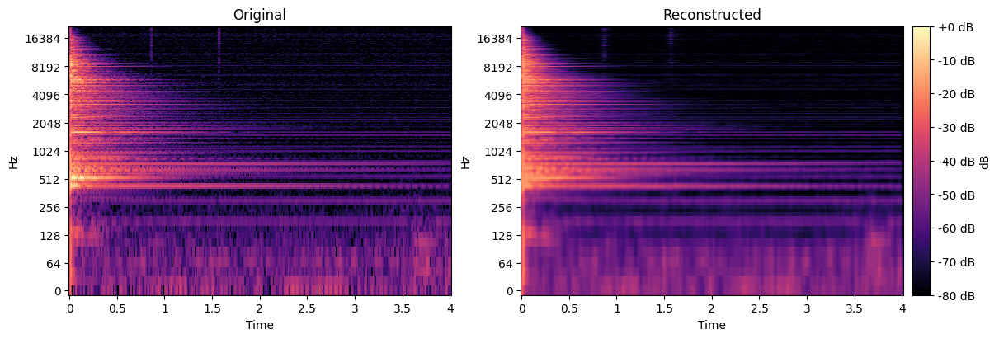

Strike 22 — reconstructed


Strike 22 — original


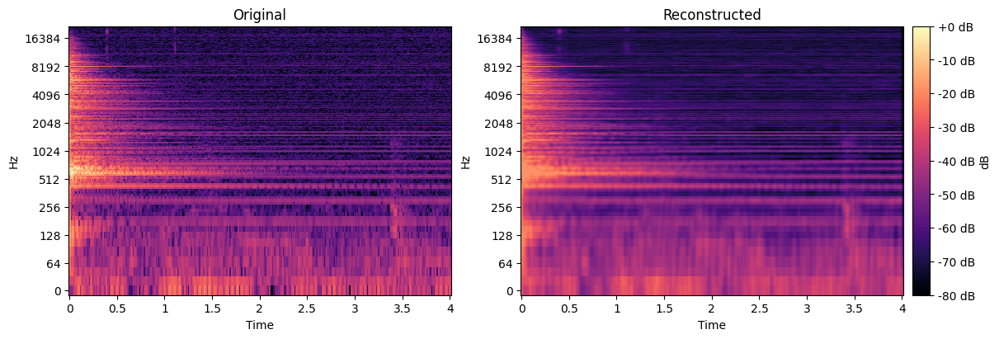

Strike 20 — reconstructed


Strike 20 — original


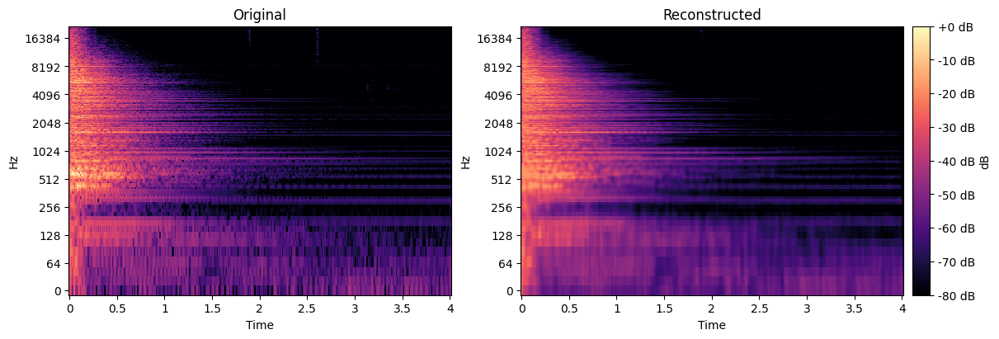

Strike 11 — reconstructed


Strike 11 — original


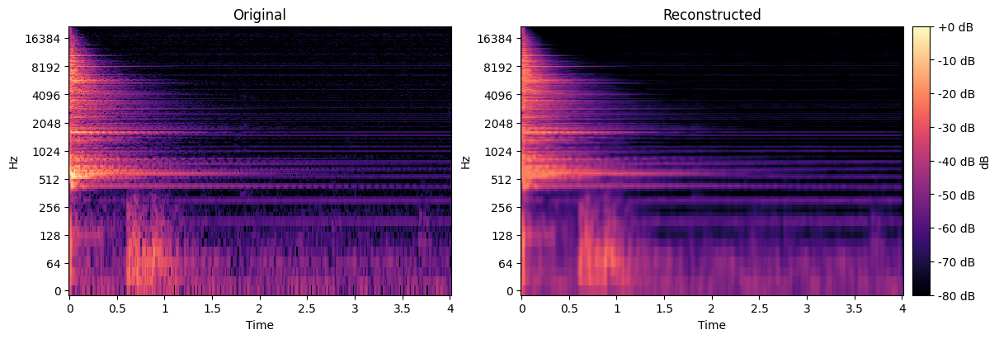

Strike 21 — reconstructed


Strike 21 — original


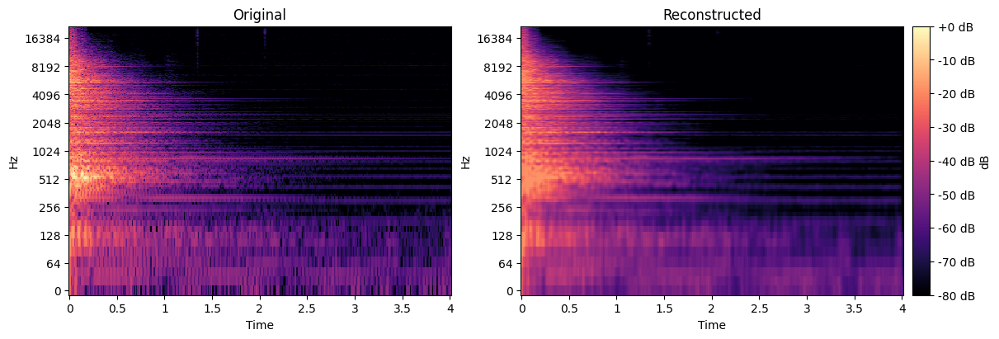

Strike 41 — reconstructed


Strike 41 — original


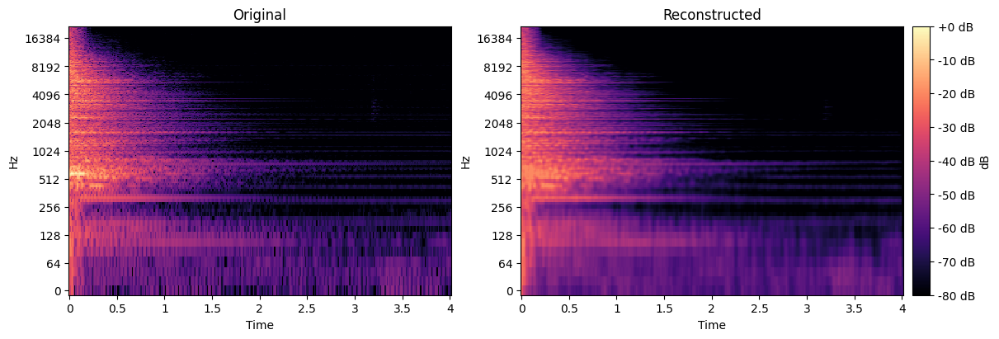

Strike 8 — reconstructed


Strike 8 — original


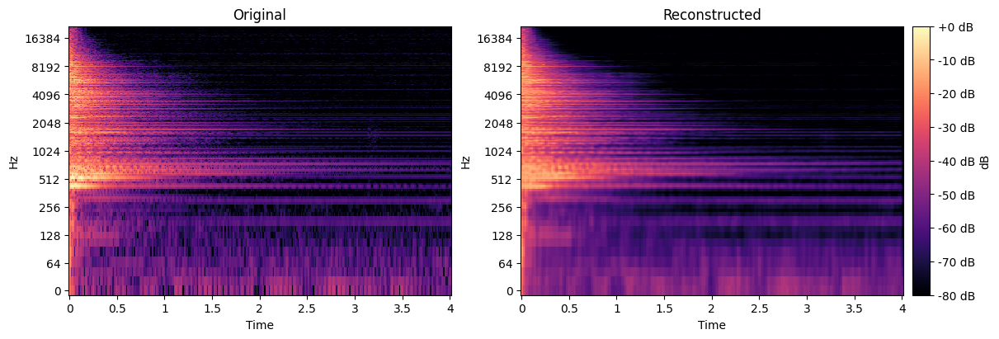

Strike 37 — reconstructed


Strike 37 — original


/tmp/ipython-input-1565029498.py:242: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.no_grad(), torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
/tmp/ipython-input-1565029498.py:255: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
/tmp/ipython-input-1565029498.py:260: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
/tmp/ipython-input-1565029498.py:278: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
/tmp/ipython-input-1565029498.py:283: FutureWarning: `torch.cuda.amp.autocast(args.

decode only on cuda | z shape (1, 192, 132, 44) | p50=0.570 ms  p90=0.581 ms  mean=0.571  min=0.555  max=0.649
forward (encode+decode) on cuda | x shape (1, 2, 1056, 352) | p50=1.066 ms  p90=1.081 ms  mean=1.074  min=1.045  max=1.622
decode (CPU) only on cpu | z shape (1, 192, 132, 44) | p50=108.814 ms  p90=110.081 ms  mean=108.835  min=106.660  max=113.518


In [ ]:
# --- Imports ---
import numpy as np, math, time
import torch
import librosa, librosa.display
import matplotlib.pyplot as plt
from tqdm import tqdm
from IPython.display import Audio, display

# ----------------------------
# 0) Use the in-memory model
# ----------------------------
assert 'final_model' in globals(), "final_model not found. Train it first or attach hparams to a loaded model."

device = "cuda" if torch.cuda.is_available() else "cpu"
model = final_model.to(device).eval()

# Pull hyperparams from the model (Option B). Fall back to introspection/defaults if missing.
hp = getattr(model, "hparams", {})
IN_CH           = hp.get("in_ch",       getattr(model.enc[0], "in_channels", 2))
LATENT_CH       = hp.get("latent_ch",   getattr(model.dec_body[0], "in_channels", 256))
REP             = hp.get("rep",         getattr(model, "rep", "logmag_phase"))
use_log_mag_phase = hp.get("use_log_mag_phase", REP == "logmag_phase")
percentile      = hp.get("percentile",  99.98)
target_multiple = hp.get("target_multiple", 32)

print("Using hparams from model:",
      dict(in_ch=IN_CH, latent_ch=LATENT_CH, rep=REP,
           percentile=percentile, target_multiple=target_multiple))

# ----------------------------
# 1) Paths & headers
# ----------------------------
STFT_NPZ = "ML_Data_complex/strikes_STFTs.npz"
WAVE_NPZ = "ML_Data_complex/strikes_waveforms.npz"  # optional

hdr = np.load(STFT_NPZ, allow_pickle=True)
orig_stfts = hdr["strikes_STFTs"]   # object array: each [T,F,2]
n_fft      = int(hdr["n_fft"])      if "n_fft" in hdr.files else 2048
hop_length = int(hdr["hop_length"]) if "hop_length" in hdr.files else 512
sr         = int(hdr["sample_rate"]) if "sample_rate" in hdr.files else 44100

# Optional waveforms
waves = None
try:
    wz = np.load(WAVE_NPZ, allow_pickle=True)
    for k in ("strikes","waveforms","audio","audio_recon"):
        if k in wz.files:
            waves = wz[k]
            break
    if "sample_rate" in wz.files:
        sr = int(wz["sample_rate"])
except Exception:
    waves = None

# ----------------------------
# 2) Precompute normalized inputs
# ----------------------------
def _pad_to_multiple(x, m):
    C,H,W = x.shape
    Hp = (m - H % m) % m
    Wp = (m - W % m) % m
    if Hp or Wp:
        x = np.pad(x, ((0,0),(0,Hp),(0,Wp)), mode="constant")
    return x

def _prep_item(i):
    S_TF2 = np.asarray(orig_stfts[i], dtype=np.float32)     # [T,F,2]
    T, F, _ = S_TF2.shape
    S_c = S_TF2[...,0] + 1j*S_TF2[...,1]                    # [T,F] complex

    if use_log_mag_phase:
        mag = np.log1p(np.abs(S_c)).T                       # [F,T] >=0
        pha = np.angle(S_c).T                               # [F,T] in [-pi, pi]
        mag_scale = float(np.percentile(mag, percentile)) or 1.0
        mag_n = np.clip(mag / mag_scale, 0.0, 1.0)
        pha_n = np.clip(pha / math.pi, -1.0, 1.0)
        x = np.stack([mag_n, pha_n], axis=0).astype(np.float32)   # [2,F,T]
        meta = {"rep":"logmag_phase", "orig_hw":(F,T), "mag_scale":mag_scale}
    else:
        X = np.transpose(S_TF2, (2,1,0)).astype(np.float32)       # [2,F,T]
        scale = float(np.percentile(np.abs(X), percentile)) or 1.0
        x = np.clip(X/scale, -1, 1)
        meta = {"rep":"re_im", "orig_hw":(F,T), "scale":scale}

    x = _pad_to_multiple(x, target_multiple)                      # [2,Fp,Tp]
    return torch.from_numpy(x), meta

x_list, meta_list = [], []
print("Precomputing normalized tensors...")
for i in tqdm(range(len(orig_stfts))):
    xi, mi = _prep_item(i)
    x_list.append(xi)      # torch.FloatTensor on CPU
    meta_list.append(mi)

_cache = {}
print("Ready. Use show_idx(i).")

# ----------------------------
# 3) Helpers
# ----------------------------
def _invert_rep_to_complex(y_CHW, meta):
    """
    y_CHW: [2,H,W] torch/numpy in normalized rep; meta has orig_hw and scales.
    returns S_FT (complex64) with shape [F,T].
    """
    if isinstance(y_CHW, torch.Tensor):
        y = y_CHW.detach().cpu().numpy()
    else:
        y = y_CHW
    F, T = meta["orig_hw"]
    y = y[:, :F, :T]  # crop padding

    if meta["rep"] == "logmag_phase":
        mag_scale = float(meta["mag_scale"])
        mag_n = np.clip(y[0], 0.0, 1.0)        # clamp in case the decoder used softplus
        pha_n = np.clip(y[1], -1.0, 1.0)
        mag = np.expm1(mag_n * mag_scale)
        pha = pha_n * math.pi
        S = mag * np.exp(1j * pha)             # [F,T]
    else:
        scale = float(meta["scale"])
        re = np.clip(y[0], -1, 1) * scale
        im = np.clip(y[1], -1, 1) * scale
        S = re + 1j * im
    return S.astype(np.complex64)

def _to_mag_TF(S_tf2):
    A = np.asarray(S_tf2, dtype=np.float32)
    S = A[...,0] + 1j*A[...,1]     # [T,F]
    return np.abs(S).T.astype(np.float32)  # [F,T]

def compare_stft_fig(S_orig_TF2, S_reco_TF2, sr, hop_length, top_db=80, log_freq=True):
    orig_mag = _to_mag_TF(S_orig_TF2)
    reco_mag = _to_mag_TF(S_reco_TF2)
    ref_val = float(np.max(orig_mag) + 1e-12)
    S_db_o = librosa.amplitude_to_db(orig_mag, ref=ref_val, top_db=top_db)
    S_db_r = librosa.amplitude_to_db(reco_mag, ref=ref_val, top_db=top_db)
    vmin, vmax = -top_db, 0
    y_axis = 'log' if log_freq else 'linear'

    fig = plt.figure(figsize=(12,4), layout='constrained')
    gs  = fig.add_gridspec(1, 3, width_ratios=[1,1,0.045])
    ax0 = fig.add_subplot(gs[0,0])
    ax1 = fig.add_subplot(gs[0,1], sharex=ax0, sharey=ax0)
    cax = fig.add_subplot(gs[0,2])

    im0 = librosa.display.specshow(S_db_o, sr=sr, hop_length=hop_length, x_axis='time', y_axis=y_axis,
                                   ax=ax0, vmin=vmin, vmax=vmax)
    ax0.set_title("Original")
    im1 = librosa.display.specshow(S_db_r, sr=sr, hop_length=hop_length, x_axis='time', y_axis=y_axis,
                                   ax=ax1, vmin=vmin, vmax=vmax)
    ax1.set_title("Reconstructed")
    cb = fig.colorbar(im1, cax=cax, format='%+2.0f dB'); cb.set_label("dB")
    plt.show()

def _forward_recon(x):
    """Handles AE or VAE forward. Returns y [B,2,H,W]."""
    with torch.no_grad():
        out = model(x)
    if isinstance(out, (tuple, list)):
        y = out[0]      # (recon, ...) for VAE variants
    else:
        y = out
    return y

def show_idx(i, play=True, cache=True, top_db=80, log_freq=True):
    """
    Fast viewer:
      - uses preloaded x_list/meta_list/orig_stfts/waves/model/device
      - caches recon STFT + audio for instant replays
    """
    assert 0 <= i < len(x_list)

    if cache and i in _cache:
        S_reco_TF2, y_recon = _cache[i]
    else:
        # 1) Forward pass on GPU/CPU
        x = x_list[i].unsqueeze(0).to(device)          # [1,2,H,W]
        y = _forward_recon(x)[0]                       # [2,H,W] on device

        # 2) Invert rep to complex STFT (numpy), crop to orig size
        meta = meta_list[i]
        S_recon_FT = _invert_rep_to_complex(y, meta)   # [F,T]
        S_reco_TF2 = np.stack([S_recon_FT.T.real, S_recon_FT.T.imag], axis=-1).astype(np.float32)

        # 3) ISTFT to waveform (CPU)
        y_recon = librosa.istft(S_recon_FT, hop_length=hop_length, win_length=n_fft).astype(np.float32)

        if cache:
            _cache[i] = (S_reco_TF2, y_recon)

    # Originals
    S_orig_TF2 = np.asarray(orig_stfts[i], dtype=np.float32)
    if waves is not None:
        y_orig = np.asarray(waves[i], dtype=np.float32)
    else:
        S_orig_FT = (S_orig_TF2[...,0] + 1j*S_orig_TF2[...,1]).T
        y_orig = librosa.istft(S_orig_FT, hop_length=hop_length, win_length=n_fft).astype(np.float32)

    # Plots
    compare_stft_fig(S_orig_TF2, S_reco_TF2, sr, hop_length, top_db=top_db, log_freq=log_freq)

    # Audio (optional)
    if play:
        print(f"Strike {i} — reconstructed")
        display(Audio(y_recon, rate=sr))
        print(f"Strike {i} — original")
        display(Audio(y_orig, rate=sr))

# ----------------------------
# 4) Build a fixed train/val split
# ----------------------------
VAL_SPLIT = 0.15
SEED = 123

n = len(orig_stfts)
n_val = max(1, int(round(n * VAL_SPLIT)))
n_tr  = n - n_val

gen = torch.Generator().manual_seed(SEED)
perm = torch.randperm(n, generator=gen)  # same randomness as random_split
train_indices = perm[:n_tr].tolist()
val_indices   = perm[n_tr:].tolist()

print(f"Train: {len(train_indices)}  Val: {len(val_indices)}")

# Show a few validation examples
for idx in val_indices[:]:
    show_idx(idx)

# ----------------------------
# 5) (Optional) Latent/throughput benchmarks
# ----------------------------
torch.backends.cudnn.benchmark = True
torch.backends.cuda.matmul.allow_tf32 = True
torch.backends.cudnn.allow_tf32 = True

def get_val_z(idx, use_amp=True):
    """Encode one item to latent z (handles AE/ VAE encode signatures)."""
    x = x_list[idx].unsqueeze(0).to(device)  # [1,2,H,W]
    use_cuda = (device == "cuda")
    with torch.no_grad(), torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
        enc = model.encode(x)
    if isinstance(enc, (tuple, list)):
        z = enc[0]   # (z, mu, logvar) or similar
    else:
        z = enc
    return z

def bench_decode(z, iters=200, warmup=50, use_amp=True, label="decode"):
    use_cuda = (device == "cuda")
    times = []
    with torch.no_grad():
        for _ in range(warmup):
            with torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
                _ = model.decode(z)
        if use_cuda: torch.cuda.synchronize()
        for _ in range(iters):
            t0 = time.perf_counter()
            with torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
                _ = model.decode(z)
            if use_cuda: torch.cuda.synchronize()
            times.append((time.perf_counter() - t0) * 1000.0)
    arr = np.array(times, dtype=np.float64)
    print(
        f"{label} only on {device} | z shape {tuple(z.shape)} | "
        f"p50={np.percentile(arr,50):.3f} ms  p90={np.percentile(arr,90):.3f} ms  "
        f"mean={arr.mean():.3f}  min={arr.min():.3f}  max={arr.max():.3f}"
    )
    return arr

def bench_forward(idx, iters=100, warmup=20, use_amp=True):
    x = x_list[idx].unsqueeze(0).to(device)
    use_cuda = (device == "cuda")
    times = []
    with torch.no_grad():
        for _ in range(warmup):
            with torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
                _ = model(x)
        if use_cuda: torch.cuda.synchronize()
        for _ in range(iters):
            t0 = time.perf_counter()
            with torch.cuda.amp.autocast(enabled=(use_cuda and use_amp)):
                _ = model(x)
            if use_cuda: torch.cuda.synchronize()
            times.append((time.perf_counter() - t0) * 1000.0)
    arr = np.array(times, dtype=np.float64)
    print(
        f"forward (encode+decode) on {device} | x shape {tuple(x.shape)} | "
        f"p50={np.percentile(arr,50):.3f} ms  p90={np.percentile(arr,90):.3f} ms  "
        f"mean={arr.mean():.3f}  min={arr.min():.3f}  max={arr.max():.3f}"
    )
    return arr

# Example throughput run
idx = val_indices[0]
z = get_val_z(idx, use_amp=True)
_ = bench_decode(z, iters=200, warmup=50, use_amp=True)
_ = bench_forward(idx, iters=100, warmup=20, use_amp=True)

# CPU benchmark (optional)
model_cpu = model.to("cpu").eval()
device = "cpu"
z_cpu = get_val_z(idx, use_amp=False)
_ = bench_decode(z_cpu, iters=100, warmup=20, use_amp=False, label="decode (CPU)")
